# Extracción de Key Frames usando Similarity Measure (Cosine Similarity)

Este notebook implementa el método descrito en el artículo:

**"Key-frame-Based Video Summarization Using Similarity Measure"**  
*Manjusha Yeola and Sunita Barve*

## Método Implementado (según el artículo):

1. **Extracción de Features con Deep Learning**: ResNet-50, GoogleNet, VGG16
2. **Selección de Keyframes usando Cosine Similarity**: No usa clustering, usa similitud directa
3. **Selección basada en Threshold**: Frames con similitud menor al umbral δ se seleccionan
4. **Primer frame siempre seleccionado**: El primer frame siempre es un keyframe

**Características del método del artículo:**
- **NO usa clustering** - usa cosine similarity directamente entre frames consecutivos
- Compara **ResNet-50, GoogleNet y VGG16** como extractores de features
- Selección basada en **threshold δ** (0.90 o 0.95)
- El **primer frame siempre se selecciona** como keyframe
- Métricas de evaluación: **Compression Ratio (CR)** y **F1-score**

**Algoritmo del artículo:**
1. Segmentar video en frames
2. Extraer features usando CNN pre-entrenada
3. Calcular cosine similarity entre frames consecutivos
4. Si similitud < threshold δ, seleccionar frame como keyframe
5. Generar video resumen con keyframes seleccionados

**Nota:** Este notebook asume que ya se han ejecutado los pasos 1, 2 y 3 del pipeline original:
- Paso 1: Filtrado de fondos uniformes
- Paso 2: Filtrado SSIM
- Paso 3: Extracción de features con ResNet50


In [27]:
# Configuración inicial
import sys
import os
from pathlib import Path
import pickle
import json
from datetime import datetime

# Configurar paths
project_root = Path("/Users/andrestrepo/Documents/repos_personal/proyecto-vision-computador")
sys.path.insert(0, str(project_root))
sys.path.insert(0, str(project_root / "src"))

# Imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

# Configuración
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")

print("✅ Configuración inicial completada")


✅ Configuración inicial completada


In [28]:
# Importar módulos del pipeline
from src.app.utils.frame_filter import FrameFilter
from src.app.utils.preprocessor import DataPreprocessor
from src.app.utils.feature_extractor import FeatureExtractor
from src.app.utils.keyframe_selector import KeyFrameSelector
from src.app.utils.categorizer import FrameCategorizer
from src.app.utils.evaluator import PipelineEvaluator
from src.app.utils.dataset_builder import DatasetBuilder

# Imports según el artículo (solo cosine similarity, NO clustering)
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize



## Paso 1: Cargar Datos Guardados

Cargamos los datos desde archivos guardados usando el mismo paso del notebook original:
- Dataset filtrado (después de SSIM)
- Features extraídos por video con ResNet50
- Metadatos de videos


In [29]:
# Configuración de paths
OUTPUT_DATASET_FILTRADO = "datasets/df_videos_frames_filtrados_v2.csv"
MODEL_NAME = 'resnet50'  # Debe coincidir con el modelo usado en el paso 3
FEATURES_DIR = f"features_{MODEL_NAME}"

# Inicializar preprocessor
preprocessor = DataPreprocessor(base_path=None)

# Cargar dataset filtrado
print("📂 Cargando dataset filtrado...")
df_preprocessed = preprocessor.load_dataset(
    csv_path=OUTPUT_DATASET_FILTRADO,
    frame_paths_col='frame_paths'
)

# Aplicar mapeo de canales si es necesario
channel_mapping = {
    'ARENA ALFA ': 'ARENA ALFA',
    'Bitcoin hoy ｜ Esteban Perez Trader': 'Bitcoin hoy',
    'Bolsas hoy ｜ Esteban Pérez Inversor': 'Bolsas hoy'
}

if 'channel' in df_preprocessed.columns:
    df_preprocessed['channel_name'] = df_preprocessed['channel'].replace(channel_mapping)

# Validar dataset
print("Validando rutas de frames...")
df_preprocessed = preprocessor.validate_dataset(
    df_preprocessed,
    frame_paths_col='frame_paths'
)

print(f"\n✅ Dataset cargado: {len(df_preprocessed)} videos")
print(f"   Total de frames: {df_preprocessed['n_frames_filtrado'].sum():,}")
print(f"   Canales únicos: {df_preprocessed['channel_name'].nunique()}")
print(f"   Canales: {', '.join(df_preprocessed['channel_name'].unique())}")


📂 Cargando dataset filtrado...
Cargando dataset desde datasets/df_videos_frames_filtrados_v2.csv...
Dataset cargado: 1133 videos
Validando rutas de frames...
Validando rutas de frames...
Videos con frames válidos: 1133

✅ Dataset cargado: 1133 videos
   Total de frames: 253,399
   Canales únicos: 3
   Canales: Bitcoin hoy, ARENA ALFA, Bolsas hoy


In [30]:
# Cargar features y datos de videos
import ast

# Inicializar extractor para cargar features
device = 'cuda' if __import__('torch').cuda.is_available() else 'cpu'
feature_extractor = FeatureExtractor(model_name=MODEL_NAME, device=device, batch_size=32)

print(f"📦 Cargando features desde {FEATURES_DIR}...")
print(f"   Usando dispositivo: {device}")
print(f"   Modelo: {MODEL_NAME.upper()}")

# Reconstruir datos desde archivos guardados
all_features = {}
all_frame_paths = {}
all_video_data = []

for idx, row in tqdm(df_preprocessed.iterrows(), total=len(df_preprocessed), desc="Cargando datos"):
    video_id = row['video_id']
    frame_paths = row['frame_paths']
    
    if not frame_paths or len(frame_paths) == 0:
        continue
    
    # Preparar datos del video
    video_data = preprocessor.prepare_video_data(row)
    all_video_data.append(video_data)
    
    # Cargar features si existen
    features_path = os.path.join(FEATURES_DIR, f"{video_id}_features.pkl")
    
    if os.path.exists(features_path):
        features, valid_paths, metadata = feature_extractor.load_features(features_path)
        all_features[video_id] = features
        all_frame_paths[video_id] = valid_paths
    else:
        print(f"⚠️  Advertencia: Features no encontrados para video {video_id}")

print(f"\n✅ Datos cargados:")
print(f"   Videos: {len(all_video_data)}")
print(f"   Features cargados: {len(all_features)}")
print(f"   Frames con paths: {sum(len(p) for p in all_frame_paths.values()):,}")


Cargando RESNET50 en cpu...
Modelo RESNET50 cargado exitosamente
Dimensión de features: 2048
📦 Cargando features desde features_resnet50...
   Usando dispositivo: cpu
   Modelo: RESNET50


Cargando datos: 100%|██████████| 1133/1133 [00:12<00:00, 93.19it/s]


✅ Datos cargados:
   Videos: 1133
   Features cargados: 1133
   Frames con paths: 253,399


## Paso 2: Seleccionar Videos para Análisis

Seleccionamos algunos videos para aplicar el método de cosine similarity del artículo.


In [31]:
# Seleccionar videos para análisis
# Seleccionamos todos los videos de cada canal
N_VIDEOS_TO_ANALYZE = 1133  # Número de videos a analizar

selected_videos = []

# Agrupar por canal
from collections import defaultdict
videos_by_channel = defaultdict(list)
for video_data in all_video_data:
    channel_name = video_data['channel_name']
    videos_by_channel[channel_name].append(video_data)

# Seleccionar todos los videos de cada canal
for channel_name, channel_videos in videos_by_channel.items():
    selected_videos.extend(channel_videos)

# Limitar al número deseado
selected_videos = selected_videos[:N_VIDEOS_TO_ANALYZE]

print(f"📹 Videos seleccionados para análisis: {len(selected_videos)}")
for video_data in selected_videos:
    video_id = video_data['video_id']
    channel_name = video_data['channel_name']
    n_frames = len(all_frame_paths.get(video_id, []))
    print(f"   - {video_id} ({channel_name}): {n_frames} frames")


📹 Videos seleccionados para análisis: 1133
   - tKBpmMwwJaE (Bitcoin hoy): 204 frames
   - OHqn_ak8cX0 (Bitcoin hoy): 183 frames
   - wVKhJhsQfT4 (Bitcoin hoy): 144 frames
   - -7ju1t4k4oE (Bitcoin hoy): 309 frames
   - IRAij7lx8xk (Bitcoin hoy): 229 frames
   - oYxnXhrTH1s (Bitcoin hoy): 229 frames
   - mbXR24nQzUQ (Bitcoin hoy): 303 frames
   - ps1_qy26wdE (Bitcoin hoy): 482 frames
   - Ag2OLnTLU8o (Bitcoin hoy): 196 frames
   - dxUzs9_SIso (Bitcoin hoy): 172 frames
   - A-Rp4XTkLFw (Bitcoin hoy): 217 frames
   - D7fi-KRcJJ8 (Bitcoin hoy): 191 frames
   - -mYF3CqAyTo (Bitcoin hoy): 106 frames
   - sUANzkm31FE (Bitcoin hoy): 105 frames
   - lmXBypDjGLY (Bitcoin hoy): 172 frames
   - odINE_CFB-M (Bitcoin hoy): 353 frames
   - fnyWuY5WHpY (Bitcoin hoy): 337 frames
   - uElD0mlzbtE (Bitcoin hoy): 33 frames
   - WGCoSc7qWdY (Bitcoin hoy): 335 frames
   - P_nMvpND0Q8 (Bitcoin hoy): 219 frames
   - rQxnC7GLTqs (Bitcoin hoy): 249 frames
   - j7ohYkqW7Ag (Bitcoin hoy): 213 frames
   - 9fUcoR-

## Paso 3: Implementación del Método del Artículo

Implementamos el método de selección de keyframes usando cosine similarity según el artículo.


In [32]:
# Configuración según el artículo
THRESHOLD_VALUES = [0.90, 0.95]  # Valores de threshold δ usados en el artículo
NORMALIZE_FEATURES = True  # Normalizar features para cosine similarity

print(f"⚙️  Configuración del método del artículo:")
print(f"   Thresholds δ: {THRESHOLD_VALUES}")
print(f"   Métrica: Cosine Similarity")
print(f"   Normalizar features: {NORMALIZE_FEATURES}")
print(f"   Primer frame: Siempre seleccionado")


⚙️  Configuración del método del artículo:
   Thresholds δ: [0.9, 0.95]
   Métrica: Cosine Similarity
   Normalizar features: True
   Primer frame: Siempre seleccionado


In [33]:
def extract_keyframes_cosine_similarity(features, frame_paths, threshold=0.95):
    """
    Extrae keyframes usando cosine similarity según el método del artículo.
    
    Algoritmo del artículo:
    1. El primer frame siempre se selecciona
    2. Calcular cosine similarity entre frames consecutivos
    3. Si similitud < threshold δ, seleccionar frame como keyframe
    
    Args:
        features: Array numpy con features (n_frames, n_features)
        frame_paths: Lista de rutas de frames
        threshold: Threshold δ para selección (0.90 o 0.95 según el artículo)
    
    Returns:
        Tuple con (keyframes, stats)
    """
    if len(features) == 0 or len(frame_paths) == 0:
        return [], {}
    
    # Normalizar features para cosine similarity
    features_norm = normalize(features, norm='l2') if NORMALIZE_FEATURES else features
    
    # El primer frame siempre se selecciona (según el artículo)
    keyframes = [frame_paths[0]]
    keyframe_indices = [0]
    
    # Calcular cosine similarity entre frames consecutivos
    for i in range(len(features_norm) - 1):
        # Calcular cosine similarity entre frame i e i+1
        similarity = cosine_similarity(
            features_norm[i:i+1], 
            features_norm[i+1:i+2]
        )[0, 0]
        
        # Si similitud < threshold, seleccionar frame i+1 como keyframe
        if similarity < threshold:
            keyframes.append(frame_paths[i+1])
            keyframe_indices.append(i+1)
    
    # Calcular Compression Ratio (CR) según el artículo
    n_frames = len(frame_paths)
    n_keyframes = len(keyframes)
    compression_ratio = (1 - (n_keyframes / n_frames)) * 100 if n_frames > 0 else 0
    
    # Estadísticas
    stats = {
        'n_frames': n_frames,
        'n_keyframes': n_keyframes,
        'compression_ratio': compression_ratio,
        'threshold': threshold,
        'method': f'Cosine Similarity (δ={threshold})'
    }
    
    return keyframes, stats


## Paso 4: Aplicar Método del Artículo a Videos Seleccionados

Aplicamos el método de cosine similarity del artículo con diferentes thresholds (δ=0.90 y δ=0.95).


In [34]:
# Aplicar método del artículo con diferentes thresholds
results = []

print("🚀 Aplicando método de cosine similarity del artículo a videos seleccionados...")
print("=" * 80)

for video_data in tqdm(selected_videos, desc="Procesando videos"):
    video_id = video_data['video_id']
    channel_name = video_data['channel_name']
    
    if video_id not in all_features:
        continue
    
    features = all_features[video_id]
    frame_paths = all_frame_paths[video_id]
    
    print(f"\n📹 Video: {video_id} ({channel_name})")
    print(f"   Frames: {len(frame_paths)}")
    
    video_results = {'video_id': video_id, 'channel_name': channel_name, 'n_frames': len(frame_paths)}
    
    # Aplicar método con diferentes thresholds según el artículo (δ=0.90 y δ=0.95)
    for threshold in THRESHOLD_VALUES:
        try:
            keyframes, stats = extract_keyframes_cosine_similarity(
                features, frame_paths, threshold=threshold
            )
            video_results[f'threshold_{threshold}'] = stats
            print(f"   ✅ Threshold δ={threshold}: {stats['n_keyframes']} keyframes (CR: {stats['compression_ratio']:.2f}%)")
        except Exception as e:
            print(f"   ❌ Threshold δ={threshold} error: {e}")
            video_results[f'threshold_{threshold}'] = None
    
    results.append(video_results)

print("\n" + "=" * 80)
print("✅ Análisis completado")


🚀 Aplicando método de cosine similarity del artículo a videos seleccionados...


Procesando videos:   0%|          | 2/1133 [00:00<01:18, 14.47it/s]


📹 Video: tKBpmMwwJaE (Bitcoin hoy)
   Frames: 204
   ✅ Threshold δ=0.9: 24 keyframes (CR: 88.24%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 81.86%)

📹 Video: OHqn_ak8cX0 (Bitcoin hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 22 keyframes (CR: 87.98%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 74.32%)

📹 Video: wVKhJhsQfT4 (Bitcoin hoy)
   Frames: 144
   ✅ Threshold δ=0.9: 31 keyframes (CR: 78.47%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 54.86%)

📹 Video: -7ju1t4k4oE (Bitcoin hoy)
   Frames: 309


Procesando videos:   0%|          | 4/1133 [00:00<01:21, 13.82it/s]

   ✅ Threshold δ=0.9: 43 keyframes (CR: 86.08%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 75.73%)

📹 Video: IRAij7lx8xk (Bitcoin hoy)
   Frames: 229
   ✅ Threshold δ=0.9: 43 keyframes (CR: 81.22%)
   ✅ Threshold δ=0.95: 108 keyframes (CR: 52.84%)

📹 Video: oYxnXhrTH1s (Bitcoin hoy)
   Frames: 229


Procesando videos:   1%|          | 6/1133 [00:00<01:18, 14.29it/s]

   ✅ Threshold δ=0.9: 10 keyframes (CR: 95.63%)
   ✅ Threshold δ=0.95: 35 keyframes (CR: 84.72%)

📹 Video: mbXR24nQzUQ (Bitcoin hoy)
   Frames: 303
   ✅ Threshold δ=0.9: 19 keyframes (CR: 93.73%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 82.84%)

📹 Video: ps1_qy26wdE (Bitcoin hoy)
   Frames: 482
   ✅ Threshold δ=0.9: 35 keyframes (CR: 92.74%)


Procesando videos:   1%|          | 8/1133 [00:00<02:11,  8.58it/s]

   ✅ Threshold δ=0.95: 89 keyframes (CR: 81.54%)

📹 Video: Ag2OLnTLU8o (Bitcoin hoy)
   Frames: 196


Procesando videos:   1%|          | 10/1133 [00:00<01:46, 10.53it/s]

   ✅ Threshold δ=0.9: 33 keyframes (CR: 83.16%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 58.67%)

📹 Video: dxUzs9_SIso (Bitcoin hoy)
   Frames: 172
   ✅ Threshold δ=0.9: 9 keyframes (CR: 94.77%)
   ✅ Threshold δ=0.95: 69 keyframes (CR: 59.88%)

📹 Video: A-Rp4XTkLFw (Bitcoin hoy)
   Frames: 217
   ✅ Threshold δ=0.9: 21 keyframes (CR: 90.32%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 72.35%)

📹 Video: D7fi-KRcJJ8 (Bitcoin hoy)
   Frames: 191
   ✅ Threshold δ=0.9: 4 keyframes (CR: 97.91%)


Procesando videos:   1%|          | 12/1133 [00:01<01:33, 11.96it/s]

   ✅ Threshold δ=0.95: 27 keyframes (CR: 85.86%)

📹 Video: -mYF3CqAyTo (Bitcoin hoy)
   Frames: 106


Procesando videos:   1%|▏         | 15/1133 [00:01<01:11, 15.73it/s]

   ✅ Threshold δ=0.9: 40 keyframes (CR: 62.26%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 38.68%)

📹 Video: sUANzkm31FE (Bitcoin hoy)
   Frames: 105
   ✅ Threshold δ=0.9: 16 keyframes (CR: 84.76%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 55.24%)

📹 Video: lmXBypDjGLY (Bitcoin hoy)
   Frames: 172
   ✅ Threshold δ=0.9: 19 keyframes (CR: 88.95%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 58.14%)

📹 Video: odINE_CFB-M (Bitcoin hoy)
   Frames: 353
   ✅ Threshold δ=0.9: 50 keyframes (CR: 85.84%)
   ✅ Threshold δ=0.95: 122 keyframes (CR: 65.44%)

📹 Video: fnyWuY5WHpY (Bitcoin hoy)
   Frames: 337


Procesando videos:   2%|▏         | 17/1133 [00:01<01:17, 14.46it/s]

   ✅ Threshold δ=0.9: 71 keyframes (CR: 78.93%)
   ✅ Threshold δ=0.95: 148 keyframes (CR: 56.08%)

📹 Video: uElD0mlzbtE (Bitcoin hoy)
   Frames: 33
   ✅ Threshold δ=0.9: 14 keyframes (CR: 57.58%)
   ✅ Threshold δ=0.95: 18 keyframes (CR: 45.45%)

📹 Video: WGCoSc7qWdY (Bitcoin hoy)
   Frames: 335
   ✅ Threshold δ=0.9: 54 keyframes (CR: 83.88%)
   ✅ Threshold δ=0.95: 169 keyframes (CR: 49.55%)

📹 Video: P_nMvpND0Q8 (Bitcoin hoy)
   Frames: 219


Procesando videos:   2%|▏         | 22/1133 [00:01<01:13, 15.06it/s]

   ✅ Threshold δ=0.9: 36 keyframes (CR: 83.56%)
   ✅ Threshold δ=0.95: 111 keyframes (CR: 49.32%)

📹 Video: rQxnC7GLTqs (Bitcoin hoy)
   Frames: 249
   ✅ Threshold δ=0.9: 32 keyframes (CR: 87.15%)
   ✅ Threshold δ=0.95: 111 keyframes (CR: 55.42%)

📹 Video: j7ohYkqW7Ag (Bitcoin hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 74 keyframes (CR: 65.26%)
   ✅ Threshold δ=0.95: 129 keyframes (CR: 39.44%)

📹 Video: 9fUcoR-6sHE (Bitcoin hoy)
   Frames: 536


Procesando videos:   2%|▏         | 24/1133 [00:01<01:21, 13.65it/s]

   ✅ Threshold δ=0.9: 69 keyframes (CR: 87.13%)
   ✅ Threshold δ=0.95: 168 keyframes (CR: 68.66%)

📹 Video: jJW1T4_l44A (Bitcoin hoy)
   Frames: 169
   ✅ Threshold δ=0.9: 44 keyframes (CR: 73.96%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 62.72%)

📹 Video: li4Zr1ezJ-o (Bitcoin hoy)
   Frames: 211
   ✅ Threshold δ=0.9: 10 keyframes (CR: 95.26%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 65.40%)

📹 Video: baZ9uoI8FJk (Bitcoin hoy)
   Frames: 516


Procesando videos:   2%|▏         | 26/1133 [00:02<01:30, 12.19it/s]

   ✅ Threshold δ=0.9: 34 keyframes (CR: 93.41%)
   ✅ Threshold δ=0.95: 104 keyframes (CR: 79.84%)

📹 Video: TIUtc80wt2U (Bitcoin hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 41 keyframes (CR: 77.60%)
   ✅ Threshold δ=0.95: 96 keyframes (CR: 47.54%)

📹 Video: A5MbK1qF_Dc (Bitcoin hoy)
   Frames: 354
   ✅ Threshold δ=0.9: 52 keyframes (CR: 85.31%)


Procesando videos:   3%|▎         | 30/1133 [00:02<01:28, 12.48it/s]

   ✅ Threshold δ=0.95: 140 keyframes (CR: 60.45%)

📹 Video: Wvqfha9SbRI (Bitcoin hoy)
   Frames: 351
   ✅ Threshold δ=0.9: 23 keyframes (CR: 93.45%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 72.36%)

📹 Video: iTClDo6j-jY (Bitcoin hoy)
   Frames: 227
   ✅ Threshold δ=0.9: 15 keyframes (CR: 93.39%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 83.26%)

📹 Video: 6_6WbrcRQu4 (Bitcoin hoy)
   Frames: 245
   ✅ Threshold δ=0.9: 96 keyframes (CR: 60.82%)


Procesando videos:   3%|▎         | 32/1133 [00:02<01:28, 12.45it/s]

   ✅ Threshold δ=0.95: 190 keyframes (CR: 22.45%)

📹 Video: L-_tMN7H1KY (Bitcoin hoy)
   Frames: 374
   ✅ Threshold δ=0.9: 106 keyframes (CR: 71.66%)
   ✅ Threshold δ=0.95: 206 keyframes (CR: 44.92%)

📹 Video: ZfA9UGfrZX0 (Bitcoin hoy)
   Frames: 382
   ✅ Threshold δ=0.9: 16 keyframes (CR: 95.81%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 76.18%)

📹 Video: syZjwjmvg7M (Bitcoin hoy)
   Frames: 148


Procesando videos:   3%|▎         | 34/1133 [00:02<01:24, 13.00it/s]

   ✅ Threshold δ=0.9: 62 keyframes (CR: 58.11%)
   ✅ Threshold δ=0.95: 112 keyframes (CR: 24.32%)

📹 Video: -uXfJZLPs_0 (Bitcoin hoy)
   Frames: 120
   ✅ Threshold δ=0.9: 17 keyframes (CR: 85.83%)
   ✅ Threshold δ=0.95: 55 keyframes (CR: 54.17%)

📹 Video: pNaHfT7m9r8 (Bitcoin hoy)
   Frames: 74
   ✅ Threshold δ=0.9: 23 keyframes (CR: 68.92%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 44.59%)

📹 Video: IXrmh39fYWk (Bitcoin hoy)
   Frames: 276
   ✅ Threshold δ=0.9: 7 keyframes (CR: 97.46%)


Procesando videos:   3%|▎         | 39/1133 [00:02<01:17, 14.18it/s]

   ✅ Threshold δ=0.95: 51 keyframes (CR: 81.52%)

📹 Video: 4EfYm8g-kxk (Bitcoin hoy)
   Frames: 178
   ✅ Threshold δ=0.9: 85 keyframes (CR: 52.25%)
   ✅ Threshold δ=0.95: 143 keyframes (CR: 19.66%)

📹 Video: I-ataBNJxSI (Bitcoin hoy)
   Frames: 361
   ✅ Threshold δ=0.9: 38 keyframes (CR: 89.47%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 74.79%)

📹 Video: 6VduE1Jly-M (Bitcoin hoy)
   Frames: 445
   ✅ Threshold δ=0.9: 163 keyframes (CR: 63.37%)


Procesando videos:   4%|▎         | 41/1133 [00:03<01:29, 12.17it/s]

   ✅ Threshold δ=0.95: 286 keyframes (CR: 35.73%)

📹 Video: LXakgCdI5EQ (Bitcoin hoy)
   Frames: 245
   ✅ Threshold δ=0.9: 45 keyframes (CR: 81.63%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 64.90%)

📹 Video: KKkR23-jFBs (Bitcoin hoy)
   Frames: 446
   ✅ Threshold δ=0.9: 50 keyframes (CR: 88.79%)


Procesando videos:   4%|▍         | 45/1133 [00:03<01:28, 12.36it/s]

   ✅ Threshold δ=0.95: 160 keyframes (CR: 64.13%)

📹 Video: teXvwJm_LIs (Bitcoin hoy)
   Frames: 292
   ✅ Threshold δ=0.9: 17 keyframes (CR: 94.18%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 71.92%)

📹 Video: 83Ocn9JnCmk (Bitcoin hoy)
   Frames: 405
   ✅ Threshold δ=0.9: 33 keyframes (CR: 91.85%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 79.75%)

📹 Video: 0kVe4wvDrNg (Bitcoin hoy)
   Frames: 90
   ✅ Threshold δ=0.9: 18 keyframes (CR: 80.00%)
   ✅ Threshold δ=0.95: 42 keyframes (CR: 53.33%)

📹 Video: 1VzxpzDgHXk (Bitcoin hoy)
   Frames: 185


Procesando videos:   4%|▍         | 47/1133 [00:03<01:20, 13.49it/s]

   ✅ Threshold δ=0.9: 27 keyframes (CR: 85.41%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 66.49%)

📹 Video: GVyfssLd71k (Bitcoin hoy)
   Frames: 247
   ✅ Threshold δ=0.9: 30 keyframes (CR: 87.85%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 70.85%)

📹 Video: EfzfZVtnT7M (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 44 keyframes (CR: 78.00%)
   ✅ Threshold δ=0.95: 93 keyframes (CR: 53.50%)

📹 Video: w6_2TQAS__4 (Bitcoin hoy)
   Frames: 151
   ✅ Threshold δ=0.9: 49 keyframes (CR: 67.55%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 37.09%)

📹 Video: i8QPNLvW3d4 (Bitcoin hoy)
   Frames: 609


Procesando videos:   4%|▍         | 50/1133 [00:03<01:22, 13.12it/s]

   ✅ Threshold δ=0.9: 45 keyframes (CR: 92.61%)
   ✅ Threshold δ=0.95: 177 keyframes (CR: 70.94%)

📹 Video: lXR7WsT6Ods (Bitcoin hoy)
   Frames: 580
   ✅ Threshold δ=0.9: 57 keyframes (CR: 90.17%)


Procesando videos:   5%|▍         | 52/1133 [00:04<01:44, 10.31it/s]

   ✅ Threshold δ=0.95: 163 keyframes (CR: 71.90%)

📹 Video: buqnNv5iz7Q (Bitcoin hoy)
   Frames: 104
   ✅ Threshold δ=0.9: 18 keyframes (CR: 82.69%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 49.04%)

📹 Video: i4ImH8ghQ7w (Bitcoin hoy)
   Frames: 196


Procesando videos:   5%|▍         | 54/1133 [00:04<01:42, 10.51it/s]

   ✅ Threshold δ=0.9: 44 keyframes (CR: 77.55%)
   ✅ Threshold δ=0.95: 80 keyframes (CR: 59.18%)

📹 Video: v61HIdVzhg8 (Bitcoin hoy)
   Frames: 230
   ✅ Threshold δ=0.9: 24 keyframes (CR: 89.57%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 75.22%)

📹 Video: qh052QrRg1A (Bitcoin hoy)
   Frames: 308
   ✅ Threshold δ=0.9: 62 keyframes (CR: 79.87%)
   ✅ Threshold δ=0.95: 109 keyframes (CR: 64.61%)

📹 Video: SdNN6F7h5yU (Bitcoin hoy)
   Frames: 133


Procesando videos:   5%|▌         | 58/1133 [00:04<01:28, 12.18it/s]

   ✅ Threshold δ=0.9: 10 keyframes (CR: 92.48%)
   ✅ Threshold δ=0.95: 28 keyframes (CR: 78.95%)

📹 Video: jsd5TU9SF0g (Bitcoin hoy)
   Frames: 226
   ✅ Threshold δ=0.9: 28 keyframes (CR: 87.61%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 69.03%)

📹 Video: JiQ3TAMtX2Y (Bitcoin hoy)
   Frames: 291
   ✅ Threshold δ=0.9: 25 keyframes (CR: 91.41%)
   ✅ Threshold δ=0.95: 92 keyframes (CR: 68.38%)

📹 Video: 4zz6Z5ARYks (Bitcoin hoy)
   Frames: 156
   ✅ Threshold δ=0.9: 29 keyframes (CR: 81.41%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 66.03%)

📹 Video: uKTDwmE68RA (Bitcoin hoy)
   Frames: 341


Procesando videos:   5%|▌         | 60/1133 [00:04<01:22, 13.06it/s]

   ✅ Threshold δ=0.9: 64 keyframes (CR: 81.23%)
   ✅ Threshold δ=0.95: 137 keyframes (CR: 59.82%)

📹 Video: 2DBtkMF-xWk (Bitcoin hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 59 keyframes (CR: 56.30%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 29.63%)

📹 Video: lxX-ZAzAnuI (Bitcoin hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 18 keyframes (CR: 90.16%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 74.32%)

📹 Video: eHfkpTVRSew (Bitcoin hoy)
   Frames: 396
   ✅ Threshold δ=0.9: 48 keyframes (CR: 87.88%)


Procesando videos:   6%|▌         | 66/1133 [00:05<01:02, 17.17it/s]

   ✅ Threshold δ=0.95: 114 keyframes (CR: 71.21%)

📹 Video: 7Vq7TZLPLvc (Bitcoin hoy)
   Frames: 124
   ✅ Threshold δ=0.9: 8 keyframes (CR: 93.55%)
   ✅ Threshold δ=0.95: 21 keyframes (CR: 83.06%)

📹 Video: 5X4MM1C4Hq8 (Bitcoin hoy)
   Frames: 209
   ✅ Threshold δ=0.9: 98 keyframes (CR: 53.11%)
   ✅ Threshold δ=0.95: 140 keyframes (CR: 33.01%)

📹 Video: fQEB0MQFvAI (Bitcoin hoy)
   Frames: 142
   ✅ Threshold δ=0.9: 19 keyframes (CR: 86.62%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 67.61%)

📹 Video: Hfhf9DNDYME (Bitcoin hoy)
   Frames: 222
   ✅ Threshold δ=0.9: 29 keyframes (CR: 86.94%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 68.47%)

📹 Video: dkTglHLK--8 (Bitcoin hoy)
   Frames: 225
   ✅ Threshold δ=0.9: 37 keyframes (CR: 83.56%)


Procesando videos:   6%|▌         | 70/1133 [00:05<01:04, 16.56it/s]

   ✅ Threshold δ=0.95: 80 keyframes (CR: 64.44%)

📹 Video: _vuP0r80ric (Bitcoin hoy)
   Frames: 284
   ✅ Threshold δ=0.9: 38 keyframes (CR: 86.62%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 71.48%)

📹 Video: whYN7B_VWuk (Bitcoin hoy)
   Frames: 307
   ✅ Threshold δ=0.9: 7 keyframes (CR: 97.72%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 85.99%)

📹 Video: 50dTf4bLvBg (Bitcoin hoy)
   Frames: 502


Procesando videos:   7%|▋         | 74/1133 [00:05<01:03, 16.67it/s]

   ✅ Threshold δ=0.9: 52 keyframes (CR: 89.64%)
   ✅ Threshold δ=0.95: 139 keyframes (CR: 72.31%)

📹 Video: JLC9YDI56B8 (Bitcoin hoy)
   Frames: 84
   ✅ Threshold δ=0.9: 8 keyframes (CR: 90.48%)
   ✅ Threshold δ=0.95: 35 keyframes (CR: 58.33%)

📹 Video: y7_ZvWEpJm8 (Bitcoin hoy)
   Frames: 158
   ✅ Threshold δ=0.9: 18 keyframes (CR: 88.61%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 72.78%)

📹 Video: V_VRNSkZfNI (Bitcoin hoy)
   Frames: 262
   ✅ Threshold δ=0.9: 62 keyframes (CR: 76.34%)
   ✅ Threshold δ=0.95: 129 keyframes (CR: 50.76%)

📹 Video: XOErv1aPElI (Bitcoin hoy)
   Frames: 375


Procesando videos:   7%|▋         | 78/1133 [00:05<01:03, 16.65it/s]

   ✅ Threshold δ=0.9: 54 keyframes (CR: 85.60%)
   ✅ Threshold δ=0.95: 137 keyframes (CR: 63.47%)

📹 Video: 3OY6AOWGdTg (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 33 keyframes (CR: 83.50%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 49.50%)

📹 Video: -8qbLqOyz7A (Bitcoin hoy)
   Frames: 145
   ✅ Threshold δ=0.9: 19 keyframes (CR: 86.90%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 63.45%)

📹 Video: IZsyJJxAX8Q (Bitcoin hoy)
   Frames: 243
   ✅ Threshold δ=0.9: 34 keyframes (CR: 86.01%)
   ✅ Threshold δ=0.95: 96 keyframes (CR: 60.49%)


Procesando videos:   7%|▋         | 80/1133 [00:05<01:06, 15.72it/s]


📹 Video: fJDQNdiPEdM (Bitcoin hoy)
   Frames: 376
   ✅ Threshold δ=0.9: 38 keyframes (CR: 89.89%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 75.80%)

📹 Video: 60qkR1ZICS4 (Bitcoin hoy)
   Frames: 139
   ✅ Threshold δ=0.9: 35 keyframes (CR: 74.82%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 59.71%)

📹 Video: kqhiip6-HkQ (Bitcoin hoy)
   Frames: 256
   ✅ Threshold δ=0.9: 40 keyframes (CR: 84.38%)


Procesando videos:   7%|▋         | 82/1133 [00:06<01:06, 15.69it/s]

   ✅ Threshold δ=0.95: 80 keyframes (CR: 68.75%)

📹 Video: Fko2CqTEOe4 (Bitcoin hoy)
   Frames: 248
   ✅ Threshold δ=0.9: 18 keyframes (CR: 92.74%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 74.60%)

📹 Video: -h1Rxc9HHUE (Bitcoin hoy)
   Frames: 477
   ✅ Threshold δ=0.9: 50 keyframes (CR: 89.52%)
   ✅ Threshold δ=0.95: 146 keyframes (CR: 69.39%)

📹 Video: 30hAHZ-to0M (Bitcoin hoy)
   Frames: 244


Procesando videos:   8%|▊         | 86/1133 [00:06<01:12, 14.38it/s]

   ✅ Threshold δ=0.9: 21 keyframes (CR: 91.39%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 70.49%)

📹 Video: E0BAZljnNYg (Bitcoin hoy)
   Frames: 333
   ✅ Threshold δ=0.9: 49 keyframes (CR: 85.29%)
   ✅ Threshold δ=0.95: 137 keyframes (CR: 58.86%)

📹 Video: s9t9TiM8Pzw (Bitcoin hoy)
   Frames: 146
   ✅ Threshold δ=0.9: 36 keyframes (CR: 75.34%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 47.95%)

📹 Video: EvlF9G0tr1Y (Bitcoin hoy)
   Frames: 227
   ✅ Threshold δ=0.9: 44 keyframes (CR: 80.62%)


Procesando videos:   8%|▊         | 89/1133 [00:06<01:06, 15.71it/s]

   ✅ Threshold δ=0.95: 77 keyframes (CR: 66.08%)

📹 Video: vDZgY14Zo5k (Bitcoin hoy)
   Frames: 158
   ✅ Threshold δ=0.9: 28 keyframes (CR: 82.28%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 63.92%)

📹 Video: bxj5Tl2TDew (Bitcoin hoy)
   Frames: 260
   ✅ Threshold δ=0.9: 55 keyframes (CR: 78.85%)
   ✅ Threshold δ=0.95: 127 keyframes (CR: 51.15%)

📹 Video: 7sFoTU4DfSo (Bitcoin hoy)
   Frames: 403
   ✅ Threshold δ=0.9: 49 keyframes (CR: 87.84%)


Procesando videos:   8%|▊         | 91/1133 [00:06<01:07, 15.38it/s]

   ✅ Threshold δ=0.95: 108 keyframes (CR: 73.20%)

📹 Video: 3vvJvvbwSCM (Bitcoin hoy)
   Frames: 141
   ✅ Threshold δ=0.9: 55 keyframes (CR: 60.99%)
   ✅ Threshold δ=0.95: 93 keyframes (CR: 34.04%)

📹 Video: 7IPfvIe6Ejk (Bitcoin hoy)
   Frames: 77
   ✅ Threshold δ=0.9: 36 keyframes (CR: 53.25%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 11.69%)

📹 Video: aNd5meDN--4 (Bitcoin hoy)
   Frames: 222
   ✅ Threshold δ=0.9: 49 keyframes (CR: 77.93%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 66.67%)

📹 Video: B2CG1UONngE (Bitcoin hoy)
   Frames: 404
   ✅ Threshold δ=0.9: 68 keyframes (CR: 83.17%)


Procesando videos:   8%|▊         | 96/1133 [00:06<01:04, 16.00it/s]

   ✅ Threshold δ=0.95: 146 keyframes (CR: 63.86%)

📹 Video: E73SY6HG0uo (Bitcoin hoy)
   Frames: 110
   ✅ Threshold δ=0.9: 10 keyframes (CR: 90.91%)
   ✅ Threshold δ=0.95: 23 keyframes (CR: 79.09%)

📹 Video: E38DBzX9j4A (Bitcoin hoy)
   Frames: 154
   ✅ Threshold δ=0.9: 25 keyframes (CR: 83.77%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 55.84%)

📹 Video: qccEyrj90po (Bitcoin hoy)
   Frames: 308
   ✅ Threshold δ=0.9: 75 keyframes (CR: 75.65%)
   ✅ Threshold δ=0.95: 153 keyframes (CR: 50.32%)

📹 Video: oQfaziZ53CU (Bitcoin hoy)
   Frames: 118


Procesando videos:   9%|▉         | 101/1133 [00:07<00:52, 19.70it/s]

   ✅ Threshold δ=0.9: 12 keyframes (CR: 89.83%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 72.03%)

📹 Video: KMTrI3_AKsk (Bitcoin hoy)
   Frames: 171
   ✅ Threshold δ=0.9: 58 keyframes (CR: 66.08%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 29.82%)

📹 Video: Kl6ux-_nYz8 (Bitcoin hoy)
   Frames: 123
   ✅ Threshold δ=0.9: 50 keyframes (CR: 59.35%)
   ✅ Threshold δ=0.95: 94 keyframes (CR: 23.58%)

📹 Video: HOxF-eVvFU4 (Bitcoin hoy)
   Frames: 143
   ✅ Threshold δ=0.9: 29 keyframes (CR: 79.72%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 46.85%)

📹 Video: _Uc1RSvAnkw (Bitcoin hoy)
   Frames: 471
   ✅ Threshold δ=0.9: 56 keyframes (CR: 88.11%)


Procesando videos:   9%|▉         | 106/1133 [00:07<00:57, 17.79it/s]

   ✅ Threshold δ=0.95: 145 keyframes (CR: 69.21%)

📹 Video: rPB5pHtbL5U (Bitcoin hoy)
   Frames: 158
   ✅ Threshold δ=0.9: 28 keyframes (CR: 82.28%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 68.99%)

📹 Video: WgAt0oaSt2I (Bitcoin hoy)
   Frames: 132
   ✅ Threshold δ=0.9: 15 keyframes (CR: 88.64%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 65.15%)

📹 Video: x6SV_ISzMtE (Bitcoin hoy)
   Frames: 244
   ✅ Threshold δ=0.9: 95 keyframes (CR: 61.07%)
   ✅ Threshold δ=0.95: 168 keyframes (CR: 31.15%)

📹 Video: X8dunXQIb0c (Bitcoin hoy)
   Frames: 275
   ✅ Threshold δ=0.9: 26 keyframes (CR: 90.55%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 73.45%)

📹 Video: UJWrdcJif2g (Bitcoin hoy)
   Frames: 212


Procesando videos:  10%|▉         | 108/1133 [00:07<01:02, 16.46it/s]

   ✅ Threshold δ=0.9: 70 keyframes (CR: 66.98%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 50.47%)

📹 Video: DBNZeVu2OxA (Bitcoin hoy)
   Frames: 416
   ✅ Threshold δ=0.9: 206 keyframes (CR: 50.48%)
   ✅ Threshold δ=0.95: 310 keyframes (CR: 25.48%)

📹 Video: eDZ2Gj7ORr4 (Bitcoin hoy)
   Frames: 368
   ✅ Threshold δ=0.9: 32 keyframes (CR: 91.30%)


Procesando videos:  10%|▉         | 110/1133 [00:07<01:08, 15.00it/s]

   ✅ Threshold δ=0.95: 93 keyframes (CR: 74.73%)

📹 Video: a5-0k5Qm914 (Bitcoin hoy)
   Frames: 307
   ✅ Threshold δ=0.9: 20 keyframes (CR: 93.49%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 87.30%)

📹 Video: 18MLoqkjG2g (Bitcoin hoy)
   Frames: 413
   ✅ Threshold δ=0.9: 223 keyframes (CR: 46.00%)
   ✅ Threshold δ=0.95: 348 keyframes (CR: 15.74%)

📹 Video: k7M_gErsR1M (Bitcoin hoy)
   Frames: 283


Procesando videos:  10%|█         | 114/1133 [00:08<01:14, 13.73it/s]

   ✅ Threshold δ=0.9: 30 keyframes (CR: 89.40%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 73.50%)

📹 Video: Wv1Ru51_7kA (Bitcoin hoy)
   Frames: 220
   ✅ Threshold δ=0.9: 29 keyframes (CR: 86.82%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 70.00%)

📹 Video: 671kEcJiRjI (Bitcoin hoy)
   Frames: 424
   ✅ Threshold δ=0.9: 46 keyframes (CR: 89.15%)
   ✅ Threshold δ=0.95: 134 keyframes (CR: 68.40%)

📹 Video: 5xjJ1GIrs_U (Bitcoin hoy)
   Frames: 278


Procesando videos:  10%|█         | 116/1133 [00:08<01:11, 14.26it/s]

   ✅ Threshold δ=0.9: 35 keyframes (CR: 87.41%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 76.26%)

📹 Video: z295Mu_G-5U (Bitcoin hoy)
   Frames: 244
   ✅ Threshold δ=0.9: 53 keyframes (CR: 78.28%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 68.44%)

📹 Video: MtH0gmKKqfU (Bitcoin hoy)
   Frames: 309
   ✅ Threshold δ=0.9: 108 keyframes (CR: 65.05%)
   ✅ Threshold δ=0.95: 177 keyframes (CR: 42.72%)

📹 Video: uS9aFBSVpL0 (Bitcoin hoy)
   Frames: 120
   ✅ Threshold δ=0.9: 20 keyframes (CR: 83.33%)


Procesando videos:  11%|█         | 120/1133 [00:08<01:09, 14.48it/s]

   ✅ Threshold δ=0.95: 60 keyframes (CR: 50.00%)

📹 Video: Gr_1VTolEQI (Bitcoin hoy)
   Frames: 112
   ✅ Threshold δ=0.9: 21 keyframes (CR: 81.25%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 49.11%)

📹 Video: h94AVw8Gbuk (Bitcoin hoy)
   Frames: 521
   ✅ Threshold δ=0.9: 62 keyframes (CR: 88.10%)
   ✅ Threshold δ=0.95: 167 keyframes (CR: 67.95%)

📹 Video: VQV_E9aU-bk (Bitcoin hoy)
   Frames: 154
   ✅ Threshold δ=0.9: 51 keyframes (CR: 66.88%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 44.16%)

📹 Video: -jGb8WR_Zg0 (Bitcoin hoy)
   Frames: 257


Procesando videos:  11%|█         | 122/1133 [00:08<01:04, 15.59it/s]

   ✅ Threshold δ=0.9: 37 keyframes (CR: 85.60%)
   ✅ Threshold δ=0.95: 87 keyframes (CR: 66.15%)

📹 Video: J5sb1YhJl64 (Bitcoin hoy)
   Frames: 320
   ✅ Threshold δ=0.9: 23 keyframes (CR: 92.81%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 75.31%)

📹 Video: 10GpXD6k8GA (Bitcoin hoy)
   Frames: 371
   ✅ Threshold δ=0.9: 132 keyframes (CR: 64.42%)


Procesando videos:  11%|█         | 126/1133 [00:08<01:09, 14.53it/s]

   ✅ Threshold δ=0.95: 244 keyframes (CR: 34.23%)

📹 Video: uu-0Ha2e970 (Bitcoin hoy)
   Frames: 310
   ✅ Threshold δ=0.9: 40 keyframes (CR: 87.10%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 76.13%)

📹 Video: vB9eAyIbJrQ (Bitcoin hoy)
   Frames: 145
   ✅ Threshold δ=0.9: 55 keyframes (CR: 62.07%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 38.62%)

📹 Video: 2KUgrLVCGC0 (Bitcoin hoy)
   Frames: 258
   ✅ Threshold δ=0.9: 35 keyframes (CR: 86.43%)
   ✅ Threshold δ=0.95: 83 keyframes (CR: 67.83%)

📹 Video: K9USyFjklts (Bitcoin hoy)
   Frames: 205


Procesando videos:  11%|█▏        | 130/1133 [00:09<01:03, 15.68it/s]

   ✅ Threshold δ=0.9: 49 keyframes (CR: 76.10%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 64.39%)

📹 Video: NgnXyAz5OeU (Bitcoin hoy)
   Frames: 187
   ✅ Threshold δ=0.9: 38 keyframes (CR: 79.68%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 58.82%)

📹 Video: 9ifSahC8H1A (Bitcoin hoy)
   Frames: 302
   ✅ Threshold δ=0.9: 59 keyframes (CR: 80.46%)
   ✅ Threshold δ=0.95: 155 keyframes (CR: 48.68%)

📹 Video: OTrlEKKQ04k (Bitcoin hoy)
   Frames: 120
   ✅ Threshold δ=0.9: 19 keyframes (CR: 84.17%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 66.67%)

📹 Video: D7sYvy7ll6U (Bitcoin hoy)
   Frames: 107
   ✅ Threshold δ=0.9: 16 keyframes (CR: 85.05%)


Procesando videos:  12%|█▏        | 135/1133 [00:09<00:55, 17.99it/s]

   ✅ Threshold δ=0.95: 26 keyframes (CR: 75.70%)

📹 Video: AnfwoC4T4g4 (Bitcoin hoy)
   Frames: 318
   ✅ Threshold δ=0.9: 9 keyframes (CR: 97.17%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 87.11%)

📹 Video: yywR3ZoDNSQ (Bitcoin hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 103 keyframes (CR: 53.39%)
   ✅ Threshold δ=0.95: 164 keyframes (CR: 25.79%)

📹 Video: 2SCK02B_Mak (Bitcoin hoy)
   Frames: 205
   ✅ Threshold δ=0.9: 35 keyframes (CR: 82.93%)
   ✅ Threshold δ=0.95: 51 keyframes (CR: 75.12%)

📹 Video: y6dmENUljjw (Bitcoin hoy)
   Frames: 309


Procesando videos:  12%|█▏        | 137/1133 [00:09<00:59, 16.87it/s]

   ✅ Threshold δ=0.9: 73 keyframes (CR: 76.38%)
   ✅ Threshold δ=0.95: 198 keyframes (CR: 35.92%)

📹 Video: rrwQcB4BZPY (Bitcoin hoy)
   Frames: 237
   ✅ Threshold δ=0.9: 23 keyframes (CR: 90.30%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 75.53%)

📹 Video: 4fgGWyDMnNw (Bitcoin hoy)
   Frames: 211
   ✅ Threshold δ=0.9: 16 keyframes (CR: 92.42%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 76.30%)

📹 Video: -6V1C-qaiYk (Bitcoin hoy)
   Frames: 256
   ✅ Threshold δ=0.9: 19 keyframes (CR: 92.58%)


Procesando videos:  12%|█▏        | 141/1133 [00:09<00:59, 16.66it/s]

   ✅ Threshold δ=0.95: 42 keyframes (CR: 83.59%)

📹 Video: mwzjMxfmJm4 (Bitcoin hoy)
   Frames: 234
   ✅ Threshold δ=0.9: 58 keyframes (CR: 75.21%)
   ✅ Threshold δ=0.95: 144 keyframes (CR: 38.46%)

📹 Video: gJXU6rlgTnw (Bitcoin hoy)
   Frames: 136
   ✅ Threshold δ=0.9: 17 keyframes (CR: 87.50%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 66.91%)

📹 Video: Kcb6khxukSU (Bitcoin hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 78 keyframes (CR: 63.38%)


Procesando videos:  13%|█▎        | 145/1133 [00:10<01:02, 15.74it/s]

   ✅ Threshold δ=0.95: 162 keyframes (CR: 23.94%)

📹 Video: H1HtaqQR4Sk (Bitcoin hoy)
   Frames: 167
   ✅ Threshold δ=0.9: 29 keyframes (CR: 82.63%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 58.08%)

📹 Video: HQUlzouJ-jA (Bitcoin hoy)
   Frames: 168
   ✅ Threshold δ=0.9: 31 keyframes (CR: 81.55%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 59.52%)

📹 Video: _evk_NYfiBI (Bitcoin hoy)
   Frames: 325
   ✅ Threshold δ=0.9: 81 keyframes (CR: 75.08%)
   ✅ Threshold δ=0.95: 145 keyframes (CR: 55.38%)

📹 Video: 38TDXfIAuxQ (Bitcoin hoy)
   Frames: 336


Procesando videos:  13%|█▎        | 147/1133 [00:10<01:12, 13.64it/s]

   ✅ Threshold δ=0.9: 98 keyframes (CR: 70.83%)
   ✅ Threshold δ=0.95: 190 keyframes (CR: 43.45%)

📹 Video: _U8iavJ1dIY (Bitcoin hoy)
   Frames: 421
   ✅ Threshold δ=0.9: 185 keyframes (CR: 56.06%)
   ✅ Threshold δ=0.95: 286 keyframes (CR: 32.07%)

📹 Video: qvt915jsCM0 (Bitcoin hoy)
   Frames: 238
   ✅ Threshold δ=0.9: 35 keyframes (CR: 85.29%)


Procesando videos:  13%|█▎        | 149/1133 [00:10<01:07, 14.64it/s]

   ✅ Threshold δ=0.95: 86 keyframes (CR: 63.87%)

📹 Video: d_hX1CTzxVk (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 38 keyframes (CR: 81.00%)
   ✅ Threshold δ=0.95: 54 keyframes (CR: 73.00%)

📹 Video: Vk0jwXfLfl8 (Bitcoin hoy)
   Frames: 188
   ✅ Threshold δ=0.9: 63 keyframes (CR: 66.49%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 47.87%)

📹 Video: ElrmwM4EcdU (Bitcoin hoy)
   Frames: 476
   ✅ Threshold δ=0.9: 64 keyframes (CR: 86.55%)


Procesando videos:  14%|█▎        | 154/1133 [00:10<01:02, 15.56it/s]

   ✅ Threshold δ=0.95: 141 keyframes (CR: 70.38%)

📹 Video: RcL0NUSNFmU (Bitcoin hoy)
   Frames: 297
   ✅ Threshold δ=0.9: 56 keyframes (CR: 81.14%)
   ✅ Threshold δ=0.95: 78 keyframes (CR: 73.74%)

📹 Video: iHMnnH9U0zQ (Bitcoin hoy)
   Frames: 96
   ✅ Threshold δ=0.9: 16 keyframes (CR: 83.33%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 55.21%)

📹 Video: ZFUIw0Acmbs (Bitcoin hoy)
   Frames: 236
   ✅ Threshold δ=0.9: 70 keyframes (CR: 70.34%)
   ✅ Threshold δ=0.95: 133 keyframes (CR: 43.64%)

📹 Video: AI-ocpmDjLw (Bitcoin hoy)
   Frames: 88
   ✅ Threshold δ=0.9: 14 keyframes (CR: 84.09%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 53.41%)

📹 Video: to3BMeASXPA (Bitcoin hoy)
   Frames: 113
   ✅ Threshold δ=0.9: 23 keyframes (CR: 79.65%)


Procesando videos:  14%|█▍        | 160/1133 [00:10<00:47, 20.42it/s]

   ✅ Threshold δ=0.95: 54 keyframes (CR: 52.21%)

📹 Video: LD-1QnJ3a9k (Bitcoin hoy)
   Frames: 193
   ✅ Threshold δ=0.9: 60 keyframes (CR: 68.91%)
   ✅ Threshold δ=0.95: 154 keyframes (CR: 20.21%)

📹 Video: NpZvg_p6Lxk (Bitcoin hoy)
   Frames: 102
   ✅ Threshold δ=0.9: 11 keyframes (CR: 89.22%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 67.65%)

📹 Video: nZlQfxDB_rw (Bitcoin hoy)
   Frames: 271
   ✅ Threshold δ=0.9: 42 keyframes (CR: 84.50%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 60.89%)

📹 Video: ue2s0j0L7yk (Bitcoin hoy)
   Frames: 89
   ✅ Threshold δ=0.9: 21 keyframes (CR: 76.40%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 37.08%)

📹 Video: 1PpnPp0ae9A (Bitcoin hoy)
   Frames: 222
   ✅ Threshold δ=0.9: 28 keyframes (CR: 87.39%)


Procesando videos:  14%|█▍        | 163/1133 [00:11<00:47, 20.60it/s]

   ✅ Threshold δ=0.95: 84 keyframes (CR: 62.16%)

📹 Video: u4MaGzelJmI (Bitcoin hoy)
   Frames: 124
   ✅ Threshold δ=0.9: 70 keyframes (CR: 43.55%)
   ✅ Threshold δ=0.95: 88 keyframes (CR: 29.03%)

📹 Video: 5-x3wsh9YZw (Bitcoin hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 37 keyframes (CR: 83.26%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 66.97%)

📹 Video: zz2_1jVlG2o (Bitcoin hoy)
   Frames: 158
   ✅ Threshold δ=0.9: 9 keyframes (CR: 94.30%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 76.58%)

📹 Video: zfYZIEPTEAE (Bitcoin hoy)
   Frames: 188
   ✅ Threshold δ=0.9: 34 keyframes (CR: 81.91%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 65.96%)

📹 Video: kg5Pt7Wmg9I (Bitcoin hoy)
   Frames: 380


Procesando videos:  15%|█▍        | 166/1133 [00:11<00:51, 18.74it/s]

   ✅ Threshold δ=0.9: 92 keyframes (CR: 75.79%)
   ✅ Threshold δ=0.95: 176 keyframes (CR: 53.68%)

📹 Video: o8E9s4MOedo (Bitcoin hoy)
   Frames: 119
   ✅ Threshold δ=0.9: 45 keyframes (CR: 62.18%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 33.61%)

📹 Video: dD8GCvBXD_c (Bitcoin hoy)
   Frames: 150
   ✅ Threshold δ=0.9: 26 keyframes (CR: 82.67%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 50.00%)

📹 Video: il0m5cD1Row (Bitcoin hoy)
   Frames: 86
   ✅ Threshold δ=0.9: 5 keyframes (CR: 94.19%)
   ✅ Threshold δ=0.95: 23 keyframes (CR: 73.26%)

📹 Video: gI2jK5lc594 (Bitcoin hoy)
   Frames: 378
   ✅ Threshold δ=0.9: 27 keyframes (CR: 92.86%)


Procesando videos:  15%|█▌        | 173/1133 [00:11<00:44, 21.70it/s]

   ✅ Threshold δ=0.95: 104 keyframes (CR: 72.49%)

📹 Video: poIDTX5df5U (Bitcoin hoy)
   Frames: 143
   ✅ Threshold δ=0.9: 27 keyframes (CR: 81.12%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 58.04%)

📹 Video: cGox2DpQab8 (Bitcoin hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 23 keyframes (CR: 85.80%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 60.49%)

📹 Video: h5z6eyDkkDs (Bitcoin hoy)
   Frames: 137
   ✅ Threshold δ=0.9: 20 keyframes (CR: 85.40%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 48.91%)

📹 Video: XWAjsWbo6Hs (Bitcoin hoy)
   Frames: 151
   ✅ Threshold δ=0.9: 44 keyframes (CR: 70.86%)
   ✅ Threshold δ=0.95: 87 keyframes (CR: 42.38%)

📹 Video: XBt2xcZh0Wg (Bitcoin hoy)
   Frames: 251
   ✅ Threshold δ=0.9: 34 keyframes (CR: 86.45%)


Procesando videos:  16%|█▌        | 176/1133 [00:11<00:43, 21.79it/s]

   ✅ Threshold δ=0.95: 66 keyframes (CR: 73.71%)

📹 Video: qwVIDMiq8RU (Bitcoin hoy)
   Frames: 93
   ✅ Threshold δ=0.9: 25 keyframes (CR: 73.12%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 30.11%)

📹 Video: UcOoPPvoqWc (Bitcoin hoy)
   Frames: 116
   ✅ Threshold δ=0.9: 32 keyframes (CR: 72.41%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 42.24%)

📹 Video: e_yBGt8TtkU (Bitcoin hoy)
   Frames: 155
   ✅ Threshold δ=0.9: 24 keyframes (CR: 84.52%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 60.65%)

📹 Video: OYzH-RbV14Y (Bitcoin hoy)
   Frames: 470
   ✅ Threshold δ=0.9: 69 keyframes (CR: 85.32%)


Procesando videos:  16%|█▌        | 179/1133 [00:11<00:47, 20.11it/s]

   ✅ Threshold δ=0.95: 158 keyframes (CR: 66.38%)

📹 Video: tUQbtePW068 (Bitcoin hoy)
   Frames: 438
   ✅ Threshold δ=0.9: 87 keyframes (CR: 80.14%)
   ✅ Threshold δ=0.95: 164 keyframes (CR: 62.56%)

📹 Video: jF8CO6wS3jI (Bitcoin hoy)
   Frames: 228
   ✅ Threshold δ=0.9: 27 keyframes (CR: 88.16%)
   ✅ Threshold δ=0.95: 87 keyframes (CR: 61.84%)

📹 Video: KvctX5gRsKw (Bitcoin hoy)
   Frames: 192
   ✅ Threshold δ=0.9: 15 keyframes (CR: 92.19%)


Procesando videos:  16%|█▋        | 186/1133 [00:12<00:45, 20.67it/s]

   ✅ Threshold δ=0.95: 67 keyframes (CR: 65.10%)

📹 Video: 5Ug0ptGnUHQ (Bitcoin hoy)
   Frames: 69
   ✅ Threshold δ=0.9: 8 keyframes (CR: 88.41%)
   ✅ Threshold δ=0.95: 32 keyframes (CR: 53.62%)

📹 Video: ySM8NQiMtkM (Bitcoin hoy)
   Frames: 102
   ✅ Threshold δ=0.9: 15 keyframes (CR: 85.29%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 37.25%)

📹 Video: fdRFvtb02XE (Bitcoin hoy)
   Frames: 99
   ✅ Threshold δ=0.9: 13 keyframes (CR: 86.87%)
   ✅ Threshold δ=0.95: 28 keyframes (CR: 71.72%)

📹 Video: MM-6Wa6lmlE (Bitcoin hoy)
   Frames: 276
   ✅ Threshold δ=0.9: 43 keyframes (CR: 84.42%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 65.58%)

📹 Video: lVU0RmGGlSE (Bitcoin hoy)
   Frames: 114
   ✅ Threshold δ=0.9: 17 keyframes (CR: 85.09%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 56.14%)

📹 Video: WUH1ucEwJ-4 (Bitcoin hoy)
   Frames: 445


Procesando videos:  17%|█▋        | 189/1133 [00:12<00:49, 19.17it/s]

   ✅ Threshold δ=0.9: 99 keyframes (CR: 77.75%)
   ✅ Threshold δ=0.95: 225 keyframes (CR: 49.44%)

📹 Video: KAILerT9zz0 (Bitcoin hoy)
   Frames: 188
   ✅ Threshold δ=0.9: 15 keyframes (CR: 92.02%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 67.55%)

📹 Video: UZpdCCjgU4w (Bitcoin hoy)
   Frames: 258
   ✅ Threshold δ=0.9: 27 keyframes (CR: 89.53%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 74.03%)

📹 Video: JCXHwjNJ3qE (Bitcoin hoy)
   Frames: 313


Procesando videos:  17%|█▋        | 194/1133 [00:12<00:48, 19.49it/s]

   ✅ Threshold δ=0.9: 106 keyframes (CR: 66.13%)
   ✅ Threshold δ=0.95: 191 keyframes (CR: 38.98%)

📹 Video: 4A-eTEL4-2k (Bitcoin hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 15 keyframes (CR: 93.21%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 65.61%)

📹 Video: tz0QCBgirT8 (Bitcoin hoy)
   Frames: 163
   ✅ Threshold δ=0.9: 25 keyframes (CR: 84.66%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 65.64%)

📹 Video: MOknnJnOLsI (Bitcoin hoy)
   Frames: 80
   ✅ Threshold δ=0.9: 6 keyframes (CR: 92.50%)
   ✅ Threshold δ=0.95: 14 keyframes (CR: 82.50%)

📹 Video: L-2vxEpTchs (Bitcoin hoy)
   Frames: 219
   ✅ Threshold δ=0.9: 80 keyframes (CR: 63.47%)


Procesando videos:  17%|█▋        | 197/1133 [00:12<00:47, 19.83it/s]

   ✅ Threshold δ=0.95: 118 keyframes (CR: 46.12%)

📹 Video: 3R68ymBiB58 (Bitcoin hoy)
   Frames: 140
   ✅ Threshold δ=0.9: 20 keyframes (CR: 85.71%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 71.43%)

📹 Video: SeGli44rCnA (Bitcoin hoy)
   Frames: 208
   ✅ Threshold δ=0.9: 33 keyframes (CR: 84.13%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 60.58%)

📹 Video: x0Pp-2a7UP4 (Bitcoin hoy)
   Frames: 159
   ✅ Threshold δ=0.9: 23 keyframes (CR: 85.53%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 74.84%)

📹 Video: aylqmoX61vk (Bitcoin hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 24 keyframes (CR: 88.73%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 79.81%)

📹 Video: NVr1zq0nHRM (Bitcoin hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 32 keyframes (CR: 85.52%)


Procesando videos:  18%|█▊        | 200/1133 [00:12<00:46, 20.08it/s]

   ✅ Threshold δ=0.95: 60 keyframes (CR: 72.85%)

📹 Video: OBhDkej5cxs (Bitcoin hoy)
   Frames: 435
   ✅ Threshold δ=0.9: 24 keyframes (CR: 94.48%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 82.99%)

📹 Video: 9w4LrGZBelw (Bitcoin hoy)
   Frames: 138
   ✅ Threshold δ=0.9: 18 keyframes (CR: 86.96%)
   ✅ Threshold δ=0.95: 20 keyframes (CR: 85.51%)

📹 Video: bt30z-RKG8I (Bitcoin hoy)
   Frames: 609


Procesando videos:  18%|█▊        | 203/1133 [00:13<01:00, 15.25it/s]

   ✅ Threshold δ=0.9: 65 keyframes (CR: 89.33%)
   ✅ Threshold δ=0.95: 172 keyframes (CR: 71.76%)

📹 Video: UDOn0lIvPlo (Bitcoin hoy)
   Frames: 299
   ✅ Threshold δ=0.9: 25 keyframes (CR: 91.64%)
   ✅ Threshold δ=0.95: 99 keyframes (CR: 66.89%)

📹 Video: bnG0Lif9UdE (Bitcoin hoy)
   Frames: 241
   ✅ Threshold δ=0.9: 29 keyframes (CR: 87.97%)


Procesando videos:  18%|█▊        | 207/1133 [00:13<00:58, 15.72it/s]

   ✅ Threshold δ=0.95: 62 keyframes (CR: 74.27%)

📹 Video: kjWz20RFRL0 (Bitcoin hoy)
   Frames: 206
   ✅ Threshold δ=0.9: 48 keyframes (CR: 76.70%)
   ✅ Threshold δ=0.95: 108 keyframes (CR: 47.57%)

📹 Video: ee1mXfmB4JQ (Bitcoin hoy)
   Frames: 285
   ✅ Threshold δ=0.9: 24 keyframes (CR: 91.58%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 72.28%)

📹 Video: vYBiV9EAJM0 (Bitcoin hoy)
   Frames: 506
   ✅ Threshold δ=0.9: 66 keyframes (CR: 86.96%)


Procesando videos:  18%|█▊        | 209/1133 [00:13<01:13, 12.58it/s]

   ✅ Threshold δ=0.95: 172 keyframes (CR: 66.01%)

📹 Video: h9i5vQ0sBzI (Bitcoin hoy)
   Frames: 524
   ✅ Threshold δ=0.9: 122 keyframes (CR: 76.72%)
   ✅ Threshold δ=0.95: 254 keyframes (CR: 51.53%)

📹 Video: r5vTNf-nWlo (Bitcoin hoy)
   Frames: 329
   ✅ Threshold δ=0.9: 47 keyframes (CR: 85.71%)


Procesando videos:  19%|█▉        | 214/1133 [00:13<00:55, 16.57it/s]

   ✅ Threshold δ=0.95: 119 keyframes (CR: 63.83%)

📹 Video: pvwiX8OHhhY (Bitcoin hoy)
   Frames: 111
   ✅ Threshold δ=0.9: 20 keyframes (CR: 81.98%)
   ✅ Threshold δ=0.95: 48 keyframes (CR: 56.76%)

📹 Video: h2fR-ZtUzzk (Bitcoin hoy)
   Frames: 158
   ✅ Threshold δ=0.9: 37 keyframes (CR: 76.58%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 51.90%)

📹 Video: eRDLKqY3b_k (Bitcoin hoy)
   Frames: 64
   ✅ Threshold δ=0.9: 9 keyframes (CR: 85.94%)
   ✅ Threshold δ=0.95: 25 keyframes (CR: 60.94%)

📹 Video: g5ZzPQ9UHkA (Bitcoin hoy)
   Frames: 236
   ✅ Threshold δ=0.9: 30 keyframes (CR: 87.29%)
   ✅ Threshold δ=0.95: 93 keyframes (CR: 60.59%)

📹 Video: c_Dq_R7YgHA (Bitcoin hoy)
   Frames: 207
   ✅ Threshold δ=0.9: 55 keyframes (CR: 73.43%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 48.79%)

📹 Video: RLJmtKB42OY (Bitcoin hoy)
   Frames: 326


Procesando videos:  19%|█▉        | 218/1133 [00:14<00:53, 17.03it/s]

   ✅ Threshold δ=0.9: 46 keyframes (CR: 85.89%)
   ✅ Threshold δ=0.95: 143 keyframes (CR: 56.13%)

📹 Video: OOOZvZrmf7s (Bitcoin hoy)
   Frames: 293
   ✅ Threshold δ=0.9: 32 keyframes (CR: 89.08%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 67.58%)

📹 Video: Vtgl_GVho8U (Bitcoin hoy)
   Frames: 133
   ✅ Threshold δ=0.9: 24 keyframes (CR: 81.95%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 66.92%)

📹 Video: OD13rahUaww (Bitcoin hoy)
   Frames: 565


Procesando videos:  19%|█▉        | 220/1133 [00:14<01:01, 14.74it/s]

   ✅ Threshold δ=0.9: 13 keyframes (CR: 97.70%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 85.49%)

📹 Video: in_q748V3k0 (Bitcoin hoy)
   Frames: 209
   ✅ Threshold δ=0.9: 40 keyframes (CR: 80.86%)
   ✅ Threshold δ=0.95: 84 keyframes (CR: 59.81%)

📹 Video: rACybtOf48w (Bitcoin hoy)
   Frames: 288
   ✅ Threshold δ=0.9: 53 keyframes (CR: 81.60%)
   ✅ Threshold δ=0.95: 92 keyframes (CR: 68.06%)

📹 Video: kBHIBh1ZBPw (Bitcoin hoy)
   Frames: 355


Procesando videos:  20%|█▉        | 225/1133 [00:14<00:54, 16.66it/s]

   ✅ Threshold δ=0.9: 24 keyframes (CR: 93.24%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 79.15%)

📹 Video: CxEbOpvWUkQ (Bitcoin hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 25 keyframes (CR: 84.57%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 64.81%)

📹 Video: zyJBe3mW2LI (Bitcoin hoy)
   Frames: 128
   ✅ Threshold δ=0.9: 28 keyframes (CR: 78.12%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 69.53%)

📹 Video: _qZ6LWlsYpc (Bitcoin hoy)
   Frames: 218
   ✅ Threshold δ=0.9: 72 keyframes (CR: 66.97%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 44.95%)

📹 Video: ccOrtjkhFbM (Bitcoin hoy)
   Frames: 299
   ✅ Threshold δ=0.9: 39 keyframes (CR: 86.96%)


Procesando videos:  20%|██        | 227/1133 [00:14<01:08, 13.23it/s]

   ✅ Threshold δ=0.95: 85 keyframes (CR: 71.57%)

📹 Video: 5vADy5k80zQ (Bitcoin hoy)
   Frames: 502
   ✅ Threshold δ=0.9: 63 keyframes (CR: 87.45%)
   ✅ Threshold δ=0.95: 168 keyframes (CR: 66.53%)

📹 Video: 27SQdsCM1BI (Bitcoin hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 18 keyframes (CR: 91.93%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 66.82%)

📹 Video: FzhNrKgMUDw (Bitcoin hoy)
   Frames: 348


Procesando videos:  20%|██        | 229/1133 [00:15<01:06, 13.62it/s]

   ✅ Threshold δ=0.9: 50 keyframes (CR: 85.63%)
   ✅ Threshold δ=0.95: 121 keyframes (CR: 65.23%)

📹 Video: 5Jic3-qSOHY (Bitcoin hoy)
   Frames: 510
   ✅ Threshold δ=0.9: 159 keyframes (CR: 68.82%)
   ✅ Threshold δ=0.95: 323 keyframes (CR: 36.67%)

📹 Video: TaOWXoBSPNc (Bitcoin hoy)
   Frames: 160
   ✅ Threshold δ=0.9: 13 keyframes (CR: 91.88%)


Procesando videos:  21%|██        | 234/1133 [00:15<00:56, 15.92it/s]

   ✅ Threshold δ=0.95: 41 keyframes (CR: 74.38%)

📹 Video: MFx2c91EfvY (Bitcoin hoy)
   Frames: 187
   ✅ Threshold δ=0.9: 13 keyframes (CR: 93.05%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 75.94%)

📹 Video: Z431bx6TB4c (Bitcoin hoy)
   Frames: 181
   ✅ Threshold δ=0.9: 22 keyframes (CR: 87.85%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 67.96%)

📹 Video: whD2EhsSYGM (Bitcoin hoy)
   Frames: 113
   ✅ Threshold δ=0.9: 33 keyframes (CR: 70.80%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 35.40%)

📹 Video: ufYJUC32Hug (Bitcoin hoy)
   Frames: 151
   ✅ Threshold δ=0.9: 35 keyframes (CR: 76.82%)
   ✅ Threshold δ=0.95: 84 keyframes (CR: 44.37%)

📹 Video: scO1mSIrRbM (Bitcoin hoy)
   Frames: 245
   ✅ Threshold δ=0.9: 38 keyframes (CR: 84.49%)


Procesando videos:  21%|██        | 237/1133 [00:15<00:48, 18.39it/s]

   ✅ Threshold δ=0.95: 77 keyframes (CR: 68.57%)

📹 Video: 7Xpw824MIYM (Bitcoin hoy)
   Frames: 91
   ✅ Threshold δ=0.9: 11 keyframes (CR: 87.91%)
   ✅ Threshold δ=0.95: 25 keyframes (CR: 72.53%)

📹 Video: 6i4Vcn7WmG8 (Bitcoin hoy)
   Frames: 187
   ✅ Threshold δ=0.9: 42 keyframes (CR: 77.54%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 51.87%)

📹 Video: qWUoK426bn4 (Bitcoin hoy)
   Frames: 206
   ✅ Threshold δ=0.9: 41 keyframes (CR: 80.10%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 64.08%)

📹 Video: Jx4qIzQ5bf0 (Bitcoin hoy)
   Frames: 375
   ✅ Threshold δ=0.9: 34 keyframes (CR: 90.93%)


Procesando videos:  21%|██▏       | 243/1133 [00:15<00:45, 19.64it/s]

   ✅ Threshold δ=0.95: 71 keyframes (CR: 81.07%)

📹 Video: GCM6E37rLHk (Bitcoin hoy)
   Frames: 177
   ✅ Threshold δ=0.9: 24 keyframes (CR: 86.44%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 64.97%)

📹 Video: flsl2IfE4qE (Bitcoin hoy)
   Frames: 145
   ✅ Threshold δ=0.9: 19 keyframes (CR: 86.90%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 71.72%)

📹 Video: zdl5k5y4caE (Bitcoin hoy)
   Frames: 185
   ✅ Threshold δ=0.9: 32 keyframes (CR: 82.70%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 67.57%)

📹 Video: o5a1J9IPKPg (Bitcoin hoy)
   Frames: 323
   ✅ Threshold δ=0.9: 42 keyframes (CR: 87.00%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 72.45%)

📹 Video: yEpGkQu8j2o (Bitcoin hoy)
   Frames: 96


Procesando videos:  22%|██▏       | 246/1133 [00:15<00:45, 19.44it/s]

   ✅ Threshold δ=0.9: 26 keyframes (CR: 72.92%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 54.17%)

📹 Video: mrRmz3mVeOU (Bitcoin hoy)
   Frames: 253
   ✅ Threshold δ=0.9: 28 keyframes (CR: 88.93%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 74.31%)

📹 Video: x2upGQ2Z5js (Bitcoin hoy)
   Frames: 246
   ✅ Threshold δ=0.9: 39 keyframes (CR: 84.15%)
   ✅ Threshold δ=0.95: 83 keyframes (CR: 66.26%)

📹 Video: ClPubdQreHE (Bitcoin hoy)
   Frames: 273
   ✅ Threshold δ=0.9: 53 keyframes (CR: 80.59%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 65.20%)

📹 Video: PniyKtLpMRU (Bitcoin hoy)
   Frames: 391


Procesando videos:  22%|██▏       | 251/1133 [00:16<00:52, 16.67it/s]

   ✅ Threshold δ=0.9: 27 keyframes (CR: 93.09%)
   ✅ Threshold δ=0.95: 126 keyframes (CR: 67.77%)

📹 Video: wuTJuKmvu1g (Bitcoin hoy)
   Frames: 324
   ✅ Threshold δ=0.9: 55 keyframes (CR: 83.02%)
   ✅ Threshold δ=0.95: 114 keyframes (CR: 64.81%)

📹 Video: SRDCQ9OLHic (Bitcoin hoy)
   Frames: 250
   ✅ Threshold δ=0.9: 28 keyframes (CR: 88.80%)
   ✅ Threshold δ=0.95: 51 keyframes (CR: 79.60%)

📹 Video: vgytD_P3JI4 (Bitcoin hoy)
   Frames: 204
   ✅ Threshold δ=0.9: 18 keyframes (CR: 91.18%)


Procesando videos:  22%|██▏       | 254/1133 [00:16<00:52, 16.66it/s]

   ✅ Threshold δ=0.95: 71 keyframes (CR: 65.20%)

📹 Video: aQA-n0M68Kk (Bitcoin hoy)
   Frames: 147
   ✅ Threshold δ=0.9: 30 keyframes (CR: 79.59%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 54.42%)

📹 Video: iWVkvsaMeig (Bitcoin hoy)
   Frames: 416
   ✅ Threshold δ=0.9: 86 keyframes (CR: 79.33%)
   ✅ Threshold δ=0.95: 189 keyframes (CR: 54.57%)

📹 Video: L8AboCkOMig (Bitcoin hoy)
   Frames: 175
   ✅ Threshold δ=0.9: 26 keyframes (CR: 85.14%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 64.00%)

📹 Video: OfLIfCsydGg (Bitcoin hoy)
   Frames: 458


Procesando videos:  23%|██▎       | 258/1133 [00:16<00:57, 15.11it/s]

   ✅ Threshold δ=0.9: 62 keyframes (CR: 86.46%)
   ✅ Threshold δ=0.95: 152 keyframes (CR: 66.81%)

📹 Video: JAACVgb_C14 (Bitcoin hoy)
   Frames: 398
   ✅ Threshold δ=0.9: 88 keyframes (CR: 77.89%)
   ✅ Threshold δ=0.95: 184 keyframes (CR: 53.77%)

📹 Video: YC1JEP3Iof8 (Bitcoin hoy)
   Frames: 195
   ✅ Threshold δ=0.9: 37 keyframes (CR: 81.03%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 57.95%)

📹 Video: f9eV3Vm4mzQ (Bitcoin hoy)
   Frames: 308


Procesando videos:  23%|██▎       | 263/1133 [00:16<00:48, 17.96it/s]

   ✅ Threshold δ=0.9: 13 keyframes (CR: 95.78%)
   ✅ Threshold δ=0.95: 51 keyframes (CR: 83.44%)

📹 Video: PgHeB8_35Tg (Bitcoin hoy)
   Frames: 157
   ✅ Threshold δ=0.9: 21 keyframes (CR: 86.62%)
   ✅ Threshold δ=0.95: 59 keyframes (CR: 62.42%)

📹 Video: aKdKuK8KAx4 (Bitcoin hoy)
   Frames: 195
   ✅ Threshold δ=0.9: 33 keyframes (CR: 83.08%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 55.90%)

📹 Video: sI2mp6xnvnY (Bitcoin hoy)
   Frames: 101
   ✅ Threshold δ=0.9: 18 keyframes (CR: 82.18%)
   ✅ Threshold δ=0.95: 35 keyframes (CR: 65.35%)

📹 Video: 6eKnBI9jE5k (Bitcoin hoy)
   Frames: 228
   ✅ Threshold δ=0.9: 40 keyframes (CR: 82.46%)
   ✅ Threshold δ=0.95: 93 keyframes (CR: 59.21%)

📹 Video: MDNxyEHX5PM (Bitcoin hoy)
   Frames: 182


Procesando videos:  24%|██▎       | 267/1133 [00:17<00:41, 20.65it/s]

   ✅ Threshold δ=0.9: 9 keyframes (CR: 95.05%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 77.47%)

📹 Video: IeTGexDPs9E (Bitcoin hoy)
   Frames: 84
   ✅ Threshold δ=0.9: 9 keyframes (CR: 89.29%)
   ✅ Threshold δ=0.95: 27 keyframes (CR: 67.86%)

📹 Video: eYo1WkNv04s (Bitcoin hoy)
   Frames: 106
   ✅ Threshold δ=0.9: 32 keyframes (CR: 69.81%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 31.13%)

📹 Video: 4rke2mLNnrw (Bitcoin hoy)
   Frames: 281
   ✅ Threshold δ=0.9: 56 keyframes (CR: 80.07%)
   ✅ Threshold δ=0.95: 107 keyframes (CR: 61.92%)

📹 Video: BVYn8BuXhgw (Bitcoin hoy)
   Frames: 192
   ✅ Threshold δ=0.9: 60 keyframes (CR: 68.75%)
   ✅ Threshold δ=0.95: 93 keyframes (CR: 51.56%)

📹 Video: mSX_Xa7tAfo (Bitcoin hoy)
   Frames: 266


Procesando videos:  24%|██▍       | 270/1133 [00:17<00:43, 19.90it/s]

   ✅ Threshold δ=0.9: 30 keyframes (CR: 88.72%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 67.67%)

📹 Video: y8DV5XfgXi0 (Bitcoin hoy)
   Frames: 40
   ✅ Threshold δ=0.9: 1 keyframes (CR: 97.50%)
   ✅ Threshold δ=0.95: 7 keyframes (CR: 82.50%)

📹 Video: 1h0K7lOuW9I (Bitcoin hoy)
   Frames: 512
   ✅ Threshold δ=0.9: 76 keyframes (CR: 85.16%)


Procesando videos:  24%|██▍       | 273/1133 [00:17<00:51, 16.55it/s]

   ✅ Threshold δ=0.95: 193 keyframes (CR: 62.30%)

📹 Video: jl2oj4cIMic (Bitcoin hoy)
   Frames: 201
   ✅ Threshold δ=0.9: 26 keyframes (CR: 87.06%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 67.16%)

📹 Video: 7783enqnjZE (Bitcoin hoy)
   Frames: 319
   ✅ Threshold δ=0.9: 21 keyframes (CR: 93.42%)
   ✅ Threshold δ=0.95: 69 keyframes (CR: 78.37%)

📹 Video: TKPnnKCzG2k (Bitcoin hoy)
   Frames: 328
   ✅ Threshold δ=0.9: 62 keyframes (CR: 81.10%)
   ✅ Threshold δ=0.95: 137 keyframes (CR: 58.23%)

📹 Video: dWt16UyPEUk (Bitcoin hoy)
   Frames: 386


Procesando videos:  25%|██▍       | 278/1133 [00:17<00:51, 16.48it/s]

   ✅ Threshold δ=0.9: 79 keyframes (CR: 79.53%)
   ✅ Threshold δ=0.95: 183 keyframes (CR: 52.59%)

📹 Video: lrnqM_GxqjU (Bitcoin hoy)
   Frames: 122
   ✅ Threshold δ=0.9: 19 keyframes (CR: 84.43%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 64.75%)

📹 Video: qWX_XGIIFCU (Bitcoin hoy)
   Frames: 127
   ✅ Threshold δ=0.9: 20 keyframes (CR: 84.25%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 52.76%)

📹 Video: MuIo__Vx1Bw (Bitcoin hoy)
   Frames: 375
   ✅ Threshold δ=0.9: 40 keyframes (CR: 89.33%)
   ✅ Threshold δ=0.95: 112 keyframes (CR: 70.13%)

📹 Video: PYudSDi2BY0 (Bitcoin hoy)
   Frames: 248


Procesando videos:  25%|██▍       | 280/1133 [00:17<00:51, 16.49it/s]

   ✅ Threshold δ=0.9: 53 keyframes (CR: 78.63%)
   ✅ Threshold δ=0.95: 118 keyframes (CR: 52.42%)

📹 Video: J7d62lYn14Y (Bitcoin hoy)
   Frames: 283
   ✅ Threshold δ=0.9: 39 keyframes (CR: 86.22%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 76.68%)

📹 Video: oBsEQndDS6o (Bitcoin hoy)
   Frames: 285
   ✅ Threshold δ=0.9: 41 keyframes (CR: 85.61%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 72.28%)

📹 Video: whPnEYGJ_dA (Bitcoin hoy)
   Frames: 92
   ✅ Threshold δ=0.9: 22 keyframes (CR: 76.09%)
   ✅ Threshold δ=0.95: 59 keyframes (CR: 35.87%)

📹 Video: JjTr2n-lGsc (Bitcoin hoy)
   Frames: 226


Procesando videos:  25%|██▌       | 285/1133 [00:18<00:51, 16.47it/s]

   ✅ Threshold δ=0.9: 17 keyframes (CR: 92.48%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 70.80%)

📹 Video: PIWzcYEzBA0 (Bitcoin hoy)
   Frames: 380
   ✅ Threshold δ=0.9: 24 keyframes (CR: 93.68%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 73.42%)

📹 Video: vgsByI-Lc_M (Bitcoin hoy)
   Frames: 273
   ✅ Threshold δ=0.9: 55 keyframes (CR: 79.85%)
   ✅ Threshold δ=0.95: 139 keyframes (CR: 49.08%)

📹 Video: fCGk9_zibpk (Bitcoin hoy)
   Frames: 195
   ✅ Threshold δ=0.9: 38 keyframes (CR: 80.51%)


Procesando videos:  25%|██▌       | 288/1133 [00:18<00:48, 17.31it/s]

   ✅ Threshold δ=0.95: 101 keyframes (CR: 48.21%)

📹 Video: P9piYWx1iFA (Bitcoin hoy)
   Frames: 178
   ✅ Threshold δ=0.9: 9 keyframes (CR: 94.94%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 81.46%)

📹 Video: RJDLZhDHhhA (Bitcoin hoy)
   Frames: 276
   ✅ Threshold δ=0.9: 28 keyframes (CR: 89.86%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 70.65%)

📹 Video: RHtDE5w6DjI (Bitcoin hoy)
   Frames: 287
   ✅ Threshold δ=0.9: 47 keyframes (CR: 83.62%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 68.64%)

📹 Video: 3ouad7g7A6k (Bitcoin hoy)
   Frames: 167
   ✅ Threshold δ=0.9: 42 keyframes (CR: 74.85%)


Procesando videos:  26%|██▌       | 293/1133 [00:18<00:45, 18.65it/s]

   ✅ Threshold δ=0.95: 98 keyframes (CR: 41.32%)

📹 Video: IwxG67QBmGE (Bitcoin hoy)
   Frames: 219
   ✅ Threshold δ=0.9: 31 keyframes (CR: 85.84%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 69.41%)

📹 Video: BAW7riKS1QE (Bitcoin hoy)
   Frames: 191
   ✅ Threshold δ=0.9: 7 keyframes (CR: 96.34%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 88.48%)

📹 Video: lIKRf6tujh0 (Bitcoin hoy)
   Frames: 194
   ✅ Threshold δ=0.9: 71 keyframes (CR: 63.40%)
   ✅ Threshold δ=0.95: 127 keyframes (CR: 34.54%)

📹 Video: Rc86mxB8oqI (Bitcoin hoy)
   Frames: 38
   ✅ Threshold δ=0.9: 13 keyframes (CR: 65.79%)
   ✅ Threshold δ=0.95: 16 keyframes (CR: 57.89%)

📹 Video: RfvcX30_C8I (Bitcoin hoy)
   Frames: 155
   ✅ Threshold δ=0.9: 24 keyframes (CR: 84.52%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 61.29%)

📹 Video: 9ux8EBTrWYA (Bitcoin hoy)
   Frames: 555


Procesando videos:  26%|██▌       | 296/1133 [00:18<00:46, 18.08it/s]

   ✅ Threshold δ=0.9: 36 keyframes (CR: 93.51%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 81.80%)

📹 Video: Y_Qk0bIBJcw (Bitcoin hoy)
   Frames: 163
   ✅ Threshold δ=0.9: 29 keyframes (CR: 82.21%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 73.01%)

📹 Video: MX7_T9M1djI (Bitcoin hoy)
   Frames: 254
   ✅ Threshold δ=0.9: 40 keyframes (CR: 84.25%)
   ✅ Threshold δ=0.95: 94 keyframes (CR: 62.99%)

📹 Video: UPea_aqsIj8 (Bitcoin hoy)
   Frames: 273
   ✅ Threshold δ=0.9: 37 keyframes (CR: 86.45%)


Procesando videos:  27%|██▋       | 302/1133 [00:19<00:43, 19.21it/s]

   ✅ Threshold δ=0.95: 90 keyframes (CR: 67.03%)

📹 Video: frL0S-p_dso (Bitcoin hoy)
   Frames: 196
   ✅ Threshold δ=0.9: 25 keyframes (CR: 87.24%)
   ✅ Threshold δ=0.95: 55 keyframes (CR: 71.94%)

📹 Video: d3JDUQurrxQ (Bitcoin hoy)
   Frames: 169
   ✅ Threshold δ=0.9: 10 keyframes (CR: 94.08%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 61.54%)

📹 Video: hPLiYoGNMLc (Bitcoin hoy)
   Frames: 217
   ✅ Threshold δ=0.9: 33 keyframes (CR: 84.79%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 64.98%)

📹 Video: JGXqijMro2k (Bitcoin hoy)
   Frames: 377
   ✅ Threshold δ=0.9: 46 keyframes (CR: 87.80%)


Procesando videos:  27%|██▋       | 306/1133 [00:19<00:47, 17.38it/s]

   ✅ Threshold δ=0.95: 113 keyframes (CR: 70.03%)

📹 Video: 6_6Eb6_dM0o (Bitcoin hoy)
   Frames: 272
   ✅ Threshold δ=0.9: 24 keyframes (CR: 91.18%)
   ✅ Threshold δ=0.95: 94 keyframes (CR: 65.44%)

📹 Video: iGMVSYdhm8Y (Bitcoin hoy)
   Frames: 256
   ✅ Threshold δ=0.9: 28 keyframes (CR: 89.06%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 72.66%)

📹 Video: AoPeIbZJumg (Bitcoin hoy)
   Frames: 217
   ✅ Threshold δ=0.9: 32 keyframes (CR: 85.25%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 58.53%)

📹 Video: GpogRkBlwKc (Bitcoin hoy)
   Frames: 127
   ✅ Threshold δ=0.9: 25 keyframes (CR: 80.31%)


Procesando videos:  27%|██▋       | 309/1133 [00:19<00:43, 18.74it/s]

   ✅ Threshold δ=0.95: 69 keyframes (CR: 45.67%)

📹 Video: 1HZanikugzM (Bitcoin hoy)
   Frames: 166
   ✅ Threshold δ=0.9: 38 keyframes (CR: 77.11%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 63.25%)

📹 Video: uPTFWq-eqBY (Bitcoin hoy)
   Frames: 298
   ✅ Threshold δ=0.9: 53 keyframes (CR: 82.21%)
   ✅ Threshold δ=0.95: 118 keyframes (CR: 60.40%)

📹 Video: zn61guGTjis (Bitcoin hoy)
   Frames: 353
   ✅ Threshold δ=0.9: 137 keyframes (CR: 61.19%)
   ✅ Threshold δ=0.95: 232 keyframes (CR: 34.28%)

📹 Video: IgWMlWEgdXQ (Bitcoin hoy)
   Frames: 293


Procesando videos:  27%|██▋       | 311/1133 [00:19<00:49, 16.67it/s]

   ✅ Threshold δ=0.9: 50 keyframes (CR: 82.94%)
   ✅ Threshold δ=0.95: 159 keyframes (CR: 45.73%)

📹 Video: hIJF51c2-fo (Bitcoin hoy)
   Frames: 269
   ✅ Threshold δ=0.9: 41 keyframes (CR: 84.76%)
   ✅ Threshold δ=0.95: 104 keyframes (CR: 61.34%)

📹 Video: andp_GE6a4Q (Bitcoin hoy)
   Frames: 143
   ✅ Threshold δ=0.9: 33 keyframes (CR: 76.92%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 52.45%)

📹 Video: jTnNSOhj73o (Bitcoin hoy)
   Frames: 424
   ✅ Threshold δ=0.9: 39 keyframes (CR: 90.80%)


Procesando videos:  28%|██▊       | 317/1133 [00:20<00:44, 18.43it/s]

   ✅ Threshold δ=0.95: 98 keyframes (CR: 76.89%)

📹 Video: t1OITXzW-ac (Bitcoin hoy)
   Frames: 150
   ✅ Threshold δ=0.9: 25 keyframes (CR: 83.33%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 40.67%)

📹 Video: eK-KF4d2lqc (Bitcoin hoy)
   Frames: 187
   ✅ Threshold δ=0.9: 23 keyframes (CR: 87.70%)
   ✅ Threshold δ=0.95: 92 keyframes (CR: 50.80%)

📹 Video: o6ACRjtumSw (Bitcoin hoy)
   Frames: 160
   ✅ Threshold δ=0.9: 25 keyframes (CR: 84.38%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 56.25%)

📹 Video: 1rp0-E5UIGA (Bitcoin hoy)
   Frames: 324
   ✅ Threshold δ=0.9: 63 keyframes (CR: 80.56%)
   ✅ Threshold δ=0.95: 115 keyframes (CR: 64.51%)

📹 Video: aKxCvskAki0 (Bitcoin hoy)
   Frames: 142


Procesando videos:  28%|██▊       | 321/1133 [00:20<00:46, 17.34it/s]

   ✅ Threshold δ=0.9: 29 keyframes (CR: 79.58%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 54.93%)

📹 Video: RltqrRTUDxA (Bitcoin hoy)
   Frames: 197
   ✅ Threshold δ=0.9: 76 keyframes (CR: 61.42%)
   ✅ Threshold δ=0.95: 148 keyframes (CR: 24.87%)

📹 Video: e_ompepXDZI (Bitcoin hoy)
   Frames: 389
   ✅ Threshold δ=0.9: 41 keyframes (CR: 89.46%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 73.01%)

📹 Video: xWQ-0WuKvh8 (Bitcoin hoy)
   Frames: 217
   ✅ Threshold δ=0.9: 41 keyframes (CR: 81.11%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 60.37%)

📹 Video: sWTQfiVo_Uk (Bitcoin hoy)
   Frames: 216


Procesando videos:  29%|██▉       | 326/1133 [00:20<00:40, 19.71it/s]

   ✅ Threshold δ=0.9: 28 keyframes (CR: 87.04%)
   ✅ Threshold δ=0.95: 48 keyframes (CR: 77.78%)

📹 Video: Mtr6gYTly_w (Bitcoin hoy)
   Frames: 90
   ✅ Threshold δ=0.9: 6 keyframes (CR: 93.33%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 63.33%)

📹 Video: sOcWbE-t_dA (Bitcoin hoy)
   Frames: 134
   ✅ Threshold δ=0.9: 10 keyframes (CR: 92.54%)
   ✅ Threshold δ=0.95: 26 keyframes (CR: 80.60%)

📹 Video: CbJO9Yz-Y6U (Bitcoin hoy)
   Frames: 304
   ✅ Threshold δ=0.9: 32 keyframes (CR: 89.47%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 67.76%)

📹 Video: DkprFwP9DWI (Bitcoin hoy)
   Frames: 202
   ✅ Threshold δ=0.9: 18 keyframes (CR: 91.09%)
   ✅ Threshold δ=0.95: 54 keyframes (CR: 73.27%)

📹 Video: 4ts0pvf8l0w (Bitcoin hoy)
   Frames: 279


Procesando videos:  29%|██▉       | 332/1133 [00:20<00:37, 21.15it/s]

   ✅ Threshold δ=0.9: 84 keyframes (CR: 69.89%)
   ✅ Threshold δ=0.95: 158 keyframes (CR: 43.37%)

📹 Video: LU-qzQEFt_k (Bitcoin hoy)
   Frames: 173
   ✅ Threshold δ=0.9: 23 keyframes (CR: 86.71%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 74.57%)

📹 Video: UVpbG1dlmSw (Bitcoin hoy)
   Frames: 150
   ✅ Threshold δ=0.9: 15 keyframes (CR: 90.00%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 66.67%)

📹 Video: JfCzYoDl9z0 (Bitcoin hoy)
   Frames: 231
   ✅ Threshold δ=0.9: 18 keyframes (CR: 92.21%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 61.04%)

📹 Video: 23un3iuHe98 (Bitcoin hoy)
   Frames: 121
   ✅ Threshold δ=0.9: 23 keyframes (CR: 80.99%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 48.76%)

📹 Video: FjHVpwd5Xqo (Bitcoin hoy)
   Frames: 225


Procesando videos:  30%|██▉       | 335/1133 [00:20<00:43, 18.38it/s]

   ✅ Threshold δ=0.9: 12 keyframes (CR: 94.67%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 82.22%)

📹 Video: 1Q6DlfNzNls (Bitcoin hoy)
   Frames: 269
   ✅ Threshold δ=0.9: 31 keyframes (CR: 88.48%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 69.52%)

📹 Video: taI9HTCKsfs (Bitcoin hoy)
   Frames: 389
   ✅ Threshold δ=0.9: 67 keyframes (CR: 82.78%)
   ✅ Threshold δ=0.95: 150 keyframes (CR: 61.44%)

📹 Video: o7E_dCEDVRE (Bitcoin hoy)
   Frames: 92
   ✅ Threshold δ=0.9: 24 keyframes (CR: 73.91%)


Procesando videos:  30%|██▉       | 339/1133 [00:21<00:40, 19.61it/s]

   ✅ Threshold δ=0.95: 53 keyframes (CR: 42.39%)

📹 Video: nBLfoP-7Y84 (Bitcoin hoy)
   Frames: 44
   ✅ Threshold δ=0.9: 10 keyframes (CR: 77.27%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 50.00%)

📹 Video: pVqx7d1q6eI (Bitcoin hoy)
   Frames: 260
   ✅ Threshold δ=0.9: 23 keyframes (CR: 91.15%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 65.38%)

📹 Video: PO7ou_o2Umo (Bitcoin hoy)
   Frames: 373
   ✅ Threshold δ=0.9: 90 keyframes (CR: 75.87%)
   ✅ Threshold δ=0.95: 186 keyframes (CR: 50.13%)

📹 Video: zAAyrb9yvWQ (Bitcoin hoy)
   Frames: 552
   ✅ Threshold δ=0.9: 70 keyframes (CR: 87.32%)
   ✅ Threshold δ=0.95: 182 keyframes (CR: 67.03%)

📹 Video: F9KNxAgXZog (Bitcoin hoy)
   Frames: 333
   ✅ Threshold δ=0.9: 41 keyframes (CR: 87.69%)
   ✅ Threshold δ=0.95: 122 keyframes (CR: 63.36%)

📹 Video: BCTRXgRo85k (Bitcoin hoy)
   Frames: 320
   ✅ Threshold δ=0.9: 33 keyframes (CR: 89.69%)


Procesando videos:  30%|███       | 344/1133 [00:21<00:50, 15.63it/s]

   ✅ Threshold δ=0.95: 83 keyframes (CR: 74.06%)

📹 Video: 5Y6eJAbpCYI (Bitcoin hoy)
   Frames: 255
   ✅ Threshold δ=0.9: 39 keyframes (CR: 84.71%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 66.27%)

📹 Video: zLd2L5MBha0 (Bitcoin hoy)
   Frames: 326
   ✅ Threshold δ=0.9: 12 keyframes (CR: 96.32%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 80.98%)

📹 Video: DDMtZ8HQ3l8 (Bitcoin hoy)
   Frames: 385
   ✅ Threshold δ=0.9: 69 keyframes (CR: 82.08%)


Procesando videos:  31%|███       | 346/1133 [00:21<00:58, 13.37it/s]

   ✅ Threshold δ=0.95: 171 keyframes (CR: 55.58%)

📹 Video: 1x-Sf8HsuZI (Bitcoin hoy)
   Frames: 326
   ✅ Threshold δ=0.9: 37 keyframes (CR: 88.65%)
   ✅ Threshold δ=0.95: 143 keyframes (CR: 56.13%)

📹 Video: xsI9W6w31Kc (Bitcoin hoy)
   Frames: 247
   ✅ Threshold δ=0.9: 15 keyframes (CR: 93.93%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 82.59%)

📹 Video: bVtIZJLs7OI (Bitcoin hoy)
   Frames: 159
   ✅ Threshold δ=0.9: 34 keyframes (CR: 78.62%)


Procesando videos:  31%|███       | 352/1133 [00:22<00:43, 18.05it/s]

   ✅ Threshold δ=0.95: 91 keyframes (CR: 42.77%)

📹 Video: ArrljKlC36Q (Bitcoin hoy)
   Frames: 107
   ✅ Threshold δ=0.9: 13 keyframes (CR: 87.85%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 54.21%)

📹 Video: Jd2cuigcJhs (Bitcoin hoy)
   Frames: 118
   ✅ Threshold δ=0.9: 8 keyframes (CR: 93.22%)
   ✅ Threshold δ=0.95: 21 keyframes (CR: 82.20%)

📹 Video: zL4LpEJ71hQ (Bitcoin hoy)
   Frames: 227
   ✅ Threshold δ=0.9: 18 keyframes (CR: 92.07%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 72.25%)

📹 Video: dWO6pf0Cj80 (Bitcoin hoy)
   Frames: 137
   ✅ Threshold δ=0.9: 12 keyframes (CR: 91.24%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 71.53%)

📹 Video: Llxv1mjE4zM (Bitcoin hoy)
   Frames: 203
   ✅ Threshold δ=0.9: 24 keyframes (CR: 88.18%)
   ✅ Threshold δ=0.95: 83 keyframes (CR: 59.11%)

📹 Video: g0qj_FQ2cAw (Bitcoin hoy)
   Frames: 187


Procesando videos:  31%|███▏      | 355/1133 [00:22<00:42, 18.21it/s]

   ✅ Threshold δ=0.9: 20 keyframes (CR: 89.30%)
   ✅ Threshold δ=0.95: 55 keyframes (CR: 70.59%)

📹 Video: aZNXPUGon0o (Bitcoin hoy)
   Frames: 281
   ✅ Threshold δ=0.9: 75 keyframes (CR: 73.31%)
   ✅ Threshold δ=0.95: 146 keyframes (CR: 48.04%)

📹 Video: E76Mm5V8iNA (Bitcoin hoy)
   Frames: 402
   ✅ Threshold δ=0.9: 43 keyframes (CR: 89.30%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 78.61%)

📹 Video: gqBAO8Zc_hA (Bitcoin hoy)
   Frames: 149


Procesando videos:  32%|███▏      | 359/1133 [00:22<00:49, 15.70it/s]

   ✅ Threshold δ=0.9: 15 keyframes (CR: 89.93%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 73.15%)

📹 Video: YPoH6UG1NSI (Bitcoin hoy)
   Frames: 350
   ✅ Threshold δ=0.9: 30 keyframes (CR: 91.43%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 72.86%)

📹 Video: N_aQFIDUtsA (Bitcoin hoy)
   Frames: 331
   ✅ Threshold δ=0.9: 206 keyframes (CR: 37.76%)
   ✅ Threshold δ=0.95: 291 keyframes (CR: 12.08%)

📹 Video: XBn6nlKKnLU (Bitcoin hoy)
   Frames: 203


Procesando videos:  32%|███▏      | 361/1133 [00:22<00:52, 14.80it/s]

   ✅ Threshold δ=0.9: 11 keyframes (CR: 94.58%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 76.85%)

📹 Video: 4PgSOHA4YNA (Bitcoin hoy)
   Frames: 423
   ✅ Threshold δ=0.9: 48 keyframes (CR: 88.65%)
   ✅ Threshold δ=0.95: 153 keyframes (CR: 63.83%)

📹 Video: vHQsf8WASVM (Bitcoin hoy)
   Frames: 289
   ✅ Threshold δ=0.9: 85 keyframes (CR: 70.59%)
   ✅ Threshold δ=0.95: 160 keyframes (CR: 44.64%)

📹 Video: JJVm-kwztYM (Bitcoin hoy)
   Frames: 112


Procesando videos:  32%|███▏      | 366/1133 [00:22<00:47, 16.28it/s]

   ✅ Threshold δ=0.9: 14 keyframes (CR: 87.50%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 80.36%)

📹 Video: k6RvmGum4TY (Bitcoin hoy)
   Frames: 316
   ✅ Threshold δ=0.9: 72 keyframes (CR: 77.22%)
   ✅ Threshold δ=0.95: 133 keyframes (CR: 57.91%)

📹 Video: -L2s2i4D1uo (Bitcoin hoy)
   Frames: 83
   ✅ Threshold δ=0.9: 5 keyframes (CR: 93.98%)
   ✅ Threshold δ=0.95: 10 keyframes (CR: 87.95%)

📹 Video: yMM09XoDIs8 (Bitcoin hoy)
   Frames: 380
   ✅ Threshold δ=0.9: 34 keyframes (CR: 91.05%)
   ✅ Threshold δ=0.95: 124 keyframes (CR: 67.37%)

📹 Video: oxgbZyrwBew (Bitcoin hoy)
   Frames: 121


Procesando videos:  33%|███▎      | 369/1133 [00:23<00:39, 19.11it/s]

   ✅ Threshold δ=0.9: 29 keyframes (CR: 76.03%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 38.02%)

📹 Video: HyZa9wKN3sY (Bitcoin hoy)
   Frames: 170
   ✅ Threshold δ=0.9: 24 keyframes (CR: 85.88%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 67.06%)

📹 Video: qDHOCN7necM (Bitcoin hoy)
   Frames: 148
   ✅ Threshold δ=0.9: 24 keyframes (CR: 83.78%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 61.49%)

📹 Video: sF21tyB_7pU (Bitcoin hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 42 keyframes (CR: 68.89%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 49.63%)

📹 Video: d9CS6-V7jVg (Bitcoin hoy)
   Frames: 245
   ✅ Threshold δ=0.9: 23 keyframes (CR: 90.61%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 79.59%)

📹 Video: 8noAS5QbDlQ (Bitcoin hoy)
   Frames: 414


Procesando videos:  33%|███▎      | 374/1133 [00:23<00:42, 17.70it/s]

   ✅ Threshold δ=0.9: 157 keyframes (CR: 62.08%)
   ✅ Threshold δ=0.95: 251 keyframes (CR: 39.37%)

📹 Video: _RXa8V4bzZg (Bitcoin hoy)
   Frames: 209
   ✅ Threshold δ=0.9: 20 keyframes (CR: 90.43%)
   ✅ Threshold δ=0.95: 51 keyframes (CR: 75.60%)

📹 Video: kEFmt_TmWco (Bitcoin hoy)
   Frames: 305
   ✅ Threshold δ=0.9: 66 keyframes (CR: 78.36%)
   ✅ Threshold δ=0.95: 144 keyframes (CR: 52.79%)

📹 Video: nT66gBrZ0ZQ (Bitcoin hoy)
   Frames: 160
   ✅ Threshold δ=0.9: 107 keyframes (CR: 33.13%)


Procesando videos:  33%|███▎      | 377/1133 [00:23<00:39, 19.18it/s]

   ✅ Threshold δ=0.95: 142 keyframes (CR: 11.25%)

📹 Video: Id4osoKk844 (Bitcoin hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 12 keyframes (CR: 92.59%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 76.54%)

📹 Video: _XzhwYzznDM (Bitcoin hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 32 keyframes (CR: 85.65%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 73.09%)

📹 Video: I0EE2pr26Dw (Bitcoin hoy)
   Frames: 509
   ✅ Threshold δ=0.9: 280 keyframes (CR: 44.99%)


Procesando videos:  33%|███▎      | 379/1133 [00:23<00:47, 15.82it/s]

   ✅ Threshold δ=0.95: 418 keyframes (CR: 17.88%)

📹 Video: 7TKDKPPb9Js (Bitcoin hoy)
   Frames: 315
   ✅ Threshold δ=0.9: 71 keyframes (CR: 77.46%)
   ✅ Threshold δ=0.95: 188 keyframes (CR: 40.32%)

📹 Video: ChbguT3P_2g (Bitcoin hoy)
   Frames: 218
   ✅ Threshold δ=0.9: 35 keyframes (CR: 83.94%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 65.60%)

📹 Video: yGQ4nWDSQLk (Bitcoin hoy)
   Frames: 450
   ✅ Threshold δ=0.9: 67 keyframes (CR: 85.11%)


Procesando videos:  34%|███▍      | 384/1133 [00:23<00:45, 16.36it/s]

   ✅ Threshold δ=0.95: 168 keyframes (CR: 62.67%)

📹 Video: 6thwwsZG7c8 (Bitcoin hoy)
   Frames: 157
   ✅ Threshold δ=0.9: 20 keyframes (CR: 87.26%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 61.15%)

📹 Video: ufE2eqZvDdk (Bitcoin hoy)
   Frames: 121
   ✅ Threshold δ=0.9: 25 keyframes (CR: 79.34%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 63.64%)

📹 Video: 7WZ1YK5VbIM (Bitcoin hoy)
   Frames: 355
   ✅ Threshold δ=0.9: 98 keyframes (CR: 72.39%)
   ✅ Threshold δ=0.95: 226 keyframes (CR: 36.34%)

📹 Video: WHyBu85IHks (Bitcoin hoy)
   Frames: 394
   ✅ Threshold δ=0.9: 48 keyframes (CR: 87.82%)


Procesando videos:  34%|███▍      | 390/1133 [00:24<00:39, 19.04it/s]

   ✅ Threshold δ=0.95: 175 keyframes (CR: 55.58%)

📹 Video: HJgcSXP4yEs (Bitcoin hoy)
   Frames: 198
   ✅ Threshold δ=0.9: 47 keyframes (CR: 76.26%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 56.57%)

📹 Video: brBQJbzS66A (Bitcoin hoy)
   Frames: 142
   ✅ Threshold δ=0.9: 5 keyframes (CR: 96.48%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 73.24%)

📹 Video: 5ym-IIkEYfQ (Bitcoin hoy)
   Frames: 140
   ✅ Threshold δ=0.9: 17 keyframes (CR: 87.86%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 62.14%)

📹 Video: cGj07SZnn0Q (Bitcoin hoy)
   Frames: 94
   ✅ Threshold δ=0.9: 16 keyframes (CR: 82.98%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 38.30%)

📹 Video: MBK2sTXux2g (Bitcoin hoy)
   Frames: 257
   ✅ Threshold δ=0.9: 38 keyframes (CR: 85.21%)
   ✅ Threshold δ=0.95: 88 keyframes (CR: 65.76%)

📹 Video: 3Qg_sAxAox4 (Bitcoin hoy)
   Frames: 175


Procesando videos:  35%|███▍      | 393/1133 [00:24<00:40, 18.24it/s]

   ✅ Threshold δ=0.9: 13 keyframes (CR: 92.57%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 73.71%)

📹 Video: 5vgvo9L3x5s (Bitcoin hoy)
   Frames: 78
   ✅ Threshold δ=0.9: 6 keyframes (CR: 92.31%)
   ✅ Threshold δ=0.95: 25 keyframes (CR: 67.95%)

📹 Video: CYpTblHx-w4 (Bitcoin hoy)
   Frames: 510
   ✅ Threshold δ=0.9: 30 keyframes (CR: 94.12%)
   ✅ Threshold δ=0.95: 131 keyframes (CR: 74.31%)

📹 Video: qu33S8tQQMI (Bitcoin hoy)
   Frames: 205
   ✅ Threshold δ=0.9: 40 keyframes (CR: 80.49%)


Procesando videos:  35%|███▍      | 395/1133 [00:24<00:43, 17.05it/s]

   ✅ Threshold δ=0.95: 63 keyframes (CR: 69.27%)

📹 Video: 4771BztmzxE (Bitcoin hoy)
   Frames: 387
   ✅ Threshold δ=0.9: 51 keyframes (CR: 86.82%)
   ✅ Threshold δ=0.95: 87 keyframes (CR: 77.52%)

📹 Video: osTny8lh0O4 (Bitcoin hoy)
   Frames: 26
   ✅ Threshold δ=0.9: 8 keyframes (CR: 69.23%)
   ✅ Threshold δ=0.95: 9 keyframes (CR: 65.38%)

📹 Video: ccu82OBmm8Y (Bitcoin hoy)
   Frames: 547
   ✅ Threshold δ=0.9: 69 keyframes (CR: 87.39%)


Procesando videos:  35%|███▌      | 399/1133 [00:24<00:46, 15.70it/s]

   ✅ Threshold δ=0.95: 157 keyframes (CR: 71.30%)

📹 Video: wvVHlqePk2M (Bitcoin hoy)
   Frames: 234
   ✅ Threshold δ=0.9: 41 keyframes (CR: 82.48%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 67.09%)

📹 Video: BZnJ3sWHqlo (Bitcoin hoy)
   Frames: 355
   ✅ Threshold δ=0.9: 51 keyframes (CR: 85.63%)
   ✅ Threshold δ=0.95: 129 keyframes (CR: 63.66%)

📹 Video: MiiO603pmko (Bitcoin hoy)
   Frames: 231
   ✅ Threshold δ=0.9: 19 keyframes (CR: 91.77%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 78.79%)

📹 Video: F95d_ToGLsc (Bitcoin hoy)
   Frames: 218


Procesando videos:  36%|███▌      | 403/1133 [00:25<00:44, 16.57it/s]

   ✅ Threshold δ=0.9: 47 keyframes (CR: 78.44%)
   ✅ Threshold δ=0.95: 99 keyframes (CR: 54.59%)

📹 Video: dPV-cH6shWA (Bitcoin hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 14 keyframes (CR: 91.36%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 75.93%)

📹 Video: Mtx-2lVliY8 (Bitcoin hoy)
   Frames: 332
   ✅ Threshold δ=0.9: 50 keyframes (CR: 84.94%)
   ✅ Threshold δ=0.95: 126 keyframes (CR: 62.05%)

📹 Video: L2dpDElwbek (Bitcoin hoy)
   Frames: 79
   ✅ Threshold δ=0.9: 19 keyframes (CR: 75.95%)
   ✅ Threshold δ=0.95: 30 keyframes (CR: 62.03%)

📹 Video: cgveG_xNbD8 (Bitcoin hoy)
   Frames: 236
   ✅ Threshold δ=0.9: 42 keyframes (CR: 82.20%)


Procesando videos:  36%|███▌      | 407/1133 [00:25<00:35, 20.19it/s]

   ✅ Threshold δ=0.95: 60 keyframes (CR: 74.58%)

📹 Video: ckrqhPeGjN4 (Bitcoin hoy)
   Frames: 92
   ✅ Threshold δ=0.9: 25 keyframes (CR: 72.83%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 32.61%)

📹 Video: 09oo01IEvWo (Bitcoin hoy)
   Frames: 199
   ✅ Threshold δ=0.9: 19 keyframes (CR: 90.45%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 64.82%)

📹 Video: 9oWt4YQhFNg (Bitcoin hoy)
   Frames: 161
   ✅ Threshold δ=0.9: 33 keyframes (CR: 79.50%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 58.39%)

📹 Video: IBFDz9tknm4 (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 31 keyframes (CR: 84.50%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 59.50%)

📹 Video: 2FSe5J72JA0 (Bitcoin hoy)
   Frames: 334
   ✅ Threshold δ=0.9: 25 keyframes (CR: 92.51%)


Procesando videos:  36%|███▋      | 413/1133 [00:25<00:38, 18.61it/s]

   ✅ Threshold δ=0.95: 77 keyframes (CR: 76.95%)

📹 Video: kepA2Uzkyck (Bitcoin hoy)
   Frames: 125
   ✅ Threshold δ=0.9: 11 keyframes (CR: 91.20%)
   ✅ Threshold δ=0.95: 28 keyframes (CR: 77.60%)

📹 Video: C8wHTCJYEb8 (Bitcoin hoy)
   Frames: 90
   ✅ Threshold δ=0.9: 18 keyframes (CR: 80.00%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 54.44%)

📹 Video: ILavjIG01hc (Bitcoin hoy)
   Frames: 558
   ✅ Threshold δ=0.9: 70 keyframes (CR: 87.46%)
   ✅ Threshold δ=0.95: 162 keyframes (CR: 70.97%)

📹 Video: 9o8q7n3fjwU (Bitcoin hoy)
   Frames: 489


Procesando videos:  37%|███▋      | 415/1133 [00:25<00:42, 16.97it/s]

   ✅ Threshold δ=0.9: 20 keyframes (CR: 95.91%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 81.80%)

📹 Video: 2p906MZWu6k (Bitcoin hoy)
   Frames: 181
   ✅ Threshold δ=0.9: 27 keyframes (CR: 85.08%)
   ✅ Threshold δ=0.95: 94 keyframes (CR: 48.07%)

📹 Video: a4WLiAXuP3s (Bitcoin hoy)
   Frames: 470
   ✅ Threshold δ=0.9: 62 keyframes (CR: 86.81%)


Procesando videos:  37%|███▋      | 419/1133 [00:26<00:47, 15.13it/s]

   ✅ Threshold δ=0.95: 159 keyframes (CR: 66.17%)

📹 Video: 3MHlm0m8xHM (Bitcoin hoy)
   Frames: 290
   ✅ Threshold δ=0.9: 73 keyframes (CR: 74.83%)
   ✅ Threshold δ=0.95: 138 keyframes (CR: 52.41%)

📹 Video: hFjwdR6TnM8 (Bitcoin hoy)
   Frames: 270
   ✅ Threshold δ=0.9: 37 keyframes (CR: 86.30%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 63.70%)

📹 Video: YYTIsbNA5t0 (Bitcoin hoy)
   Frames: 80
   ✅ Threshold δ=0.9: 11 keyframes (CR: 86.25%)
   ✅ Threshold δ=0.95: 26 keyframes (CR: 67.50%)


Procesando videos:  37%|███▋      | 422/1133 [00:26<00:42, 16.92it/s]


📹 Video: BDjBQw7NDuo (Bitcoin hoy)
   Frames: 330
   ✅ Threshold δ=0.9: 45 keyframes (CR: 86.36%)
   ✅ Threshold δ=0.95: 96 keyframes (CR: 70.91%)

📹 Video: gYD_ahbEfm8 (Bitcoin hoy)
   Frames: 30
   ✅ Threshold δ=0.9: 1 keyframes (CR: 96.67%)
   ✅ Threshold δ=0.95: 7 keyframes (CR: 76.67%)

📹 Video: ITvrG4IIx-s (Bitcoin hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 27 keyframes (CR: 87.78%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 77.38%)

📹 Video: qwyzV18uxXM (Bitcoin hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 30 keyframes (CR: 81.48%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 62.96%)

📹 Video: JrX2TQiqghA (Bitcoin hoy)
   Frames: 231


Procesando videos:  38%|███▊      | 427/1133 [00:26<00:39, 17.83it/s]

   ✅ Threshold δ=0.9: 30 keyframes (CR: 87.01%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 72.29%)

📹 Video: 25-yQ4uoajw (Bitcoin hoy)
   Frames: 99
   ✅ Threshold δ=0.9: 16 keyframes (CR: 83.84%)
   ✅ Threshold δ=0.95: 26 keyframes (CR: 73.74%)

📹 Video: ou3jvCtZWnw (Bitcoin hoy)
   Frames: 481
   ✅ Threshold δ=0.9: 129 keyframes (CR: 73.18%)
   ✅ Threshold δ=0.95: 291 keyframes (CR: 39.50%)

📹 Video: iz2qKfPbmj0 (Bitcoin hoy)
   Frames: 123
   ✅ Threshold δ=0.9: 10 keyframes (CR: 91.87%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 56.91%)

📹 Video: Zu6V4G5DJtE (Bitcoin hoy)
   Frames: 263


Procesando videos:  38%|███▊      | 431/1133 [00:26<00:38, 18.10it/s]

   ✅ Threshold δ=0.9: 54 keyframes (CR: 79.47%)
   ✅ Threshold δ=0.95: 118 keyframes (CR: 55.13%)

📹 Video: aoqxEcJcSu0 (Bitcoin hoy)
   Frames: 236
   ✅ Threshold δ=0.9: 94 keyframes (CR: 60.17%)
   ✅ Threshold δ=0.95: 183 keyframes (CR: 22.46%)

📹 Video: lVPu5D450RA (Bitcoin hoy)
   Frames: 114
   ✅ Threshold δ=0.9: 27 keyframes (CR: 76.32%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 38.60%)

📹 Video: I2_UpVXcBNs (Bitcoin hoy)
   Frames: 347
   ✅ Threshold δ=0.9: 47 keyframes (CR: 86.46%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 71.76%)

📹 Video: ZCeTzpNVnZA (Bitcoin hoy)
   Frames: 167


Procesando videos:  38%|███▊      | 434/1133 [00:26<00:37, 18.83it/s]

   ✅ Threshold δ=0.9: 25 keyframes (CR: 85.03%)
   ✅ Threshold δ=0.95: 59 keyframes (CR: 64.67%)

📹 Video: 2ht14zMUoBQ (Bitcoin hoy)
   Frames: 179
   ✅ Threshold δ=0.9: 61 keyframes (CR: 65.92%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 41.34%)

📹 Video: SG8wp7FNOTQ (Bitcoin hoy)
   Frames: 287
   ✅ Threshold δ=0.9: 45 keyframes (CR: 84.32%)
   ✅ Threshold δ=0.95: 119 keyframes (CR: 58.54%)

📹 Video: QIgYHRFDmEo (Bitcoin hoy)
   Frames: 179
   ✅ Threshold δ=0.9: 47 keyframes (CR: 73.74%)
   ✅ Threshold δ=0.95: 84 keyframes (CR: 53.07%)

📹 Video: e3O7ztcAKVU (Bitcoin hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 33 keyframes (CR: 85.20%)


Procesando videos:  39%|███▊      | 439/1133 [00:27<00:38, 18.02it/s]

   ✅ Threshold δ=0.95: 83 keyframes (CR: 62.78%)

📹 Video: f_YEjVUiMDo (Bitcoin hoy)
   Frames: 383
   ✅ Threshold δ=0.9: 64 keyframes (CR: 83.29%)
   ✅ Threshold δ=0.95: 145 keyframes (CR: 62.14%)

📹 Video: P8Z-4ZmPIoE (Bitcoin hoy)
   Frames: 166
   ✅ Threshold δ=0.9: 22 keyframes (CR: 86.75%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 60.84%)

📹 Video: Y-rkqJ9jEwc (Bitcoin hoy)
   Frames: 294
   ✅ Threshold δ=0.9: 49 keyframes (CR: 83.33%)
   ✅ Threshold δ=0.95: 122 keyframes (CR: 58.50%)

📹 Video: lKsRnXb4Niw (Bitcoin hoy)
   Frames: 394


Procesando videos:  39%|███▉      | 441/1133 [00:27<00:41, 16.76it/s]

   ✅ Threshold δ=0.9: 57 keyframes (CR: 85.53%)
   ✅ Threshold δ=0.95: 173 keyframes (CR: 56.09%)

📹 Video: OTZ_m4CDlik (Bitcoin hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 10 keyframes (CR: 95.31%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 81.69%)

📹 Video: VUExm-XuyY4 (Bitcoin hoy)
   Frames: 338
   ✅ Threshold δ=0.9: 43 keyframes (CR: 87.28%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 68.64%)

📹 Video: a7EY8_cLNoY (Bitcoin hoy)
   Frames: 273


Procesando videos:  39%|███▉      | 445/1133 [00:27<00:44, 15.51it/s]

   ✅ Threshold δ=0.9: 36 keyframes (CR: 86.81%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 70.33%)

📹 Video: i9gRGxY5oRg (Bitcoin hoy)
   Frames: 401
   ✅ Threshold δ=0.9: 44 keyframes (CR: 89.03%)
   ✅ Threshold δ=0.95: 126 keyframes (CR: 68.58%)

📹 Video: YQU19Zz-JSY (Bitcoin hoy)
   Frames: 222
   ✅ Threshold δ=0.9: 34 keyframes (CR: 84.68%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 71.17%)

📹 Video: FAB1csXJnhk (Bitcoin hoy)
   Frames: 146
   ✅ Threshold δ=0.9: 29 keyframes (CR: 80.14%)


Procesando videos:  40%|███▉      | 449/1133 [00:27<00:35, 19.01it/s]

   ✅ Threshold δ=0.95: 66 keyframes (CR: 54.79%)

📹 Video: YyCqfWN_KpA (Bitcoin hoy)
   Frames: 40
   ✅ Threshold δ=0.9: 14 keyframes (CR: 65.00%)
   ✅ Threshold δ=0.95: 21 keyframes (CR: 47.50%)

📹 Video: QSPWpdlQyz0 (Bitcoin hoy)
   Frames: 85
   ✅ Threshold δ=0.9: 17 keyframes (CR: 80.00%)
   ✅ Threshold δ=0.95: 42 keyframes (CR: 50.59%)

📹 Video: zfJn_CpXpWw (Bitcoin hoy)
   Frames: 367
   ✅ Threshold δ=0.9: 44 keyframes (CR: 88.01%)
   ✅ Threshold δ=0.95: 107 keyframes (CR: 70.84%)

📹 Video: aKfuVbb0fww (Bitcoin hoy)
   Frames: 374
   ✅ Threshold δ=0.9: 74 keyframes (CR: 80.21%)
   ✅ Threshold δ=0.95: 182 keyframes (CR: 51.34%)

📹 Video: -_iv3XSGSRE (Bitcoin hoy)
   Frames: 249


Procesando videos:  40%|████      | 454/1133 [00:27<00:35, 19.22it/s]

   ✅ Threshold δ=0.9: 53 keyframes (CR: 78.71%)
   ✅ Threshold δ=0.95: 78 keyframes (CR: 68.67%)

📹 Video: bnxi2X7nJWM (Bitcoin hoy)
   Frames: 110
   ✅ Threshold δ=0.9: 35 keyframes (CR: 68.18%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 39.09%)

📹 Video: _-zdscSknlA (Bitcoin hoy)
   Frames: 238
   ✅ Threshold δ=0.9: 28 keyframes (CR: 88.24%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 73.95%)

📹 Video: 95iO8jbir9s (Bitcoin hoy)
   Frames: 153
   ✅ Threshold δ=0.9: 24 keyframes (CR: 84.31%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 67.32%)

📹 Video: yEg5WieycCs (Bitcoin hoy)
   Frames: 229
   ✅ Threshold δ=0.9: 25 keyframes (CR: 89.08%)


Procesando videos:  41%|████      | 459/1133 [00:28<00:34, 19.56it/s]

   ✅ Threshold δ=0.95: 48 keyframes (CR: 79.04%)

📹 Video: qARp7wLxI0k (Bitcoin hoy)
   Frames: 173
   ✅ Threshold δ=0.9: 66 keyframes (CR: 61.85%)
   ✅ Threshold δ=0.95: 108 keyframes (CR: 37.57%)

📹 Video: FR0XIb7j4K8 (Bitcoin hoy)
   Frames: 217
   ✅ Threshold δ=0.9: 38 keyframes (CR: 82.49%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 64.98%)

📹 Video: BphpUUaTmPI (Bitcoin hoy)
   Frames: 283
   ✅ Threshold δ=0.9: 82 keyframes (CR: 71.02%)
   ✅ Threshold δ=0.95: 125 keyframes (CR: 55.83%)

📹 Video: ayO_HXZ0Qe4 (Bitcoin hoy)
   Frames: 165
   ✅ Threshold δ=0.9: 25 keyframes (CR: 84.85%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 60.00%)

📹 Video: r79GvW5LLqY (Bitcoin hoy)
   Frames: 334


Procesando videos:  41%|████      | 461/1133 [00:28<00:39, 16.97it/s]

   ✅ Threshold δ=0.9: 24 keyframes (CR: 92.81%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 80.54%)

📹 Video: yk0J5ckOGNw (Bitcoin hoy)
   Frames: 356
   ✅ Threshold δ=0.9: 74 keyframes (CR: 79.21%)
   ✅ Threshold δ=0.95: 200 keyframes (CR: 43.82%)

📹 Video: uWnod7xNxV4 (Bitcoin hoy)
   Frames: 181
   ✅ Threshold δ=0.9: 47 keyframes (CR: 74.03%)
   ✅ Threshold δ=0.95: 88 keyframes (CR: 51.38%)

📹 Video: uM91INvpBpA (Bitcoin hoy)
   Frames: 212
   ✅ Threshold δ=0.9: 35 keyframes (CR: 83.49%)


Procesando videos:  41%|████      | 466/1133 [00:28<00:36, 18.25it/s]

   ✅ Threshold δ=0.95: 89 keyframes (CR: 58.02%)

📹 Video: o-XTDWGweFQ (Bitcoin hoy)
   Frames: 119
   ✅ Threshold δ=0.9: 6 keyframes (CR: 94.96%)
   ✅ Threshold δ=0.95: 20 keyframes (CR: 83.19%)

📹 Video: h4KXhB3xirw (Bitcoin hoy)
   Frames: 38
   ✅ Threshold δ=0.9: 23 keyframes (CR: 39.47%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 0.00%)

📹 Video: YB15tCZafj4 (Bitcoin hoy)
   Frames: 470
   ✅ Threshold δ=0.9: 80 keyframes (CR: 82.98%)
   ✅ Threshold δ=0.95: 220 keyframes (CR: 53.19%)

📹 Video: FaKfYOMb8xM (Bitcoin hoy)
   Frames: 163
   ✅ Threshold δ=0.9: 17 keyframes (CR: 89.57%)
   ✅ Threshold δ=0.95: 48 keyframes (CR: 70.55%)

📹 Video: p6DM5BbdR8I (Bitcoin hoy)
   Frames: 125


Procesando videos:  41%|████▏     | 470/1133 [00:28<00:32, 20.60it/s]

   ✅ Threshold δ=0.9: 22 keyframes (CR: 82.40%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 49.60%)

📹 Video: 7MaFVY5HzE8 (Bitcoin hoy)
   Frames: 107
   ✅ Threshold δ=0.9: 3 keyframes (CR: 97.20%)
   ✅ Threshold δ=0.95: 35 keyframes (CR: 67.29%)

📹 Video: 6d3gElOsFco (Bitcoin hoy)
   Frames: 261
   ✅ Threshold δ=0.9: 35 keyframes (CR: 86.59%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 62.84%)

📹 Video: ecUprrD38VA (Bitcoin hoy)
   Frames: 338
   ✅ Threshold δ=0.9: 14 keyframes (CR: 95.86%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 76.63%)

📹 Video: lPV0qaK_-oQ (Bitcoin hoy)
   Frames: 136


Procesando videos:  42%|████▏     | 473/1133 [00:28<00:36, 18.31it/s]

   ✅ Threshold δ=0.9: 18 keyframes (CR: 86.76%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 75.74%)

📹 Video: X5LwXTnE47U (Bitcoin hoy)
   Frames: 299
   ✅ Threshold δ=0.9: 39 keyframes (CR: 86.96%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 72.91%)

📹 Video: o2gR6LNKc5U (Bitcoin hoy)
   Frames: 250
   ✅ Threshold δ=0.9: 38 keyframes (CR: 84.80%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 61.20%)

📹 Video: NPzhVA6trCA (Bitcoin hoy)
   Frames: 150
   ✅ Threshold δ=0.9: 43 keyframes (CR: 71.33%)


Procesando videos:  42%|████▏     | 476/1133 [00:29<00:37, 17.55it/s]

   ✅ Threshold δ=0.95: 76 keyframes (CR: 49.33%)

📹 Video: JCiSHKct-0o (Bitcoin hoy)
   Frames: 383
   ✅ Threshold δ=0.9: 26 keyframes (CR: 93.21%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 77.81%)

📹 Video: QxIY8_3p_9w (Bitcoin hoy)
   Frames: 219
   ✅ Threshold δ=0.9: 35 keyframes (CR: 84.02%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 62.56%)

📹 Video: KNKFWb2rHp8 (Bitcoin hoy)
   Frames: 154
   ✅ Threshold δ=0.9: 15 keyframes (CR: 90.26%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 75.97%)

📹 Video: 3fDN7hR1Meo (Bitcoin hoy)
   Frames: 146
   ✅ Threshold δ=0.9: 51 keyframes (CR: 65.07%)


Procesando videos:  42%|████▏     | 481/1133 [00:29<00:40, 16.04it/s]

   ✅ Threshold δ=0.95: 98 keyframes (CR: 32.88%)

📹 Video: hCjVBjbAx7k (Bitcoin hoy)
   Frames: 266
   ✅ Threshold δ=0.9: 70 keyframes (CR: 73.68%)
   ✅ Threshold δ=0.95: 143 keyframes (CR: 46.24%)

📹 Video: YXFRhmnCE-I (Bitcoin hoy)
   Frames: 583
   ✅ Threshold δ=0.9: 60 keyframes (CR: 89.71%)
   ✅ Threshold δ=0.95: 137 keyframes (CR: 76.50%)

📹 Video: PMw5y8rsjC4 (Bitcoin hoy)
   Frames: 272


Procesando videos:  43%|████▎     | 483/1133 [00:29<00:40, 16.24it/s]

   ✅ Threshold δ=0.9: 27 keyframes (CR: 90.07%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 55.88%)

📹 Video: a67dkCBQp1o (Bitcoin hoy)
   Frames: 229
   ✅ Threshold δ=0.9: 36 keyframes (CR: 84.28%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 65.50%)

📹 Video: rM5JKVMhU5M (Bitcoin hoy)
   Frames: 192
   ✅ Threshold δ=0.9: 38 keyframes (CR: 80.21%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 52.60%)

📹 Video: NLFWM-Ma6N8 (Bitcoin hoy)
   Frames: 189
   ✅ Threshold δ=0.9: 27 keyframes (CR: 85.71%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 72.49%)

📹 Video: Zg-cC0H5dbc (Bitcoin hoy)
   Frames: 302


Procesando videos:  43%|████▎     | 489/1133 [00:29<00:35, 18.27it/s]

   ✅ Threshold δ=0.9: 44 keyframes (CR: 85.43%)
   ✅ Threshold δ=0.95: 121 keyframes (CR: 59.93%)

📹 Video: qMte0G2o69Y (Bitcoin hoy)
   Frames: 173
   ✅ Threshold δ=0.9: 18 keyframes (CR: 89.60%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 74.57%)

📹 Video: 1ACNFC282x0 (Bitcoin hoy)
   Frames: 99
   ✅ Threshold δ=0.9: 24 keyframes (CR: 75.76%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 59.60%)

📹 Video: W1WH3Ke85-Q (Bitcoin hoy)
   Frames: 316
   ✅ Threshold δ=0.9: 53 keyframes (CR: 83.23%)
   ✅ Threshold δ=0.95: 109 keyframes (CR: 65.51%)

📹 Video: 0r1wqxE9pIQ (Bitcoin hoy)
   Frames: 259


Procesando videos:  43%|████▎     | 491/1133 [00:30<00:39, 16.37it/s]

   ✅ Threshold δ=0.9: 31 keyframes (CR: 88.03%)
   ✅ Threshold δ=0.95: 92 keyframes (CR: 64.48%)

📹 Video: aBiOTvEWixM (Bitcoin hoy)
   Frames: 206
   ✅ Threshold δ=0.9: 49 keyframes (CR: 76.21%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 60.19%)

📹 Video: rgOfNmRU9Mg (Bitcoin hoy)
   Frames: 108
   ✅ Threshold δ=0.9: 9 keyframes (CR: 91.67%)
   ✅ Threshold δ=0.95: 29 keyframes (CR: 73.15%)

📹 Video: jZwk451A774 (Bitcoin hoy)
   Frames: 292
   ✅ Threshold δ=0.9: 14 keyframes (CR: 95.21%)


Procesando videos:  44%|████▎     | 494/1133 [00:30<00:40, 15.95it/s]

   ✅ Threshold δ=0.95: 30 keyframes (CR: 89.73%)

📹 Video: FOC0cVSNhJo (Bitcoin hoy)
   Frames: 451
   ✅ Threshold δ=0.9: 73 keyframes (CR: 83.81%)
   ✅ Threshold δ=0.95: 171 keyframes (CR: 62.08%)

📹 Video: fVs7ine7zK4 (Bitcoin hoy)
   Frames: 159
   ✅ Threshold δ=0.9: 38 keyframes (CR: 76.10%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 40.25%)

📹 Video: O541KiAE2b4 (Bitcoin hoy)
   Frames: 85
   ✅ Threshold δ=0.9: 23 keyframes (CR: 72.94%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 31.76%)

📹 Video: HLHW_nUEsT4 (Bitcoin hoy)
   Frames: 149
   ✅ Threshold δ=0.9: 43 keyframes (CR: 71.14%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 44.97%)

📹 Video: iZO7rZW3-oQ (Bitcoin hoy)
   Frames: 142


Procesando videos:  44%|████▍     | 501/1133 [00:30<00:33, 18.86it/s]

   ✅ Threshold δ=0.9: 22 keyframes (CR: 84.51%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 69.72%)

📹 Video: K8KdC1vdaH8 (Bitcoin hoy)
   Frames: 207
   ✅ Threshold δ=0.9: 87 keyframes (CR: 57.97%)
   ✅ Threshold δ=0.95: 152 keyframes (CR: 26.57%)

📹 Video: GQkIhgxtzPE (Bitcoin hoy)
   Frames: 340
   ✅ Threshold δ=0.9: 67 keyframes (CR: 80.29%)
   ✅ Threshold δ=0.95: 130 keyframes (CR: 61.76%)

📹 Video: hzgLkAmXAlg (Bitcoin hoy)
   Frames: 224
   ✅ Threshold δ=0.9: 73 keyframes (CR: 67.41%)
   ✅ Threshold δ=0.95: 134 keyframes (CR: 40.18%)

📹 Video: ualaWlIiKgc (Bitcoin hoy)
   Frames: 295


Procesando videos:  44%|████▍     | 503/1133 [00:30<00:35, 17.81it/s]

   ✅ Threshold δ=0.9: 99 keyframes (CR: 66.44%)
   ✅ Threshold δ=0.95: 200 keyframes (CR: 32.20%)

📹 Video: zf03y_Iv3bc (Bitcoin hoy)
   Frames: 275
   ✅ Threshold δ=0.9: 65 keyframes (CR: 76.36%)
   ✅ Threshold δ=0.95: 156 keyframes (CR: 43.27%)

📹 Video: LDt9B2QcLWU (Bitcoin hoy)
   Frames: 324
   ✅ Threshold δ=0.9: 39 keyframes (CR: 87.96%)
   ✅ Threshold δ=0.95: 113 keyframes (CR: 65.12%)

📹 Video: lIrJjko7AqY (Bitcoin hoy)
   Frames: 194
   ✅ Threshold δ=0.9: 19 keyframes (CR: 90.21%)


Procesando videos:  45%|████▍     | 507/1133 [00:30<00:36, 17.05it/s]

   ✅ Threshold δ=0.95: 47 keyframes (CR: 75.77%)

📹 Video: Mj501r4CKF4 (Bitcoin hoy)
   Frames: 255
   ✅ Threshold δ=0.9: 37 keyframes (CR: 85.49%)
   ✅ Threshold δ=0.95: 104 keyframes (CR: 59.22%)

📹 Video: tSYhnvj5FiQ (Bitcoin hoy)
   Frames: 272
   ✅ Threshold δ=0.9: 15 keyframes (CR: 94.49%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 75.37%)

📹 Video: AIw9KndUEc0 (Bitcoin hoy)
   Frames: 372
   ✅ Threshold δ=0.9: 18 keyframes (CR: 95.16%)


Procesando videos:  45%|████▍     | 509/1133 [00:31<00:38, 16.21it/s]

   ✅ Threshold δ=0.95: 68 keyframes (CR: 81.72%)

📹 Video: 9rvKApq6VQ4 (Bitcoin hoy)
   Frames: 195
   ✅ Threshold δ=0.9: 26 keyframes (CR: 86.67%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 70.26%)

📹 Video: rBZrSNOV5YA (Bitcoin hoy)
   Frames: 206
   ✅ Threshold δ=0.9: 93 keyframes (CR: 54.85%)
   ✅ Threshold δ=0.95: 156 keyframes (CR: 24.27%)

📹 Video: PFLeHpwEhEM (Bitcoin hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 36 keyframes (CR: 80.00%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 56.11%)

📹 Video: _aTm5w9GUWA (Bitcoin hoy)
   Frames: 364
   ✅ Threshold δ=0.9: 36 keyframes (CR: 90.11%)


Procesando videos:  45%|████▌     | 514/1133 [00:31<00:36, 17.11it/s]

   ✅ Threshold δ=0.95: 83 keyframes (CR: 77.20%)

📹 Video: O8RU4g3iRkY (Bitcoin hoy)
   Frames: 178
   ✅ Threshold δ=0.9: 25 keyframes (CR: 85.96%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 60.67%)

📹 Video: RtzKEvIfcVM (Bitcoin hoy)
   Frames: 248
   ✅ Threshold δ=0.9: 45 keyframes (CR: 81.85%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 57.66%)

📹 Video: GbUmu7YjTzg (Bitcoin hoy)
   Frames: 396
   ✅ Threshold δ=0.9: 39 keyframes (CR: 90.15%)
   ✅ Threshold δ=0.95: 132 keyframes (CR: 66.67%)

📹 Video: cENVep5NNKs (Bitcoin hoy)
   Frames: 121


Procesando videos:  46%|████▌     | 518/1133 [00:31<00:37, 16.22it/s]

   ✅ Threshold δ=0.9: 23 keyframes (CR: 80.99%)
   ✅ Threshold δ=0.95: 42 keyframes (CR: 65.29%)

📹 Video: E6_sMKbl8tM (Bitcoin hoy)
   Frames: 300
   ✅ Threshold δ=0.9: 12 keyframes (CR: 96.00%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 83.33%)

📹 Video: S5D3M5I8Od4 (Bitcoin hoy)
   Frames: 271
   ✅ Threshold δ=0.9: 23 keyframes (CR: 91.51%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 77.86%)

📹 Video: RChiJesYxd0 (Bitcoin hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 13 keyframes (CR: 93.90%)


Procesando videos:  46%|████▌     | 520/1133 [00:31<00:38, 16.04it/s]

   ✅ Threshold δ=0.95: 55 keyframes (CR: 74.18%)

📹 Video: xp5sLBB0gYE (Bitcoin hoy)
   Frames: 316
   ✅ Threshold δ=0.9: 46 keyframes (CR: 85.44%)
   ✅ Threshold δ=0.95: 127 keyframes (CR: 59.81%)

📹 Video: 77hW2B9p_wk (Bitcoin hoy)
   Frames: 375
   ✅ Threshold δ=0.9: 51 keyframes (CR: 86.40%)
   ✅ Threshold δ=0.95: 151 keyframes (CR: 59.73%)

📹 Video: DqB5mqYSw_M (Bitcoin hoy)
   Frames: 225
   ✅ Threshold δ=0.9: 34 keyframes (CR: 84.89%)


Procesando videos:  46%|████▋     | 526/1133 [00:32<00:29, 20.51it/s]

   ✅ Threshold δ=0.95: 73 keyframes (CR: 67.56%)

📹 Video: ZNfVAYMuotI (Bitcoin hoy)
   Frames: 217
   ✅ Threshold δ=0.9: 36 keyframes (CR: 83.41%)
   ✅ Threshold δ=0.95: 119 keyframes (CR: 45.16%)

📹 Video: 5Wwvy9kWGIQ (Bitcoin hoy)
   Frames: 42
   ✅ Threshold δ=0.9: 3 keyframes (CR: 92.86%)
   ✅ Threshold δ=0.95: 13 keyframes (CR: 69.05%)

📹 Video: YoxH5O_9fyQ (Bitcoin hoy)
   Frames: 86
   ✅ Threshold δ=0.9: 4 keyframes (CR: 95.35%)
   ✅ Threshold δ=0.95: 17 keyframes (CR: 80.23%)

📹 Video: eUffmna-8-Y (Bitcoin hoy)
   Frames: 130
   ✅ Threshold δ=0.9: 46 keyframes (CR: 64.62%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 30.77%)

📹 Video: sNKfYKtmtu0 (Bitcoin hoy)
   Frames: 445
   ✅ Threshold δ=0.9: 39 keyframes (CR: 91.24%)


Procesando videos:  47%|████▋     | 529/1133 [00:32<00:32, 18.73it/s]

   ✅ Threshold δ=0.95: 112 keyframes (CR: 74.83%)

📹 Video: 6VYVKj_5D6M (Bitcoin hoy)
   Frames: 241
   ✅ Threshold δ=0.9: 42 keyframes (CR: 82.57%)
   ✅ Threshold δ=0.95: 99 keyframes (CR: 58.92%)

📹 Video: HNxQWY62PDY (Bitcoin hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 32 keyframes (CR: 76.30%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 53.33%)

📹 Video: XAnSMl2gcDE (Bitcoin hoy)
   Frames: 170
   ✅ Threshold δ=0.9: 44 keyframes (CR: 74.12%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 50.00%)

📹 Video: 2H3so9mGaHc (Bitcoin hoy)
   Frames: 240
   ✅ Threshold δ=0.9: 23 keyframes (CR: 90.42%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 62.92%)

📹 Video: KXNrVbcaEuI (Bitcoin hoy)
   Frames: 444


Procesando videos:  47%|████▋     | 534/1133 [00:32<00:34, 17.57it/s]

   ✅ Threshold δ=0.9: 41 keyframes (CR: 90.77%)
   ✅ Threshold δ=0.95: 187 keyframes (CR: 57.88%)

📹 Video: CLiZ9-pdhFM (Bitcoin hoy)
   Frames: 195
   ✅ Threshold δ=0.9: 44 keyframes (CR: 77.44%)
   ✅ Threshold δ=0.95: 90 keyframes (CR: 53.85%)

📹 Video: hj8F9j8a1Yc (Bitcoin hoy)
   Frames: 267
   ✅ Threshold δ=0.9: 42 keyframes (CR: 84.27%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 63.30%)

📹 Video: L_8GUtHqhSA (Bitcoin hoy)
   Frames: 240
   ✅ Threshold δ=0.9: 40 keyframes (CR: 83.33%)


Procesando videos:  47%|████▋     | 536/1133 [00:32<00:39, 15.03it/s]

   ✅ Threshold δ=0.95: 88 keyframes (CR: 63.33%)

📹 Video: LJdZ9CqIqXo (Bitcoin hoy)
   Frames: 586
   ✅ Threshold δ=0.9: 67 keyframes (CR: 88.57%)
   ✅ Threshold δ=0.95: 179 keyframes (CR: 69.45%)

📹 Video: onZifrl3LdM (Bitcoin hoy)
   Frames: 270
   ✅ Threshold δ=0.9: 8 keyframes (CR: 97.04%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 75.19%)

📹 Video: tXdnAEgmmb8 (Bitcoin hoy)
   Frames: 142


Procesando videos:  48%|████▊     | 541/1133 [00:32<00:32, 18.09it/s]

   ✅ Threshold δ=0.9: 75 keyframes (CR: 47.18%)
   ✅ Threshold δ=0.95: 111 keyframes (CR: 21.83%)

📹 Video: VOhYNXskTLM (Bitcoin hoy)
   Frames: 149
   ✅ Threshold δ=0.9: 14 keyframes (CR: 90.60%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 68.46%)

📹 Video: dbG6EwCzSq4 (Bitcoin hoy)
   Frames: 209
   ✅ Threshold δ=0.9: 15 keyframes (CR: 92.82%)
   ✅ Threshold δ=0.95: 48 keyframes (CR: 77.03%)

📹 Video: Is1w_FyiICE (Bitcoin hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 31 keyframes (CR: 82.78%)
   ✅ Threshold δ=0.95: 102 keyframes (CR: 43.33%)

📹 Video: 0gOlOnopaj8 (Bitcoin hoy)
   Frames: 305
   ✅ Threshold δ=0.9: 42 keyframes (CR: 86.23%)


Procesando videos:  48%|████▊     | 545/1133 [00:33<00:32, 18.10it/s]

   ✅ Threshold δ=0.95: 109 keyframes (CR: 64.26%)

📹 Video: LPg0qu9MxpU (Bitcoin hoy)
   Frames: 144
   ✅ Threshold δ=0.9: 18 keyframes (CR: 87.50%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 63.19%)

📹 Video: vPSEq4EV-AA (Bitcoin hoy)
   Frames: 318
   ✅ Threshold δ=0.9: 30 keyframes (CR: 90.57%)
   ✅ Threshold δ=0.95: 93 keyframes (CR: 70.75%)

📹 Video: MyU22jA1e_U (Bitcoin hoy)
   Frames: 150
   ✅ Threshold δ=0.9: 7 keyframes (CR: 95.33%)
   ✅ Threshold δ=0.95: 26 keyframes (CR: 82.67%)

📹 Video: 6LuQcFmonyg (Bitcoin hoy)
   Frames: 351
   ✅ Threshold δ=0.9: 30 keyframes (CR: 91.45%)


Procesando videos:  49%|████▊     | 550/1133 [00:33<00:28, 20.30it/s]

   ✅ Threshold δ=0.95: 132 keyframes (CR: 62.39%)

📹 Video: 0P3bQWVP7aA (Bitcoin hoy)
   Frames: 181
   ✅ Threshold δ=0.9: 24 keyframes (CR: 86.74%)
   ✅ Threshold δ=0.95: 48 keyframes (CR: 73.48%)

📹 Video: 5tAxiPoVoyc (Bitcoin hoy)
   Frames: 133
   ✅ Threshold δ=0.9: 15 keyframes (CR: 88.72%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 54.89%)

📹 Video: RQ126AllKso (Bitcoin hoy)
   Frames: 187
   ✅ Threshold δ=0.9: 48 keyframes (CR: 74.33%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 64.71%)

📹 Video: MgsghO5y4xw (Bitcoin hoy)
   Frames: 121
   ✅ Threshold δ=0.9: 16 keyframes (CR: 86.78%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 53.72%)

📹 Video: uAAeF2GKe3g (Bitcoin hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 16 keyframes (CR: 91.11%)
   ✅ Threshold δ=0.95: 55 keyframes (CR: 69.44%)

📹 Video: l2K5N7IoFa8 (Bitcoin hoy)
   Frames: 176


Procesando videos:  49%|████▉     | 553/1133 [00:33<00:27, 21.30it/s]

   ✅ Threshold δ=0.9: 40 keyframes (CR: 77.27%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 65.91%)

📹 Video: Xamfp5uC1S4 (Bitcoin hoy)
   Frames: 175
   ✅ Threshold δ=0.9: 5 keyframes (CR: 97.14%)
   ✅ Threshold δ=0.95: 25 keyframes (CR: 85.71%)

📹 Video: wNjDTfJ-Sk4 (Bitcoin hoy)
   Frames: 303
   ✅ Threshold δ=0.9: 24 keyframes (CR: 92.08%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 75.91%)

📹 Video: 2bR9OIHLKXA (Bitcoin hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 42 keyframes (CR: 81.17%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 66.37%)

📹 Video: zGpfhJZT35k (Bitcoin hoy)
   Frames: 173


Procesando videos:  49%|████▉     | 556/1133 [00:33<00:28, 20.11it/s]

   ✅ Threshold δ=0.9: 32 keyframes (CR: 81.50%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 64.16%)

📹 Video: kkz1KXTlAuY (Bitcoin hoy)
   Frames: 262
   ✅ Threshold δ=0.9: 25 keyframes (CR: 90.46%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 73.28%)

📹 Video: X9k-drRScQY (Bitcoin hoy)
   Frames: 470
   ✅ Threshold δ=0.9: 48 keyframes (CR: 89.79%)
   ✅ Threshold δ=0.95: 150 keyframes (CR: 68.09%)

📹 Video: XEpbKCnB81Q (Bitcoin hoy)
   Frames: 241


Procesando videos:  49%|████▉     | 559/1133 [00:33<00:33, 17.21it/s]

   ✅ Threshold δ=0.9: 49 keyframes (CR: 79.67%)
   ✅ Threshold δ=0.95: 94 keyframes (CR: 61.00%)

📹 Video: R4ssAM-2TeQ (Bitcoin hoy)
   Frames: 285
   ✅ Threshold δ=0.9: 49 keyframes (CR: 82.81%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 66.67%)

📹 Video: NDh7-qu-z8I (Bitcoin hoy)
   Frames: 349
   ✅ Threshold δ=0.9: 36 keyframes (CR: 89.68%)


Procesando videos:  50%|████▉     | 563/1133 [00:34<00:37, 15.21it/s]

   ✅ Threshold δ=0.95: 84 keyframes (CR: 75.93%)

📹 Video: 1hbIhzCizKE (Bitcoin hoy)
   Frames: 114
   ✅ Threshold δ=0.9: 20 keyframes (CR: 82.46%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 60.53%)

📹 Video: 2-Zi11RUWRo (Bitcoin hoy)
   Frames: 398
   ✅ Threshold δ=0.9: 43 keyframes (CR: 89.20%)
   ✅ Threshold δ=0.95: 134 keyframes (CR: 66.33%)

📹 Video: pz6kahS_qHo (Bitcoin hoy)
   Frames: 93
   ✅ Threshold δ=0.9: 18 keyframes (CR: 80.65%)
   ✅ Threshold δ=0.95: 27 keyframes (CR: 70.97%)

📹 Video: O6fmhKW2DVA (Bitcoin hoy)
   Frames: 125
   ✅ Threshold δ=0.9: 22 keyframes (CR: 82.40%)
   ✅ Threshold δ=0.95: 28 keyframes (CR: 77.60%)

📹 Video: _VcWq080PnM (Bitcoin hoy)
   Frames: 139
   ✅ Threshold δ=0.9: 56 keyframes (CR: 59.71%)


Procesando videos:  50%|█████     | 567/1133 [00:34<00:30, 18.56it/s]

   ✅ Threshold δ=0.95: 105 keyframes (CR: 24.46%)

📹 Video: UngebmDMtog (Bitcoin hoy)
   Frames: 266
   ✅ Threshold δ=0.9: 105 keyframes (CR: 60.53%)
   ✅ Threshold δ=0.95: 187 keyframes (CR: 29.70%)

📹 Video: y8U1Uc1lRwE (Bitcoin hoy)
   Frames: 395
   ✅ Threshold δ=0.9: 180 keyframes (CR: 54.43%)
   ✅ Threshold δ=0.95: 263 keyframes (CR: 33.42%)

📹 Video: WxzkSXxAIK0 (Bitcoin hoy)
   Frames: 268
   ✅ Threshold δ=0.9: 73 keyframes (CR: 72.76%)


Procesando videos:  50%|█████     | 572/1133 [00:34<00:34, 16.24it/s]

   ✅ Threshold δ=0.95: 172 keyframes (CR: 35.82%)

📹 Video: PFZw5ZYllTg (Bitcoin hoy)
   Frames: 208
   ✅ Threshold δ=0.9: 52 keyframes (CR: 75.00%)
   ✅ Threshold δ=0.95: 118 keyframes (CR: 43.27%)

📹 Video: o8P5O8TYbOU (Bitcoin hoy)
   Frames: 196
   ✅ Threshold δ=0.9: 15 keyframes (CR: 92.35%)
   ✅ Threshold δ=0.95: 30 keyframes (CR: 84.69%)

📹 Video: uqoRNJV7gFw (Bitcoin hoy)
   Frames: 431
   ✅ Threshold δ=0.9: 42 keyframes (CR: 90.26%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 77.26%)

📹 Video: rJADxhjkyDw (Bitcoin hoy)
   Frames: 252


Procesando videos:  51%|█████     | 576/1133 [00:34<00:33, 16.40it/s]

   ✅ Threshold δ=0.9: 37 keyframes (CR: 85.32%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 58.33%)

📹 Video: G35o1H9vGys (Bitcoin hoy)
   Frames: 202
   ✅ Threshold δ=0.9: 31 keyframes (CR: 84.65%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 63.37%)

📹 Video: spDLvcVQLxs (Bitcoin hoy)
   Frames: 211
   ✅ Threshold δ=0.9: 8 keyframes (CR: 96.21%)
   ✅ Threshold δ=0.95: 54 keyframes (CR: 74.41%)

📹 Video: vkeHHYdhdi8 (Bitcoin hoy)
   Frames: 283
   ✅ Threshold δ=0.9: 29 keyframes (CR: 89.75%)
   ✅ Threshold δ=0.95: 84 keyframes (CR: 70.32%)

📹 Video: ll0f9wMMLoo (Bitcoin hoy)
   Frames: 180


Procesando videos:  51%|█████     | 579/1133 [00:35<00:31, 17.73it/s]

   ✅ Threshold δ=0.9: 78 keyframes (CR: 56.67%)
   ✅ Threshold δ=0.95: 142 keyframes (CR: 21.11%)

📹 Video: g6Bm-pGq3Mw (Bitcoin hoy)
   Frames: 203
   ✅ Threshold δ=0.9: 41 keyframes (CR: 79.80%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 60.10%)

📹 Video: xwZ1euieI5E (Bitcoin hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 44 keyframes (CR: 80.27%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 63.68%)

📹 Video: QpZDdarE9cY (Bitcoin hoy)
   Frames: 136
   ✅ Threshold δ=0.9: 28 keyframes (CR: 79.41%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 66.18%)

📹 Video: 3XI2vc5mHTk (Bitcoin hoy)
   Frames: 159
   ✅ Threshold δ=0.9: 21 keyframes (CR: 86.79%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 57.23%)

📹 Video: 5PEnL4BQjZw (Bitcoin hoy)
   Frames: 175


Procesando videos:  52%|█████▏    | 585/1133 [00:35<00:27, 19.92it/s]

   ✅ Threshold δ=0.9: 53 keyframes (CR: 69.71%)
   ✅ Threshold δ=0.95: 114 keyframes (CR: 34.86%)

📹 Video: utGo5fdnazk (Bitcoin hoy)
   Frames: 150
   ✅ Threshold δ=0.9: 27 keyframes (CR: 82.00%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 58.67%)

📹 Video: cGJwMjMOFpM (Bitcoin hoy)
   Frames: 277
   ✅ Threshold δ=0.9: 11 keyframes (CR: 96.03%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 73.65%)

📹 Video: Xm8FJ9qWsVk (Bitcoin hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 38 keyframes (CR: 82.16%)
   ✅ Threshold δ=0.95: 69 keyframes (CR: 67.61%)

📹 Video: 183rDMVibjA (Bitcoin hoy)
   Frames: 496


Procesando videos:  52%|█████▏    | 588/1133 [00:35<00:29, 18.43it/s]

   ✅ Threshold δ=0.9: 36 keyframes (CR: 92.74%)
   ✅ Threshold δ=0.95: 103 keyframes (CR: 79.23%)

📹 Video: 1w8298rI3ok (Bitcoin hoy)
   Frames: 244
   ✅ Threshold δ=0.9: 60 keyframes (CR: 75.41%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 59.84%)

📹 Video: Il-2QAc-m2M (Bitcoin hoy)
   Frames: 71
   ✅ Threshold δ=0.9: 19 keyframes (CR: 73.24%)
   ✅ Threshold δ=0.95: 34 keyframes (CR: 52.11%)

📹 Video: dc46Kh0qSSQ (Bitcoin hoy)
   Frames: 255
   ✅ Threshold δ=0.9: 5 keyframes (CR: 98.04%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 84.31%)

📹 Video: -Qgs8_UVfd4 (Bitcoin hoy)
   Frames: 186


Procesando videos:  52%|█████▏    | 593/1133 [00:35<00:26, 20.46it/s]

   ✅ Threshold δ=0.9: 14 keyframes (CR: 92.47%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 73.12%)

📹 Video: c22GzbBP2lM (Bitcoin hoy)
   Frames: 80
   ✅ Threshold δ=0.9: 16 keyframes (CR: 80.00%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 51.25%)

📹 Video: HZrrkmO01eM (Bitcoin hoy)
   Frames: 102
   ✅ Threshold δ=0.9: 43 keyframes (CR: 57.84%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 29.41%)

📹 Video: SLMN811ZynE (Bitcoin hoy)
   Frames: 305
   ✅ Threshold δ=0.9: 65 keyframes (CR: 78.69%)
   ✅ Threshold δ=0.95: 125 keyframes (CR: 59.02%)

📹 Video: MJMfsQWgw-w (Bitcoin hoy)
   Frames: 55
   ✅ Threshold δ=0.9: 10 keyframes (CR: 81.82%)
   ✅ Threshold δ=0.95: 23 keyframes (CR: 58.18%)

📹 Video: sF32WaGwZfI (Bitcoin hoy)
   Frames: 504


Procesando videos:  53%|█████▎    | 596/1133 [00:35<00:28, 18.65it/s]

   ✅ Threshold δ=0.9: 94 keyframes (CR: 81.35%)
   ✅ Threshold δ=0.95: 237 keyframes (CR: 52.98%)

📹 Video: iwDlPqoIvkM (Bitcoin hoy)
   Frames: 256
   ✅ Threshold δ=0.9: 31 keyframes (CR: 87.89%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 77.34%)

📹 Video: y0FTLwpHgjM (Bitcoin hoy)
   Frames: 197
   ✅ Threshold δ=0.9: 16 keyframes (CR: 91.88%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 71.07%)

📹 Video: SOEvtiZUl6g (Bitcoin hoy)
   Frames: 211
   ✅ Threshold δ=0.9: 18 keyframes (CR: 91.47%)


Procesando videos:  53%|█████▎    | 603/1133 [00:36<00:24, 21.89it/s]

   ✅ Threshold δ=0.95: 56 keyframes (CR: 73.46%)

📹 Video: PhZ6q_1Y3lM (Bitcoin hoy)
   Frames: 268
   ✅ Threshold δ=0.9: 107 keyframes (CR: 60.07%)
   ✅ Threshold δ=0.95: 208 keyframes (CR: 22.39%)

📹 Video: RX-TwSIl7jk (Bitcoin hoy)
   Frames: 59
   ✅ Threshold δ=0.9: 19 keyframes (CR: 67.80%)
   ✅ Threshold δ=0.95: 26 keyframes (CR: 55.93%)

📹 Video: ropt027BMy8 (Bitcoin hoy)
   Frames: 80
   ✅ Threshold δ=0.9: 8 keyframes (CR: 90.00%)
   ✅ Threshold δ=0.95: 29 keyframes (CR: 63.75%)

📹 Video: D57dRAm63KQ (Bitcoin hoy)
   Frames: 177
   ✅ Threshold δ=0.9: 13 keyframes (CR: 92.66%)
   ✅ Threshold δ=0.95: 26 keyframes (CR: 85.31%)

📹 Video: JGCK3ao7w9o (Bitcoin hoy)
   Frames: 245
   ✅ Threshold δ=0.9: 26 keyframes (CR: 89.39%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 73.88%)

📹 Video: nO_HJaboXKQ (Bitcoin hoy)
   Frames: 144


Procesando videos:  53%|█████▎    | 606/1133 [00:36<00:23, 22.67it/s]

   ✅ Threshold δ=0.9: 39 keyframes (CR: 72.92%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 40.97%)

📹 Video: ruRs5xM_gN8 (Bitcoin hoy)
   Frames: 81
   ✅ Threshold δ=0.9: 15 keyframes (CR: 81.48%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 72.84%)

📹 Video: 28umwQRf6Qg (Bitcoin hoy)
   Frames: 291
   ✅ Threshold δ=0.9: 18 keyframes (CR: 93.81%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 81.79%)

📹 Video: XwtXJwuD8DA (Bitcoin hoy)
   Frames: 309
   ✅ Threshold δ=0.9: 22 keyframes (CR: 92.88%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 81.55%)

📹 Video: WAx30QMlz-8 (Bitcoin hoy)
   Frames: 130
   ✅ Threshold δ=0.9: 21 keyframes (CR: 83.85%)


Procesando videos:  54%|█████▍    | 609/1133 [00:36<00:24, 21.19it/s]

   ✅ Threshold δ=0.95: 68 keyframes (CR: 47.69%)

📹 Video: Rear8uwNNII (Bitcoin hoy)
   Frames: 254
   ✅ Threshold δ=0.9: 51 keyframes (CR: 79.92%)
   ✅ Threshold δ=0.95: 99 keyframes (CR: 61.02%)

📹 Video: g-skGLu8beA (Bitcoin hoy)
   Frames: 175
   ✅ Threshold δ=0.9: 28 keyframes (CR: 84.00%)
   ✅ Threshold δ=0.95: 74 keyframes (CR: 57.71%)

📹 Video: s833j5DjCw4 (Bitcoin hoy)
   Frames: 156
   ✅ Threshold δ=0.9: 27 keyframes (CR: 82.69%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 58.33%)

📹 Video: FEjXvA_Tcw8 (Bitcoin hoy)
   Frames: 95
   ✅ Threshold δ=0.9: 15 keyframes (CR: 84.21%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 54.74%)

📹 Video: 8b6p48FrqL4 (Bitcoin hoy)
   Frames: 297
   ✅ Threshold δ=0.9: 31 keyframes (CR: 89.56%)


Procesando videos:  54%|█████▍    | 616/1133 [00:36<00:22, 22.77it/s]

   ✅ Threshold δ=0.95: 97 keyframes (CR: 67.34%)

📹 Video: sAUYDpgys0s (Bitcoin hoy)
   Frames: 208
   ✅ Threshold δ=0.9: 41 keyframes (CR: 80.29%)
   ✅ Threshold δ=0.95: 99 keyframes (CR: 52.40%)

📹 Video: y_u2MeFgpuQ (Bitcoin hoy)
   Frames: 117
   ✅ Threshold δ=0.9: 10 keyframes (CR: 91.45%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 58.12%)

📹 Video: WysPsBjmRts (Bitcoin hoy)
   Frames: 178
   ✅ Threshold δ=0.9: 14 keyframes (CR: 92.13%)
   ✅ Threshold δ=0.95: 34 keyframes (CR: 80.90%)

📹 Video: GstyEqoqXbs (Bitcoin hoy)
   Frames: 226
   ✅ Threshold δ=0.9: 35 keyframes (CR: 84.51%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 66.37%)

📹 Video: nZZkhyry2Sg (Bitcoin hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 10 keyframes (CR: 95.52%)


Procesando videos:  55%|█████▍    | 622/1133 [00:37<00:23, 21.77it/s]

   ✅ Threshold δ=0.95: 56 keyframes (CR: 74.89%)

📹 Video: S9e6NgHTEKA (Bitcoin hoy)
   Frames: 260
   ✅ Threshold δ=0.9: 41 keyframes (CR: 84.23%)
   ✅ Threshold δ=0.95: 100 keyframes (CR: 61.54%)

📹 Video: 2p6mKFnBQzg (Bitcoin hoy)
   Frames: 151
   ✅ Threshold δ=0.9: 23 keyframes (CR: 84.77%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 66.89%)

📹 Video: Bhq7ALkdTMM (Bitcoin hoy)
   Frames: 164
   ✅ Threshold δ=0.9: 24 keyframes (CR: 85.37%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 67.68%)

📹 Video: RuuCnRFHqU0 (Bitcoin hoy)
   Frames: 233
   ✅ Threshold δ=0.9: 56 keyframes (CR: 75.97%)
   ✅ Threshold δ=0.95: 135 keyframes (CR: 42.06%)

📹 Video: YmsEhTEQEBg (Bitcoin hoy)
   Frames: 204


Procesando videos:  55%|█████▌    | 625/1133 [00:37<00:24, 20.45it/s]

   ✅ Threshold δ=0.9: 20 keyframes (CR: 90.20%)
   ✅ Threshold δ=0.95: 60 keyframes (CR: 70.59%)

📹 Video: W0ZWf6z6oSo (Bitcoin hoy)
   Frames: 235
   ✅ Threshold δ=0.9: 31 keyframes (CR: 86.81%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 68.94%)

📹 Video: rCq02_Z-6H8 (Bitcoin hoy)
   Frames: 283
   ✅ Threshold δ=0.9: 62 keyframes (CR: 78.09%)
   ✅ Threshold δ=0.95: 125 keyframes (CR: 55.83%)

📹 Video: BHVEbOBt4tY (Bitcoin hoy)
   Frames: 272
   ✅ Threshold δ=0.9: 8 keyframes (CR: 97.06%)


Procesando videos:  55%|█████▌    | 628/1133 [00:37<00:25, 19.50it/s]

   ✅ Threshold δ=0.95: 45 keyframes (CR: 83.46%)

📹 Video: P5tl_eTprWw (Bitcoin hoy)
   Frames: 243
   ✅ Threshold δ=0.9: 48 keyframes (CR: 80.25%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 56.79%)

📹 Video: cm-2ZJHHH5Q (Bitcoin hoy)
   Frames: 197
   ✅ Threshold δ=0.9: 29 keyframes (CR: 85.28%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 56.85%)

📹 Video: 7ggXhtBsVM4 (Bitcoin hoy)
   Frames: 236
   ✅ Threshold δ=0.9: 118 keyframes (CR: 50.00%)
   ✅ Threshold δ=0.95: 194 keyframes (CR: 17.80%)

📹 Video: M71PUmCHu2Y (Bitcoin hoy)
   Frames: 211
   ✅ Threshold δ=0.9: 1 keyframes (CR: 99.53%)


Procesando videos:  56%|█████▌    | 632/1133 [00:37<00:27, 18.01it/s]

   ✅ Threshold δ=0.95: 12 keyframes (CR: 94.31%)

📹 Video: Behr5qW4SbY (Bitcoin hoy)
   Frames: 351
   ✅ Threshold δ=0.9: 44 keyframes (CR: 87.46%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 70.09%)

📹 Video: CgFg2488zNc (Bitcoin hoy)
   Frames: 244
   ✅ Threshold δ=0.9: 66 keyframes (CR: 72.95%)
   ✅ Threshold δ=0.95: 107 keyframes (CR: 56.15%)

📹 Video: 84jeHmmOPgI (Bitcoin hoy)
   Frames: 163
   ✅ Threshold δ=0.9: 18 keyframes (CR: 88.96%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 72.39%)

📹 Video: Sng_cwxgLR8 (Bitcoin hoy)
   Frames: 93
   ✅ Threshold δ=0.9: 19 keyframes (CR: 79.57%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 39.78%)

📹 Video: LDLvY-sPKIc (Bitcoin hoy)
   Frames: 274


Procesando videos:  56%|█████▋    | 638/1133 [00:37<00:24, 20.61it/s]

   ✅ Threshold δ=0.9: 50 keyframes (CR: 81.75%)
   ✅ Threshold δ=0.95: 96 keyframes (CR: 64.96%)

📹 Video: nFYiEKOEWtA (Bitcoin hoy)
   Frames: 304
   ✅ Threshold δ=0.9: 32 keyframes (CR: 89.47%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 67.76%)

📹 Video: LfgRN7odBAI (Bitcoin hoy)
   Frames: 74
   ✅ Threshold δ=0.9: 11 keyframes (CR: 85.14%)
   ✅ Threshold δ=0.95: 31 keyframes (CR: 58.11%)

📹 Video: WPEBHroMhZw (Bitcoin hoy)
   Frames: 157
   ✅ Threshold δ=0.9: 46 keyframes (CR: 70.70%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 50.96%)

📹 Video: ZbIyAKblugI (Bitcoin hoy)
   Frames: 267
   ✅ Threshold δ=0.9: 32 keyframes (CR: 88.01%)


Procesando videos:  57%|█████▋    | 641/1133 [00:38<00:27, 17.80it/s]

   ✅ Threshold δ=0.95: 100 keyframes (CR: 62.55%)

📹 Video: AVUK0rxXsN0 (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 13 keyframes (CR: 93.50%)
   ✅ Threshold δ=0.95: 42 keyframes (CR: 79.00%)

📹 Video: u5oimOiBWvw (Bitcoin hoy)
   Frames: 222
   ✅ Threshold δ=0.9: 25 keyframes (CR: 88.74%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 77.48%)

📹 Video: yk9ujKaHVuI (Bitcoin hoy)
   Frames: 125
   ✅ Threshold δ=0.9: 24 keyframes (CR: 80.80%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 51.20%)

📹 Video: DKnAJDDIL3Q (Bitcoin hoy)
   Frames: 202
   ✅ Threshold δ=0.9: 27 keyframes (CR: 86.63%)


Procesando videos:  57%|█████▋    | 647/1133 [00:38<00:24, 19.94it/s]

   ✅ Threshold δ=0.95: 52 keyframes (CR: 74.26%)

📹 Video: AomRK5kzu0I (Bitcoin hoy)
   Frames: 108
   ✅ Threshold δ=0.9: 11 keyframes (CR: 89.81%)
   ✅ Threshold δ=0.95: 34 keyframes (CR: 68.52%)

📹 Video: 0M_MDtxnyLo (Bitcoin hoy)
   Frames: 230
   ✅ Threshold δ=0.9: 25 keyframes (CR: 89.13%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 73.48%)

📹 Video: 9xB3R2pAURY (Bitcoin hoy)
   Frames: 281
   ✅ Threshold δ=0.9: 27 keyframes (CR: 90.39%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 67.62%)

📹 Video: B6tMxd2EZV4 (Bitcoin hoy)
   Frames: 144
   ✅ Threshold δ=0.9: 18 keyframes (CR: 87.50%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 72.92%)

📹 Video: XgUjC-_nJX8 (Bitcoin hoy)
   Frames: 59
   ✅ Threshold δ=0.9: 28 keyframes (CR: 52.54%)
   ✅ Threshold δ=0.95: 36 keyframes (CR: 38.98%)

📹 Video: qwiK7_ZBx5k (Bitcoin hoy)
   Frames: 215


Procesando videos:  57%|█████▋    | 650/1133 [00:38<00:25, 18.60it/s]

   ✅ Threshold δ=0.9: 62 keyframes (CR: 71.16%)
   ✅ Threshold δ=0.95: 113 keyframes (CR: 47.44%)

📹 Video: fjHfpfNSqqo (Bitcoin hoy)
   Frames: 521
   ✅ Threshold δ=0.9: 64 keyframes (CR: 87.72%)
   ✅ Threshold δ=0.95: 184 keyframes (CR: 64.68%)

📹 Video: Bpt8qoGWbDk (Bitcoin hoy)
   Frames: 51
   ✅ Threshold δ=0.9: 12 keyframes (CR: 76.47%)
   ✅ Threshold δ=0.95: 21 keyframes (CR: 58.82%)

📹 Video: rQrrH_wRElU (Bitcoin hoy)
   Frames: 511


Procesando videos:  58%|█████▊    | 652/1133 [00:38<00:27, 17.71it/s]

   ✅ Threshold δ=0.9: 48 keyframes (CR: 90.61%)
   ✅ Threshold δ=0.95: 141 keyframes (CR: 72.41%)

📹 Video: FS52FmUMH7c (Bitcoin hoy)
   Frames: 138
   ✅ Threshold δ=0.9: 16 keyframes (CR: 88.41%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 72.46%)

📹 Video: BwmaIfnHn4E (Bitcoin hoy)
   Frames: 212
   ✅ Threshold δ=0.9: 14 keyframes (CR: 93.40%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 75.00%)

📹 Video: 2V07uaYrjF8 (Bitcoin hoy)
   Frames: 371
   ✅ Threshold δ=0.9: 52 keyframes (CR: 85.98%)


Procesando videos:  58%|█████▊    | 658/1133 [00:39<00:26, 18.08it/s]

   ✅ Threshold δ=0.95: 128 keyframes (CR: 65.50%)

📹 Video: BTgT1N2Bmj8 (Bitcoin hoy)
   Frames: 274
   ✅ Threshold δ=0.9: 40 keyframes (CR: 85.40%)
   ✅ Threshold δ=0.95: 71 keyframes (CR: 74.09%)

📹 Video: iSoHGxrejoQ (Bitcoin hoy)
   Frames: 144
   ✅ Threshold δ=0.9: 23 keyframes (CR: 84.03%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 52.78%)

📹 Video: AUYr4L0RB7o (Bitcoin hoy)
   Frames: 268
   ✅ Threshold δ=0.9: 47 keyframes (CR: 82.46%)
   ✅ Threshold δ=0.95: 136 keyframes (CR: 49.25%)

📹 Video: cFMJ9NZuH3k (Bitcoin hoy)
   Frames: 168
   ✅ Threshold δ=0.9: 22 keyframes (CR: 86.90%)


Procesando videos:  59%|█████▊    | 663/1133 [00:39<00:23, 20.16it/s]

   ✅ Threshold δ=0.95: 55 keyframes (CR: 67.26%)

📹 Video: 0asDOfPWDcA (Bitcoin hoy)
   Frames: 283
   ✅ Threshold δ=0.9: 33 keyframes (CR: 88.34%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 65.72%)

📹 Video: JjL8sO7DSJ4 (Bitcoin hoy)
   Frames: 193
   ✅ Threshold δ=0.9: 86 keyframes (CR: 55.44%)
   ✅ Threshold δ=0.95: 162 keyframes (CR: 16.06%)

📹 Video: -fGBv_N3DCk (Bitcoin hoy)
   Frames: 43
   ✅ Threshold δ=0.9: 8 keyframes (CR: 81.40%)
   ✅ Threshold δ=0.95: 13 keyframes (CR: 69.77%)

📹 Video: suRB8FskNZQ (Bitcoin hoy)
   Frames: 263
   ✅ Threshold δ=0.9: 40 keyframes (CR: 84.79%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 67.68%)

📹 Video: aKdnF4l1a1A (Bitcoin hoy)
   Frames: 140
   ✅ Threshold δ=0.9: 5 keyframes (CR: 96.43%)


Procesando videos:  59%|█████▉    | 666/1133 [00:39<00:21, 21.54it/s]

   ✅ Threshold δ=0.95: 19 keyframes (CR: 86.43%)

📹 Video: 1Hs8lrMH85Y (Bitcoin hoy)
   Frames: 176
   ✅ Threshold δ=0.9: 34 keyframes (CR: 80.68%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 68.18%)

📹 Video: vcToFF5Zz2w (Bitcoin hoy)
   Frames: 201
   ✅ Threshold δ=0.9: 13 keyframes (CR: 93.53%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 74.13%)

📹 Video: 6TcfyoQmUYg (Bitcoin hoy)
   Frames: 302
   ✅ Threshold δ=0.9: 34 keyframes (CR: 88.74%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 67.88%)

📹 Video: fKZBRHq3tGo (Bitcoin hoy)
   Frames: 238
   ✅ Threshold δ=0.9: 13 keyframes (CR: 94.54%)


Procesando videos:  59%|█████▉    | 672/1133 [00:39<00:22, 20.36it/s]

   ✅ Threshold δ=0.95: 51 keyframes (CR: 78.57%)

📹 Video: XKmmzS-4aGs (Bitcoin hoy)
   Frames: 81
   ✅ Threshold δ=0.9: 31 keyframes (CR: 61.73%)
   ✅ Threshold δ=0.95: 55 keyframes (CR: 32.10%)

📹 Video: _ll_G3Y9oQk (Bitcoin hoy)
   Frames: 255
   ✅ Threshold δ=0.9: 25 keyframes (CR: 90.20%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 70.59%)

📹 Video: QNNp-mrxky4 (Bitcoin hoy)
   Frames: 215
   ✅ Threshold δ=0.9: 28 keyframes (CR: 86.98%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 57.67%)

📹 Video: dbzX5UOvmY0 (Bitcoin hoy)
   Frames: 233
   ✅ Threshold δ=0.9: 23 keyframes (CR: 90.13%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 63.52%)

📹 Video: DDw_h9D-oFI (Bitcoin hoy)
   Frames: 176


Procesando videos:  60%|█████▉    | 675/1133 [00:39<00:22, 20.46it/s]

   ✅ Threshold δ=0.9: 31 keyframes (CR: 82.39%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 56.82%)

📹 Video: WQkJ69YJaWY (Bitcoin hoy)
   Frames: 246
   ✅ Threshold δ=0.9: 40 keyframes (CR: 83.74%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 67.89%)

📹 Video: r_mDcxgapTQ (Bitcoin hoy)
   Frames: 199
   ✅ Threshold δ=0.9: 27 keyframes (CR: 86.43%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 68.34%)

📹 Video: c26INCa5aTE (Bitcoin hoy)
   Frames: 30
   ✅ Threshold δ=0.9: 1 keyframes (CR: 96.67%)
   ✅ Threshold δ=0.95: 8 keyframes (CR: 73.33%)

📹 Video: qvWorA1KHJI (Bitcoin hoy)
   Frames: 228
   ✅ Threshold δ=0.9: 35 keyframes (CR: 84.65%)
   ✅ Threshold δ=0.95: 79 keyframes (CR: 65.35%)

📹 Video: QlQHg1c8AMk (Bitcoin hoy)
   Frames: 543


Procesando videos:  60%|█████▉    | 678/1133 [00:40<00:24, 18.68it/s]

   ✅ Threshold δ=0.9: 38 keyframes (CR: 93.00%)
   ✅ Threshold δ=0.95: 128 keyframes (CR: 76.43%)

📹 Video: KbF7DyiIHbk (Bitcoin hoy)
   Frames: 387
   ✅ Threshold δ=0.9: 66 keyframes (CR: 82.95%)
   ✅ Threshold δ=0.95: 194 keyframes (CR: 49.87%)

📹 Video: myG2ycypkCE (Bitcoin hoy)
   Frames: 304
   ✅ Threshold δ=0.9: 54 keyframes (CR: 82.24%)


Procesando videos:  60%|██████    | 683/1133 [00:40<00:23, 19.53it/s]

   ✅ Threshold δ=0.95: 146 keyframes (CR: 51.97%)

📹 Video: CWsjJcrLVLU (Bitcoin hoy)
   Frames: 23
   ✅ Threshold δ=0.9: 6 keyframes (CR: 73.91%)
   ✅ Threshold δ=0.95: 8 keyframes (CR: 65.22%)

📹 Video: aQiaoHd00jA (Bitcoin hoy)
   Frames: 122
   ✅ Threshold δ=0.9: 26 keyframes (CR: 78.69%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 49.18%)

📹 Video: ujuOVDcC8Kc (Bitcoin hoy)
   Frames: 266
   ✅ Threshold δ=0.9: 53 keyframes (CR: 80.08%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 54.89%)

📹 Video: jx5thkYM2uI (Bitcoin hoy)
   Frames: 50
   ✅ Threshold δ=0.9: 8 keyframes (CR: 84.00%)
   ✅ Threshold δ=0.95: 14 keyframes (CR: 72.00%)

📹 Video: 2_N6jg_kbek (Bitcoin hoy)
   Frames: 239
   ✅ Threshold δ=0.9: 50 keyframes (CR: 79.08%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 55.65%)

📹 Video: vhBiUhgZU9k (Bitcoin hoy)
   Frames: 344


Procesando videos:  61%|██████    | 689/1133 [00:40<00:22, 20.12it/s]

   ✅ Threshold δ=0.9: 102 keyframes (CR: 70.35%)
   ✅ Threshold δ=0.95: 182 keyframes (CR: 47.09%)

📹 Video: xwpseUMyFZc (Bitcoin hoy)
   Frames: 251
   ✅ Threshold δ=0.9: 106 keyframes (CR: 57.77%)
   ✅ Threshold δ=0.95: 148 keyframes (CR: 41.04%)

📹 Video: _Si1isSz2LY (Bitcoin hoy)
   Frames: 156
   ✅ Threshold δ=0.9: 3 keyframes (CR: 98.08%)
   ✅ Threshold δ=0.95: 21 keyframes (CR: 86.54%)

📹 Video: _G1q0Se9gnA (Bitcoin hoy)
   Frames: 193
   ✅ Threshold δ=0.9: 8 keyframes (CR: 95.85%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 80.31%)

📹 Video: YpkO-CwNAD4 (Bitcoin hoy)
   Frames: 227


Procesando videos:  61%|██████    | 692/1133 [00:40<00:22, 19.40it/s]

   ✅ Threshold δ=0.9: 23 keyframes (CR: 89.87%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 70.93%)

📹 Video: DASa-Hxkp7M (Bitcoin hoy)
   Frames: 319
   ✅ Threshold δ=0.9: 35 keyframes (CR: 89.03%)
   ✅ Threshold δ=0.95: 173 keyframes (CR: 45.77%)

📹 Video: 2QsyDLlzQLs (Bitcoin hoy)
   Frames: 145
   ✅ Threshold δ=0.9: 44 keyframes (CR: 69.66%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 50.34%)

📹 Video: ENPesIHTTUw (Bitcoin hoy)
   Frames: 346
   ✅ Threshold δ=0.9: 38 keyframes (CR: 89.02%)


Procesando videos:  61%|██████▏   | 696/1133 [00:41<00:24, 17.67it/s]

   ✅ Threshold δ=0.95: 85 keyframes (CR: 75.43%)

📹 Video: AagJADVcWTA (Bitcoin hoy)
   Frames: 333
   ✅ Threshold δ=0.9: 177 keyframes (CR: 46.85%)
   ✅ Threshold δ=0.95: 261 keyframes (CR: 21.62%)

📹 Video: _RI20Y_G9uA (Bitcoin hoy)
   Frames: 255
   ✅ Threshold δ=0.9: 64 keyframes (CR: 74.90%)
   ✅ Threshold δ=0.95: 112 keyframes (CR: 56.08%)

📹 Video: w5SikYsp1jk (Bitcoin hoy)
   Frames: 165
   ✅ Threshold δ=0.9: 50 keyframes (CR: 69.70%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 38.79%)

📹 Video: EXEEMNlYhnk (Bitcoin hoy)
   Frames: 309


Procesando videos:  62%|██████▏   | 701/1133 [00:41<00:22, 19.53it/s]

   ✅ Threshold δ=0.9: 49 keyframes (CR: 84.14%)
   ✅ Threshold δ=0.95: 102 keyframes (CR: 66.99%)

📹 Video: 46lxNiHpUVA (Bitcoin hoy)
   Frames: 216
   ✅ Threshold δ=0.9: 31 keyframes (CR: 85.65%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 64.81%)

📹 Video: vl8DXnKMGI4 (Bitcoin hoy)
   Frames: 188
   ✅ Threshold δ=0.9: 17 keyframes (CR: 90.96%)
   ✅ Threshold δ=0.95: 36 keyframes (CR: 80.85%)

📹 Video: 1h_jse7kMnk (Bitcoin hoy)
   Frames: 186
   ✅ Threshold δ=0.9: 18 keyframes (CR: 90.32%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 75.81%)

📹 Video: jpiPuY1p6yU (Bitcoin hoy)
   Frames: 87
   ✅ Threshold δ=0.9: 15 keyframes (CR: 82.76%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 47.13%)

📹 Video: 43w6k6aJGvI (Bitcoin hoy)
   Frames: 35
   ✅ Threshold δ=0.9: 11 keyframes (CR: 68.57%)


Procesando videos:  62%|██████▏   | 704/1133 [00:41<00:23, 18.36it/s]

   ✅ Threshold δ=0.95: 13 keyframes (CR: 62.86%)

📹 Video: I78FCSR5GSA (Bitcoin hoy)
   Frames: 360
   ✅ Threshold δ=0.9: 23 keyframes (CR: 93.61%)
   ✅ Threshold δ=0.95: 80 keyframes (CR: 77.78%)

📹 Video: -JpuplHpxzk (Bitcoin hoy)
   Frames: 364
   ✅ Threshold δ=0.9: 42 keyframes (CR: 88.46%)
   ✅ Threshold δ=0.95: 119 keyframes (CR: 67.31%)

📹 Video: c-KJ3eYmgCM (Bitcoin hoy)
   Frames: 189
   ✅ Threshold δ=0.9: 20 keyframes (CR: 89.42%)


Procesando videos:  62%|██████▏   | 706/1133 [00:41<00:24, 17.29it/s]

   ✅ Threshold δ=0.95: 50 keyframes (CR: 73.54%)

📹 Video: RR-b65UEwSk (Bitcoin hoy)
   Frames: 368
   ✅ Threshold δ=0.9: 19 keyframes (CR: 94.84%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 80.98%)

📹 Video: U0E8rHe3nUU (Bitcoin hoy)
   Frames: 188
   ✅ Threshold δ=0.9: 11 keyframes (CR: 94.15%)
   ✅ Threshold δ=0.95: 27 keyframes (CR: 85.64%)

📹 Video: 5y2GrNV3lX4 (Bitcoin hoy)
   Frames: 324
   ✅ Threshold δ=0.9: 49 keyframes (CR: 84.88%)


Procesando videos:  63%|██████▎   | 710/1133 [00:41<00:24, 17.57it/s]

   ✅ Threshold δ=0.95: 118 keyframes (CR: 63.58%)

📹 Video: 1NT5DGlS99o (Bitcoin hoy)
   Frames: 284
   ✅ Threshold δ=0.9: 24 keyframes (CR: 91.55%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 77.46%)

📹 Video: kpnZg-vmNjg (Bitcoin hoy)
   Frames: 168
   ✅ Threshold δ=0.9: 26 keyframes (CR: 84.52%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 59.52%)

📹 Video: 7mpkeEKcHc4 (Bitcoin hoy)
   Frames: 43
   ✅ Threshold δ=0.9: 3 keyframes (CR: 93.02%)
   ✅ Threshold δ=0.95: 11 keyframes (CR: 74.42%)

📹 Video: sFPnEwsEsHk (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 37 keyframes (CR: 81.50%)


Procesando videos:  63%|██████▎   | 715/1133 [00:42<00:20, 20.41it/s]

   ✅ Threshold δ=0.95: 97 keyframes (CR: 51.50%)

📹 Video: mhO59l2-HlI (Bitcoin hoy)
   Frames: 129
   ✅ Threshold δ=0.9: 45 keyframes (CR: 65.12%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 31.01%)

📹 Video: 3vDUuEINJxg (Bitcoin hoy)
   Frames: 264
   ✅ Threshold δ=0.9: 19 keyframes (CR: 92.80%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 80.30%)

📹 Video: 7c4nAefGafQ (Bitcoin hoy)
   Frames: 82
   ✅ Threshold δ=0.9: 5 keyframes (CR: 93.90%)
   ✅ Threshold δ=0.95: 24 keyframes (CR: 70.73%)

📹 Video: y5YXP4qAaCw (Bitcoin hoy)
   Frames: 403
   ✅ Threshold δ=0.9: 68 keyframes (CR: 83.13%)


Procesando videos:  63%|██████▎   | 718/1133 [00:42<00:21, 18.96it/s]

   ✅ Threshold δ=0.95: 163 keyframes (CR: 59.55%)

📹 Video: ggmloey0N3g (Bitcoin hoy)
   Frames: 157
   ✅ Threshold δ=0.9: 52 keyframes (CR: 66.88%)
   ✅ Threshold δ=0.95: 103 keyframes (CR: 34.39%)

📹 Video: cnlbxMjVNyI (Bitcoin hoy)
   Frames: 195
   ✅ Threshold δ=0.9: 18 keyframes (CR: 90.77%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 76.41%)

📹 Video: KOm1M84yArU (Bitcoin hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 45 keyframes (CR: 75.00%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 46.11%)

📹 Video: bVw6X6ZF6Q0 (Bitcoin hoy)
   Frames: 475
   ✅ Threshold δ=0.9: 51 keyframes (CR: 89.26%)


Procesando videos:  64%|██████▍   | 723/1133 [00:42<00:23, 17.13it/s]

   ✅ Threshold δ=0.95: 155 keyframes (CR: 67.37%)

📹 Video: Z1xlniESmBs (Bitcoin hoy)
   Frames: 241
   ✅ Threshold δ=0.9: 19 keyframes (CR: 92.12%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 70.12%)

📹 Video: oL3L-23m2Ts (Bitcoin hoy)
   Frames: 121
   ✅ Threshold δ=0.9: 24 keyframes (CR: 80.17%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 64.46%)

📹 Video: jZblvFhEGoI (Bitcoin hoy)
   Frames: 393
   ✅ Threshold δ=0.9: 33 keyframes (CR: 91.60%)
   ✅ Threshold δ=0.95: 100 keyframes (CR: 74.55%)

📹 Video: 8aZXSD59al8 (Bitcoin hoy)
   Frames: 682


Procesando videos:  64%|██████▍   | 725/1133 [00:42<00:29, 13.65it/s]

   ✅ Threshold δ=0.9: 74 keyframes (CR: 89.15%)
   ✅ Threshold δ=0.95: 187 keyframes (CR: 72.58%)

📹 Video: 326n8aPOMsk (Bitcoin hoy)
   Frames: 319
   ✅ Threshold δ=0.9: 88 keyframes (CR: 72.41%)
   ✅ Threshold δ=0.95: 164 keyframes (CR: 48.59%)

📹 Video: zuUsAghtWkM (Bitcoin hoy)
   Frames: 201
   ✅ Threshold δ=0.9: 45 keyframes (CR: 77.61%)
   ✅ Threshold δ=0.95: 116 keyframes (CR: 42.29%)

📹 Video: mBDzVjSx7h8 (Bitcoin hoy)
   Frames: 158


Procesando videos:  64%|██████▍   | 728/1133 [00:42<00:28, 14.45it/s]

   ✅ Threshold δ=0.9: 21 keyframes (CR: 86.71%)
   ✅ Threshold δ=0.95: 56 keyframes (CR: 64.56%)

📹 Video: _RaRu7AgFLI (Bitcoin hoy)
   Frames: 431
   ✅ Threshold δ=0.9: 90 keyframes (CR: 79.12%)
   ✅ Threshold δ=0.95: 164 keyframes (CR: 61.95%)

📹 Video: rValIQ9zAKA (Bitcoin hoy)
   Frames: 486
   ✅ Threshold δ=0.9: 72 keyframes (CR: 85.19%)


Procesando videos:  64%|██████▍   | 730/1133 [00:43<00:30, 13.17it/s]

   ✅ Threshold δ=0.95: 189 keyframes (CR: 61.11%)

📹 Video: 1RWBFQyfM4w (Bitcoin hoy)
   Frames: 336
   ✅ Threshold δ=0.9: 43 keyframes (CR: 87.20%)
   ✅ Threshold δ=0.95: 105 keyframes (CR: 68.75%)

📹 Video: B_c1M_xZVus (Bitcoin hoy)
   Frames: 134
   ✅ Threshold δ=0.9: 15 keyframes (CR: 88.81%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 63.43%)

📹 Video: L2-p28MXGyc (Bitcoin hoy)
   Frames: 249
   ✅ Threshold δ=0.9: 15 keyframes (CR: 93.98%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 79.12%)

📹 Video: yyFbG-bgvYE (Bitcoin hoy)
   Frames: 186
   ✅ Threshold δ=0.9: 21 keyframes (CR: 88.71%)


Procesando videos:  65%|██████▍   | 733/1133 [00:43<00:25, 15.52it/s]

   ✅ Threshold δ=0.95: 63 keyframes (CR: 66.13%)

📹 Video: bJTOHc8XHQI (Bitcoin hoy)
   Frames: 515
   ✅ Threshold δ=0.9: 66 keyframes (CR: 87.18%)
   ✅ Threshold δ=0.95: 182 keyframes (CR: 64.66%)

📹 Video: -16hgxHbT0I (Bitcoin hoy)
   Frames: 499
   ✅ Threshold δ=0.9: 55 keyframes (CR: 88.98%)


Procesando videos:  65%|██████▌   | 738/1133 [00:43<00:27, 14.26it/s]

   ✅ Threshold δ=0.95: 110 keyframes (CR: 77.96%)

📹 Video: nZ8PlyttFio (Bitcoin hoy)
   Frames: 209
   ✅ Threshold δ=0.9: 27 keyframes (CR: 87.08%)
   ✅ Threshold δ=0.95: 121 keyframes (CR: 42.11%)

📹 Video: nD6fj3HTsPA (Bitcoin hoy)
   Frames: 207
   ✅ Threshold δ=0.9: 63 keyframes (CR: 69.57%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 51.21%)

📹 Video: CXTXiD7Cm1k (Bitcoin hoy)
   Frames: 319
   ✅ Threshold δ=0.9: 32 keyframes (CR: 89.97%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 71.47%)

📹 Video: piwGc5ITgnU (Bitcoin hoy)
   Frames: 245
   ✅ Threshold δ=0.9: 35 keyframes (CR: 85.71%)


Procesando videos:  65%|██████▌   | 740/1133 [00:43<00:25, 15.19it/s]

   ✅ Threshold δ=0.95: 63 keyframes (CR: 74.29%)

📹 Video: T4JrBkz81NI (Bitcoin hoy)
   Frames: 196
   ✅ Threshold δ=0.9: 18 keyframes (CR: 90.82%)
   ✅ Threshold δ=0.95: 43 keyframes (CR: 78.06%)

📹 Video: WtI2E5VGvJI (Bitcoin hoy)
   Frames: 161
   ✅ Threshold δ=0.9: 28 keyframes (CR: 82.61%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 68.94%)

📹 Video: b12w9TsEtfg (Bitcoin hoy)
   Frames: 547
   ✅ Threshold δ=0.9: 53 keyframes (CR: 90.31%)


Procesando videos:  66%|██████▌   | 744/1133 [00:44<00:29, 13.13it/s]

   ✅ Threshold δ=0.95: 154 keyframes (CR: 71.85%)

📹 Video: dJh8urRbpto (Bitcoin hoy)
   Frames: 531
   ✅ Threshold δ=0.9: 54 keyframes (CR: 89.83%)
   ✅ Threshold δ=0.95: 132 keyframes (CR: 75.14%)

📹 Video: 378OtVg63ks (Bitcoin hoy)
   Frames: 279
   ✅ Threshold δ=0.9: 25 keyframes (CR: 91.04%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 62.01%)

📹 Video: ofqFZUj7yz8 (Bitcoin hoy)
   Frames: 440


Procesando videos:  66%|██████▌   | 746/1133 [00:44<00:28, 13.60it/s]

   ✅ Threshold δ=0.9: 55 keyframes (CR: 87.50%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 72.73%)

📹 Video: -nkMLjuw5BM (Bitcoin hoy)
   Frames: 132
   ✅ Threshold δ=0.9: 35 keyframes (CR: 73.48%)
   ✅ Threshold δ=0.95: 54 keyframes (CR: 59.09%)

📹 Video: kS_7gyOde3M (Bitcoin hoy)
   Frames: 158
   ✅ Threshold δ=0.9: 24 keyframes (CR: 84.81%)
   ✅ Threshold δ=0.95: 87 keyframes (CR: 44.94%)

📹 Video: N3y2tpuaLn4 (Bitcoin hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 22 keyframes (CR: 89.00%)
   ✅ Threshold δ=0.95: 68 keyframes (CR: 66.00%)

📹 Video: Rclcr59eT3w (Bitcoin hoy)
   Frames: 421


Procesando videos:  66%|██████▋   | 751/1133 [00:44<00:24, 15.62it/s]

   ✅ Threshold δ=0.9: 264 keyframes (CR: 37.29%)
   ✅ Threshold δ=0.95: 353 keyframes (CR: 16.15%)

📹 Video: OQ1HnGhNZqA (Bitcoin hoy)
   Frames: 167
   ✅ Threshold δ=0.9: 23 keyframes (CR: 86.23%)
   ✅ Threshold δ=0.95: 51 keyframes (CR: 69.46%)

📹 Video: YI6rgyS3NlM (Bitcoin hoy)
   Frames: 275
   ✅ Threshold δ=0.9: 38 keyframes (CR: 86.18%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 64.73%)

📹 Video: Gmtz-ZuN3mw (Bitcoin hoy)
   Frames: 218
   ✅ Threshold δ=0.9: 38 keyframes (CR: 82.57%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 70.64%)

📹 Video: IowwVCcU8mE (Bitcoin hoy)
   Frames: 197


Procesando videos:  67%|██████▋   | 754/1133 [00:44<00:24, 15.32it/s]

   ✅ Threshold δ=0.9: 28 keyframes (CR: 85.79%)
   ✅ Threshold δ=0.95: 59 keyframes (CR: 70.05%)

📹 Video: qx3JgHEI8gY (Bitcoin hoy)
   Frames: 470
   ✅ Threshold δ=0.9: 58 keyframes (CR: 87.66%)
   ✅ Threshold δ=0.95: 133 keyframes (CR: 71.70%)

📹 Video: d2-cUNpaMaQ (Bitcoin hoy)
   Frames: 219
   ✅ Threshold δ=0.9: 59 keyframes (CR: 73.06%)
   ✅ Threshold δ=0.95: 110 keyframes (CR: 49.77%)

📹 Video: DT1b9ZF0q_Q (Bitcoin hoy)
   Frames: 117
   ✅ Threshold δ=0.9: 25 keyframes (CR: 78.63%)


Procesando videos:  67%|██████▋   | 764/1133 [00:45<00:13, 26.87it/s]

   ✅ Threshold δ=0.95: 61 keyframes (CR: 47.86%)

📹 Video: PlnchLeMCkA (Bitcoin hoy)
   Frames: 196
   ✅ Threshold δ=0.9: 25 keyframes (CR: 87.24%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 53.57%)

📹 Video: MGDYDZvJ1Iw (Bitcoin hoy)
   Frames: 125
   ✅ Threshold δ=0.9: 8 keyframes (CR: 93.60%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 70.40%)

📹 Video: QlAZsHdM2dE (Bitcoin hoy)
   Frames: 126
   ✅ Threshold δ=0.9: 23 keyframes (CR: 81.75%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 54.76%)

📹 Video: 6kOUkVgPfJ0 (ARENA ALFA)
   Frames: 22
   ✅ Threshold δ=0.9: 20 keyframes (CR: 9.09%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 0.00%)

📹 Video: R4zQbJGhFDg (ARENA ALFA)
   Frames: 48
   ✅ Threshold δ=0.9: 23 keyframes (CR: 52.08%)
   ✅ Threshold δ=0.95: 31 keyframes (CR: 35.42%)

📹 Video: JU2SYzBmKgM (ARENA ALFA)
   Frames: 66
   ✅ Threshold δ=0.9: 33 keyframes (CR: 50.00%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 33.33%)

📹 Video: REP-oXk3em0 (ARENA ALFA)
   Frames: 23
   ✅ Threshold δ=0.9: 1

Procesando videos:  69%|██████▉   | 783/1133 [00:45<00:06, 53.46it/s]

   ✅ Threshold δ=0.95: 47 keyframes (CR: 27.69%)

📹 Video: R-yEmBc6uqM (ARENA ALFA)
   Frames: 61
   ✅ Threshold δ=0.9: 39 keyframes (CR: 36.07%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 22.95%)

📹 Video: N5USa637zTo (ARENA ALFA)
   Frames: 32
   ✅ Threshold δ=0.9: 12 keyframes (CR: 62.50%)
   ✅ Threshold δ=0.95: 15 keyframes (CR: 53.12%)

📹 Video: xD5Q5z3TCqM (ARENA ALFA)
   Frames: 28
   ✅ Threshold δ=0.9: 17 keyframes (CR: 39.29%)
   ✅ Threshold δ=0.95: 20 keyframes (CR: 28.57%)

📹 Video: W1Sz0v6GAIk (ARENA ALFA)
   Frames: 25
   ✅ Threshold δ=0.9: 12 keyframes (CR: 52.00%)
   ✅ Threshold δ=0.95: 15 keyframes (CR: 40.00%)

📹 Video: qry6l3ZBFwk (ARENA ALFA)
   Frames: 39
   ✅ Threshold δ=0.9: 25 keyframes (CR: 35.90%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 15.38%)

📹 Video: -o_WWk8o3MA (ARENA ALFA)
   Frames: 104
   ✅ Threshold δ=0.9: 16 keyframes (CR: 84.62%)
   ✅ Threshold δ=0.95: 32 keyframes (CR: 69.23%)

📹 Video: ee-V6JoNw_4 (ARENA ALFA)
   Frames: 49
   ✅ Threshold δ=0.9: 35 

Procesando videos:  70%|██████▉   | 792/1133 [00:45<00:05, 62.37it/s]

   ✅ Threshold δ=0.9: 33 keyframes (CR: 35.29%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 27.45%)

📹 Video: 8vpZ8VzR-I0 (ARENA ALFA)
   Frames: 34
   ✅ Threshold δ=0.9: 16 keyframes (CR: 52.94%)
   ✅ Threshold δ=0.95: 17 keyframes (CR: 50.00%)

📹 Video: IzK49mfS_94 (ARENA ALFA)
   Frames: 42
   ✅ Threshold δ=0.9: 24 keyframes (CR: 42.86%)
   ✅ Threshold δ=0.95: 29 keyframes (CR: 30.95%)

📹 Video: a726OiYrmEM (ARENA ALFA)
   Frames: 26
   ✅ Threshold δ=0.9: 17 keyframes (CR: 34.62%)
   ✅ Threshold δ=0.95: 19 keyframes (CR: 26.92%)

📹 Video: Nvj8v5ZGrkI (ARENA ALFA)
   Frames: 61
   ✅ Threshold δ=0.9: 39 keyframes (CR: 36.07%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 24.59%)

📹 Video: XRQ58YnR5ys (ARENA ALFA)
   Frames: 64
   ✅ Threshold δ=0.9: 40 keyframes (CR: 37.50%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 23.44%)

📹 Video: Dt9277zptHE (ARENA ALFA)
   Frames: 41
   ✅ Threshold δ=0.9: 23 keyframes (CR: 43.90%)
   ✅ Threshold δ=0.95: 30 keyframes (CR: 26.83%)

📹 Video: 3wLkSO-ZQCs (AREN

Procesando videos:  71%|███████▏  | 808/1133 [00:45<00:05, 62.34it/s]

   ✅ Threshold δ=0.95: 184 keyframes (CR: 54.11%)

📹 Video: I1PG0G4Ix7w (ARENA ALFA)
   Frames: 6
   ✅ Threshold δ=0.9: 3 keyframes (CR: 50.00%)
   ✅ Threshold δ=0.95: 3 keyframes (CR: 50.00%)

📹 Video: UurnxB-ItFw (ARENA ALFA)
   Frames: 22
   ✅ Threshold δ=0.9: 21 keyframes (CR: 4.55%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 0.00%)

📹 Video: Boa6IPO-lNQ (ARENA ALFA)
   Frames: 45
   ✅ Threshold δ=0.9: 44 keyframes (CR: 2.22%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 0.00%)

📹 Video: Gqu_nuMXAck (ARENA ALFA)
   Frames: 27
   ✅ Threshold δ=0.9: 25 keyframes (CR: 7.41%)
   ✅ Threshold δ=0.95: 27 keyframes (CR: 0.00%)

📹 Video: V_Tg8zbV5UQ (ARENA ALFA)
   Frames: 44
   ✅ Threshold δ=0.9: 26 keyframes (CR: 40.91%)
   ✅ Threshold δ=0.95: 34 keyframes (CR: 22.73%)

📹 Video: s8YCulPOtqw (ARENA ALFA)
   Frames: 49
   ✅ Threshold δ=0.9: 29 keyframes (CR: 40.82%)
   ✅ Threshold δ=0.95: 32 keyframes (CR: 34.69%)

📹 Video: _nQhNnKkpI0 (ARENA ALFA)
   Frames: 67
   ✅ Threshold δ=0.9: 38 keyframes

Procesando videos:  73%|███████▎  | 826/1133 [00:45<00:04, 70.09it/s]

   ✅ Threshold δ=0.95: 32 keyframes (CR: 66.32%)

📹 Video: II3SlwDVxqo (ARENA ALFA)
   Frames: 23
   ✅ Threshold δ=0.9: 6 keyframes (CR: 73.91%)
   ✅ Threshold δ=0.95: 18 keyframes (CR: 21.74%)

📹 Video: 3RpZ2th3yL4 (ARENA ALFA)
   Frames: 46
   ✅ Threshold δ=0.9: 35 keyframes (CR: 23.91%)
   ✅ Threshold δ=0.95: 40 keyframes (CR: 13.04%)

📹 Video: JMHAvXFOD1E (ARENA ALFA)
   Frames: 51
   ✅ Threshold δ=0.9: 36 keyframes (CR: 29.41%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 13.73%)

📹 Video: j8VZZksmGKc (ARENA ALFA)
   Frames: 25
   ✅ Threshold δ=0.9: 13 keyframes (CR: 48.00%)
   ✅ Threshold δ=0.95: 17 keyframes (CR: 32.00%)

📹 Video: txASAb9BMYo (ARENA ALFA)
   Frames: 62
   ✅ Threshold δ=0.9: 29 keyframes (CR: 53.23%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 33.87%)

📹 Video: KkgdNRChU9M (ARENA ALFA)
   Frames: 38
   ✅ Threshold δ=0.9: 14 keyframes (CR: 63.16%)
   ✅ Threshold δ=0.95: 25 keyframes (CR: 34.21%)

📹 Video: r90BjrjEHwo (ARENA ALFA)
   Frames: 62
   ✅ Threshold δ=0.9: 34 ke

Procesando videos:  75%|███████▍  | 847/1133 [00:46<00:03, 77.68it/s]

   ✅ Threshold δ=0.9: 43 keyframes (CR: 31.75%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 20.63%)

📹 Video: 47FHkAv_5tA (ARENA ALFA)
   Frames: 22
   ✅ Threshold δ=0.9: 13 keyframes (CR: 40.91%)
   ✅ Threshold δ=0.95: 15 keyframes (CR: 31.82%)

📹 Video: 3XcrO91Ciwg (ARENA ALFA)
   Frames: 32
   ✅ Threshold δ=0.9: 22 keyframes (CR: 31.25%)
   ✅ Threshold δ=0.95: 29 keyframes (CR: 9.38%)

📹 Video: sYsF4eWEjm0 (ARENA ALFA)
   Frames: 54
   ✅ Threshold δ=0.9: 31 keyframes (CR: 42.59%)
   ✅ Threshold δ=0.95: 39 keyframes (CR: 27.78%)

📹 Video: EGcGUr1fQ3Q (ARENA ALFA)
   Frames: 29
   ✅ Threshold δ=0.9: 12 keyframes (CR: 58.62%)
   ✅ Threshold δ=0.95: 14 keyframes (CR: 51.72%)

📹 Video: tGBigHgMWa8 (ARENA ALFA)
   Frames: 52
   ✅ Threshold δ=0.9: 27 keyframes (CR: 48.08%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 36.54%)

📹 Video: LD-FAo6JnxA (ARENA ALFA)
   Frames: 26
   ✅ Threshold δ=0.9: 17 keyframes (CR: 34.62%)
   ✅ Threshold δ=0.95: 18 keyframes (CR: 30.77%)

📹 Video: 0t5__8zXYtM (ARENA

Procesando videos:  76%|███████▋  | 866/1133 [00:46<00:03, 80.55it/s]

   ✅ Threshold δ=0.95: 34 keyframes (CR: 72.58%)

📹 Video: 0RbxoJjhGQ8 (ARENA ALFA)
   Frames: 49
   ✅ Threshold δ=0.9: 29 keyframes (CR: 40.82%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 22.45%)

📹 Video: SxaAd0oa18w (ARENA ALFA)
   Frames: 28
   ✅ Threshold δ=0.9: 12 keyframes (CR: 57.14%)
   ✅ Threshold δ=0.95: 16 keyframes (CR: 42.86%)

📹 Video: TjXlC2ppBk8 (ARENA ALFA)
   Frames: 63
   ✅ Threshold δ=0.9: 6 keyframes (CR: 90.48%)
   ✅ Threshold δ=0.95: 18 keyframes (CR: 71.43%)

📹 Video: Ij4jwOEqSKA (ARENA ALFA)
   Frames: 186
   ✅ Threshold δ=0.9: 61 keyframes (CR: 67.20%)
   ✅ Threshold δ=0.95: 119 keyframes (CR: 36.02%)

📹 Video: EiHyNPPbRz8 (ARENA ALFA)
   Frames: 29
   ✅ Threshold δ=0.9: 14 keyframes (CR: 51.72%)
   ✅ Threshold δ=0.95: 19 keyframes (CR: 34.48%)

📹 Video: S649JJXbRKo (ARENA ALFA)
   Frames: 51
   ✅ Threshold δ=0.9: 34 keyframes (CR: 33.33%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 11.76%)

📹 Video: 0MZ0jQwB85U (ARENA ALFA)
   Frames: 33
   ✅ Threshold δ=0.9: 21 

Procesando videos:  77%|███████▋  | 875/1133 [00:46<00:03, 75.75it/s]

   ✅ Threshold δ=0.95: 39 keyframes (CR: 2.50%)

📹 Video: PrcGV-uwR1E (ARENA ALFA)
   Frames: 67
   ✅ Threshold δ=0.9: 44 keyframes (CR: 34.33%)
   ✅ Threshold δ=0.95: 53 keyframes (CR: 20.90%)

📹 Video: NwJRj7aY_x4 (ARENA ALFA)
   Frames: 56
   ✅ Threshold δ=0.9: 37 keyframes (CR: 33.93%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 21.43%)

📹 Video: g7VRl-wCnaM (ARENA ALFA)
   Frames: 58
   ✅ Threshold δ=0.9: 40 keyframes (CR: 31.03%)
   ✅ Threshold δ=0.95: 45 keyframes (CR: 22.41%)

📹 Video: kG30gkmkEZM (ARENA ALFA)
   Frames: 9
   ✅ Threshold δ=0.9: 1 keyframes (CR: 88.89%)
   ✅ Threshold δ=0.95: 3 keyframes (CR: 66.67%)

📹 Video: sfvjWS7ot0E (ARENA ALFA)
   Frames: 198
   ✅ Threshold δ=0.9: 140 keyframes (CR: 29.29%)
   ✅ Threshold δ=0.95: 182 keyframes (CR: 8.08%)

📹 Video: uG_FLrFviV4 (ARENA ALFA)
   Frames: 94
   ✅ Threshold δ=0.9: 36 keyframes (CR: 61.70%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 51.06%)

📹 Video: bVJvK1w584k (ARENA ALFA)
   Frames: 46
   ✅ Threshold δ=0.9: 25 key

Procesando videos:  78%|███████▊  | 884/1133 [00:46<00:03, 71.87it/s]

   ✅ Threshold δ=0.95: 112 keyframes (CR: 50.44%)

📹 Video: 9j0TLc5ZetI (ARENA ALFA)
   Frames: 193
   ✅ Threshold δ=0.9: 175 keyframes (CR: 9.33%)
   ✅ Threshold δ=0.95: 190 keyframes (CR: 1.55%)

📹 Video: aX0u9uLkE34 (Bolsas hoy)
   Frames: 177
   ✅ Threshold δ=0.9: 31 keyframes (CR: 82.49%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 54.24%)

📹 Video: kkdwECOyBgA (Bolsas hoy)
   Frames: 147
   ✅ Threshold δ=0.9: 57 keyframes (CR: 61.22%)
   ✅ Threshold δ=0.95: 100 keyframes (CR: 31.97%)

📹 Video: rHkG5B_8Vzk (Bolsas hoy)
   Frames: 53
   ✅ Threshold δ=0.9: 4 keyframes (CR: 92.45%)
   ✅ Threshold δ=0.95: 10 keyframes (CR: 81.13%)

📹 Video: bp80A0CGiXM (Bolsas hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 29 keyframes (CR: 83.89%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 43.89%)

📹 Video: -65m4EoGpTU (Bolsas hoy)
   Frames: 186
   ✅ Threshold δ=0.9: 46 keyframes (CR: 75.27%)


Procesando videos:  79%|███████▊  | 892/1133 [00:46<00:04, 49.14it/s]

   ✅ Threshold δ=0.95: 114 keyframes (CR: 38.71%)

📹 Video: tkxiBhhVGfk (Bolsas hoy)
   Frames: 175
   ✅ Threshold δ=0.9: 36 keyframes (CR: 79.43%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 45.71%)

📹 Video: PsNBHfBGf4A (Bolsas hoy)
   Frames: 93
   ✅ Threshold δ=0.9: 11 keyframes (CR: 88.17%)
   ✅ Threshold δ=0.95: 30 keyframes (CR: 67.74%)

📹 Video: sOrPaHQjO3M (Bolsas hoy)
   Frames: 268
   ✅ Threshold δ=0.9: 48 keyframes (CR: 82.09%)
   ✅ Threshold δ=0.95: 115 keyframes (CR: 57.09%)

📹 Video: X_99xbWiiwg (Bolsas hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 25 keyframes (CR: 81.48%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 44.44%)

📹 Video: dmIx2DzFGyQ (Bolsas hoy)
   Frames: 232
   ✅ Threshold δ=0.9: 21 keyframes (CR: 90.95%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 73.28%)

📹 Video: vV0U6mQzNi8 (Bolsas hoy)
   Frames: 191
   ✅ Threshold δ=0.9: 39 keyframes (CR: 79.58%)
   ✅ Threshold δ=0.95: 115 keyframes (CR: 39.79%)

📹 Video: Fq_gW_b7O9I (Bolsas hoy)
   Frames: 496
   ✅ Threshold δ=

Procesando videos:  79%|███████▉  | 898/1133 [00:47<00:07, 29.92it/s]

   ✅ Threshold δ=0.95: 284 keyframes (CR: 42.74%)

📹 Video: 7fJYMwzFdws (Bolsas hoy)
   Frames: 140
   ✅ Threshold δ=0.9: 44 keyframes (CR: 68.57%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 42.14%)

📹 Video: 2pBiNk6DPts (Bolsas hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 59 keyframes (CR: 67.76%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 42.08%)

📹 Video: AKeuY_q3Go0 (Bolsas hoy)
   Frames: 379
   ✅ Threshold δ=0.9: 179 keyframes (CR: 52.77%)
   ✅ Threshold δ=0.95: 299 keyframes (CR: 21.11%)

📹 Video: WQkHqZee-Wg (Bolsas hoy)
   Frames: 232
   ✅ Threshold δ=0.9: 51 keyframes (CR: 78.02%)


Procesando videos:  80%|███████▉  | 903/1133 [00:47<00:08, 26.33it/s]

   ✅ Threshold δ=0.95: 101 keyframes (CR: 56.47%)

📹 Video: Vj_pGRHpNQ8 (Bolsas hoy)
   Frames: 247
   ✅ Threshold δ=0.9: 31 keyframes (CR: 87.45%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 67.21%)

📹 Video: bRwT-jBZRvk (Bolsas hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 39 keyframes (CR: 71.11%)
   ✅ Threshold δ=0.95: 64 keyframes (CR: 52.59%)

📹 Video: jOVNUexMu4c (Bolsas hoy)
   Frames: 185
   ✅ Threshold δ=0.9: 18 keyframes (CR: 90.27%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 80.00%)

📹 Video: nXz8UhW4BxY (Bolsas hoy)
   Frames: 244
   ✅ Threshold δ=0.9: 51 keyframes (CR: 79.10%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 58.61%)

📹 Video: d55lOOoI3sI (Bolsas hoy)
   Frames: 312
   ✅ Threshold δ=0.9: 27 keyframes (CR: 91.35%)
   ✅ Threshold δ=0.95: 117 keyframes (CR: 62.50%)

📹 Video: 9OlZCL-4Bxk (Bolsas hoy)
   Frames: 439
   ✅ Threshold δ=0.9: 57 keyframes (CR: 87.02%)
   ✅ Threshold δ=0.95: 184 keyframes (CR: 58.09%)

📹 Video: ri_EZaCDico (Bolsas hoy)
   Frames: 484
   ✅ Threshold 

Procesando videos:  80%|████████  | 910/1133 [00:48<00:11, 20.00it/s]

   ✅ Threshold δ=0.95: 358 keyframes (CR: 26.03%)

📹 Video: hddeAVdvI3M (Bolsas hoy)
   Frames: 535
   ✅ Threshold δ=0.9: 152 keyframes (CR: 71.59%)
   ✅ Threshold δ=0.95: 318 keyframes (CR: 40.56%)

📹 Video: cz1mFpqrIQc (Bolsas hoy)
   Frames: 101
   ✅ Threshold δ=0.9: 14 keyframes (CR: 86.14%)
   ✅ Threshold δ=0.95: 24 keyframes (CR: 76.24%)

📹 Video: ARonBMmw5G0 (Bolsas hoy)
   Frames: 175
   ✅ Threshold δ=0.9: 35 keyframes (CR: 80.00%)
   ✅ Threshold δ=0.95: 75 keyframes (CR: 57.14%)

📹 Video: ydITgWbqm2A (Bolsas hoy)
   Frames: 501


Procesando videos:  81%|████████  | 913/1133 [00:48<00:12, 18.09it/s]

   ✅ Threshold δ=0.9: 39 keyframes (CR: 92.22%)
   ✅ Threshold δ=0.95: 125 keyframes (CR: 75.05%)

📹 Video: f7ba8EtGZh0 (Bolsas hoy)
   Frames: 181
   ✅ Threshold δ=0.9: 42 keyframes (CR: 76.80%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 52.49%)

📹 Video: nZNWNbUuWik (Bolsas hoy)
   Frames: 109
   ✅ Threshold δ=0.9: 67 keyframes (CR: 38.53%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 7.34%)

📹 Video: ZotxhYfZeEE (Bolsas hoy)
   Frames: 298
   ✅ Threshold δ=0.9: 17 keyframes (CR: 94.30%)
   ✅ Threshold δ=0.95: 31 keyframes (CR: 89.60%)

📹 Video: 4GHpsEzZ4YY (Bolsas hoy)
   Frames: 283


Procesando videos:  81%|████████  | 916/1133 [00:48<00:12, 17.84it/s]

   ✅ Threshold δ=0.9: 39 keyframes (CR: 86.22%)
   ✅ Threshold δ=0.95: 122 keyframes (CR: 56.89%)

📹 Video: 3ZrnGV7GVOY (Bolsas hoy)
   Frames: 164
   ✅ Threshold δ=0.9: 45 keyframes (CR: 72.56%)
   ✅ Threshold δ=0.95: 109 keyframes (CR: 33.54%)

📹 Video: _siCHlUFX5U (Bolsas hoy)
   Frames: 192
   ✅ Threshold δ=0.9: 33 keyframes (CR: 82.81%)
   ✅ Threshold δ=0.95: 100 keyframes (CR: 47.92%)

📹 Video: ZPppAiX9oQU (Bolsas hoy)
   Frames: 295
   ✅ Threshold δ=0.9: 37 keyframes (CR: 87.46%)
   ✅ Threshold δ=0.95: 103 keyframes (CR: 65.08%)

📹 Video: Q-j-XcsCFEc (Bolsas hoy)
   Frames: 290


Procesando videos:  81%|████████▏ | 922/1133 [00:48<00:12, 17.47it/s]

   ✅ Threshold δ=0.9: 134 keyframes (CR: 53.79%)
   ✅ Threshold δ=0.95: 236 keyframes (CR: 18.62%)

📹 Video: fIpF-i9HLxM (Bolsas hoy)
   Frames: 227
   ✅ Threshold δ=0.9: 29 keyframes (CR: 87.22%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 62.56%)

📹 Video: ahhtZiSNb7M (Bolsas hoy)
   Frames: 194
   ✅ Threshold δ=0.9: 54 keyframes (CR: 72.16%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 60.31%)

📹 Video: pdPykWuz1AQ (Bolsas hoy)
   Frames: 314
   ✅ Threshold δ=0.9: 77 keyframes (CR: 75.48%)
   ✅ Threshold δ=0.95: 182 keyframes (CR: 42.04%)


Procesando videos:  82%|████████▏ | 925/1133 [00:49<00:10, 19.30it/s]


📹 Video: wVuDidkWNAE (Bolsas hoy)
   Frames: 225
   ✅ Threshold δ=0.9: 89 keyframes (CR: 60.44%)
   ✅ Threshold δ=0.95: 168 keyframes (CR: 25.33%)

📹 Video: knPByX6RvTk (Bolsas hoy)
   Frames: 110
   ✅ Threshold δ=0.9: 41 keyframes (CR: 62.73%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 25.45%)

📹 Video: wxEfDaQ4TIw (Bolsas hoy)
   Frames: 144
   ✅ Threshold δ=0.9: 35 keyframes (CR: 75.69%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 51.39%)

📹 Video: 6lglrQjJriI (Bolsas hoy)
   Frames: 412
   ✅ Threshold δ=0.9: 150 keyframes (CR: 63.59%)


Procesando videos:  82%|████████▏ | 928/1133 [00:49<00:11, 18.39it/s]

   ✅ Threshold δ=0.95: 292 keyframes (CR: 29.13%)

📹 Video: Wdk7Kbq5CkE (Bolsas hoy)
   Frames: 151
   ✅ Threshold δ=0.9: 21 keyframes (CR: 86.09%)
   ✅ Threshold δ=0.95: 61 keyframes (CR: 59.60%)

📹 Video: f9erkHImeJc (Bolsas hoy)
   Frames: 204
   ✅ Threshold δ=0.9: 48 keyframes (CR: 76.47%)
   ✅ Threshold δ=0.95: 71 keyframes (CR: 65.20%)

📹 Video: nOvBDlToJAg (Bolsas hoy)
   Frames: 362
   ✅ Threshold δ=0.9: 101 keyframes (CR: 72.10%)
   ✅ Threshold δ=0.95: 201 keyframes (CR: 44.48%)

📹 Video: CPZCc6yTyx0 (Bolsas hoy)
   Frames: 216
   ✅ Threshold δ=0.9: 26 keyframes (CR: 87.96%)


Procesando videos:  82%|████████▏ | 932/1133 [00:49<00:12, 15.83it/s]

   ✅ Threshold δ=0.95: 60 keyframes (CR: 72.22%)

📹 Video: RR7tf5EqYYw (Bolsas hoy)
   Frames: 584
   ✅ Threshold δ=0.9: 276 keyframes (CR: 52.74%)
   ✅ Threshold δ=0.95: 442 keyframes (CR: 24.32%)

📹 Video: gtjunRoeZ78 (Bolsas hoy)
   Frames: 115
   ✅ Threshold δ=0.9: 8 keyframes (CR: 93.04%)
   ✅ Threshold δ=0.95: 17 keyframes (CR: 85.22%)

📹 Video: DlXTA8WOpl8 (Bolsas hoy)
   Frames: 368


Procesando videos:  82%|████████▏ | 934/1133 [00:49<00:12, 15.62it/s]

   ✅ Threshold δ=0.9: 130 keyframes (CR: 64.67%)
   ✅ Threshold δ=0.95: 260 keyframes (CR: 29.35%)

📹 Video: zBGSrMOozlY (Bolsas hoy)
   Frames: 193
   ✅ Threshold δ=0.9: 36 keyframes (CR: 81.35%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 74.09%)

📹 Video: 8ock4VA4TVM (Bolsas hoy)
   Frames: 243
   ✅ Threshold δ=0.9: 94 keyframes (CR: 61.32%)
   ✅ Threshold δ=0.95: 172 keyframes (CR: 29.22%)

📹 Video: 4xwYpr8JUf4 (Bolsas hoy)
   Frames: 91
   ✅ Threshold δ=0.9: 26 keyframes (CR: 71.43%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 42.86%)

📹 Video: ik5C_C_y0b0 (Bolsas hoy)
   Frames: 207
   ✅ Threshold δ=0.9: 64 keyframes (CR: 69.08%)


Procesando videos:  83%|████████▎ | 939/1133 [00:50<00:12, 15.42it/s]

   ✅ Threshold δ=0.95: 129 keyframes (CR: 37.68%)

📹 Video: _s3kjZk5zGY (Bolsas hoy)
   Frames: 446
   ✅ Threshold δ=0.9: 139 keyframes (CR: 68.83%)
   ✅ Threshold δ=0.95: 269 keyframes (CR: 39.69%)

📹 Video: poFT4bIAD6I (Bolsas hoy)
   Frames: 308
   ✅ Threshold δ=0.9: 41 keyframes (CR: 86.69%)
   ✅ Threshold δ=0.95: 117 keyframes (CR: 62.01%)

📹 Video: iOrr045IQf4 (Bolsas hoy)
   Frames: 277


Procesando videos:  83%|████████▎ | 941/1133 [00:50<00:13, 14.72it/s]

   ✅ Threshold δ=0.9: 52 keyframes (CR: 81.23%)
   ✅ Threshold δ=0.95: 145 keyframes (CR: 47.65%)

📹 Video: TAiDj1x__Zk (Bolsas hoy)
   Frames: 386
   ✅ Threshold δ=0.9: 53 keyframes (CR: 86.27%)
   ✅ Threshold δ=0.95: 153 keyframes (CR: 60.36%)

📹 Video: 2wUdpIXxEBw (Bolsas hoy)
   Frames: 220
   ✅ Threshold δ=0.9: 64 keyframes (CR: 70.91%)
   ✅ Threshold δ=0.95: 152 keyframes (CR: 30.91%)

📹 Video: 8jBVVRzR_r4 (Bolsas hoy)
   Frames: 403


Procesando videos:  83%|████████▎ | 946/1133 [00:50<00:11, 16.44it/s]

   ✅ Threshold δ=0.9: 23 keyframes (CR: 94.29%)
   ✅ Threshold δ=0.95: 111 keyframes (CR: 72.46%)

📹 Video: -k3oIqoY810 (Bolsas hoy)
   Frames: 247
   ✅ Threshold δ=0.9: 52 keyframes (CR: 78.95%)
   ✅ Threshold δ=0.95: 119 keyframes (CR: 51.82%)

📹 Video: gL7-m2D9wwM (Bolsas hoy)
   Frames: 168
   ✅ Threshold δ=0.9: 39 keyframes (CR: 76.79%)
   ✅ Threshold δ=0.95: 97 keyframes (CR: 42.26%)

📹 Video: nbTjFTdKvPg (Bolsas hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 48 keyframes (CR: 73.77%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 55.19%)

📹 Video: 0fyYRvSzSiA (Bolsas hoy)
   Frames: 166


Procesando videos:  84%|████████▎ | 948/1133 [00:50<00:12, 15.18it/s]

   ✅ Threshold δ=0.9: 19 keyframes (CR: 88.55%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 71.69%)

📹 Video: 47pSw1BaQ0s (Bolsas hoy)
   Frames: 528
   ✅ Threshold δ=0.9: 288 keyframes (CR: 45.45%)
   ✅ Threshold δ=0.95: 439 keyframes (CR: 16.86%)

📹 Video: LoHgs1wJ5OU (Bolsas hoy)
   Frames: 223
   ✅ Threshold δ=0.9: 18 keyframes (CR: 91.93%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 78.92%)

📹 Video: oCXnhivppRs (Bolsas hoy)
   Frames: 256


Procesando videos:  84%|████████▍ | 953/1133 [00:50<00:10, 16.73it/s]

   ✅ Threshold δ=0.9: 31 keyframes (CR: 87.89%)
   ✅ Threshold δ=0.95: 116 keyframes (CR: 54.69%)

📹 Video: C5Hr62R1fG4 (Bolsas hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 99 keyframes (CR: 55.20%)
   ✅ Threshold δ=0.95: 175 keyframes (CR: 20.81%)

📹 Video: wNuLlRrgbG8 (Bolsas hoy)
   Frames: 113
   ✅ Threshold δ=0.9: 59 keyframes (CR: 47.79%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 10.62%)

📹 Video: l74Twbc6RII (Bolsas hoy)
   Frames: 337
   ✅ Threshold δ=0.9: 182 keyframes (CR: 45.99%)
   ✅ Threshold δ=0.95: 274 keyframes (CR: 18.69%)

📹 Video: LuxbDpC4RT4 (Bolsas hoy)
   Frames: 247


Procesando videos:  84%|████████▍ | 955/1133 [00:51<00:12, 14.78it/s]

   ✅ Threshold δ=0.9: 65 keyframes (CR: 73.68%)
   ✅ Threshold δ=0.95: 130 keyframes (CR: 47.37%)

📹 Video: aMBVxJKVCuc (Bolsas hoy)
   Frames: 520
   ✅ Threshold δ=0.9: 223 keyframes (CR: 57.12%)
   ✅ Threshold δ=0.95: 389 keyframes (CR: 25.19%)

📹 Video: ZGFxO3wuBvk (Bolsas hoy)
   Frames: 128
   ✅ Threshold δ=0.9: 30 keyframes (CR: 76.56%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 45.31%)

📹 Video: 6tDxNVDH6DE (Bolsas hoy)
   Frames: 373


Procesando videos:  85%|████████▍ | 959/1133 [00:51<00:11, 15.20it/s]

   ✅ Threshold δ=0.9: 158 keyframes (CR: 57.64%)
   ✅ Threshold δ=0.95: 272 keyframes (CR: 27.08%)

📹 Video: DufDvu2nevg (Bolsas hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 105 keyframes (CR: 42.62%)
   ✅ Threshold δ=0.95: 153 keyframes (CR: 16.39%)

📹 Video: JcboJvOaGMY (Bolsas hoy)
   Frames: 371
   ✅ Threshold δ=0.9: 153 keyframes (CR: 58.76%)
   ✅ Threshold δ=0.95: 282 keyframes (CR: 23.99%)

📹 Video: 4mmFPJoXgGQ (Bolsas hoy)
   Frames: 552


Procesando videos:  85%|████████▍ | 961/1133 [00:51<00:12, 14.02it/s]

   ✅ Threshold δ=0.9: 233 keyframes (CR: 57.79%)
   ✅ Threshold δ=0.95: 404 keyframes (CR: 26.81%)

📹 Video: 6RIX-OIQqdA (Bolsas hoy)
   Frames: 139
   ✅ Threshold δ=0.9: 19 keyframes (CR: 86.33%)
   ✅ Threshold δ=0.95: 47 keyframes (CR: 66.19%)

📹 Video: oF8r4FJF5q0 (Bolsas hoy)
   Frames: 307
   ✅ Threshold δ=0.9: 58 keyframes (CR: 81.11%)
   ✅ Threshold δ=0.95: 192 keyframes (CR: 37.46%)

📹 Video: AfDp5xGbcmE (Bolsas hoy)
   Frames: 273
   ✅ Threshold δ=0.9: 98 keyframes (CR: 64.10%)


Procesando videos:  85%|████████▌ | 965/1133 [00:51<00:11, 14.26it/s]

   ✅ Threshold δ=0.95: 207 keyframes (CR: 24.18%)

📹 Video: BCiu_4iKjOo (Bolsas hoy)
   Frames: 152
   ✅ Threshold δ=0.9: 22 keyframes (CR: 85.53%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 69.74%)

📹 Video: Dwtp3VcTouY (Bolsas hoy)
   Frames: 448
   ✅ Threshold δ=0.9: 109 keyframes (CR: 75.67%)
   ✅ Threshold δ=0.95: 294 keyframes (CR: 34.38%)

📹 Video: 7zgIz6QRkeo (Bolsas hoy)
   Frames: 290
   ✅ Threshold δ=0.9: 94 keyframes (CR: 67.59%)


Procesando videos:  85%|████████▌ | 968/1133 [00:51<00:09, 16.76it/s]

   ✅ Threshold δ=0.95: 163 keyframes (CR: 43.79%)

📹 Video: SHLFHMTti8E (Bolsas hoy)
   Frames: 87
   ✅ Threshold δ=0.9: 13 keyframes (CR: 85.06%)
   ✅ Threshold δ=0.95: 34 keyframes (CR: 60.92%)

📹 Video: P_t0FO7GoTo (Bolsas hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 54 keyframes (CR: 66.67%)
   ✅ Threshold δ=0.95: 121 keyframes (CR: 25.31%)

📹 Video: 8b-EsG0-hH8 (Bolsas hoy)
   Frames: 681
   ✅ Threshold δ=0.9: 39 keyframes (CR: 94.27%)


Procesando videos:  86%|████████▌ | 970/1133 [00:52<00:12, 12.76it/s]

   ✅ Threshold δ=0.95: 115 keyframes (CR: 83.11%)

📹 Video: IRwI82QFG50 (Bolsas hoy)
   Frames: 414
   ✅ Threshold δ=0.9: 33 keyframes (CR: 92.03%)
   ✅ Threshold δ=0.95: 121 keyframes (CR: 70.77%)

📹 Video: -8bGosLP14k (Bolsas hoy)
   Frames: 157
   ✅ Threshold δ=0.9: 31 keyframes (CR: 80.25%)
   ✅ Threshold δ=0.95: 67 keyframes (CR: 57.32%)

📹 Video: ZEEmHT2FhnI (Bolsas hoy)
   Frames: 137
   ✅ Threshold δ=0.9: 34 keyframes (CR: 75.18%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 57.66%)

📹 Video: 6d3SAKJecRA (Bolsas hoy)
   Frames: 255


Procesando videos:  86%|████████▌ | 975/1133 [00:52<00:10, 15.57it/s]

   ✅ Threshold δ=0.9: 33 keyframes (CR: 87.06%)
   ✅ Threshold δ=0.95: 92 keyframes (CR: 63.92%)

📹 Video: lgVVh_Tuj9I (Bolsas hoy)
   Frames: 213
   ✅ Threshold δ=0.9: 30 keyframes (CR: 85.92%)
   ✅ Threshold δ=0.95: 71 keyframes (CR: 66.67%)

📹 Video: QPHemUhgSKs (Bolsas hoy)
   Frames: 88
   ✅ Threshold δ=0.9: 26 keyframes (CR: 70.45%)
   ✅ Threshold δ=0.95: 58 keyframes (CR: 34.09%)

📹 Video: SqI0HAwfRos (Bolsas hoy)
   Frames: 218
   ✅ Threshold δ=0.9: 35 keyframes (CR: 83.94%)
   ✅ Threshold δ=0.95: 89 keyframes (CR: 59.17%)

📹 Video: oqZ1ZjDMVE4 (Bolsas hoy)
   Frames: 164


Procesando videos:  86%|████████▋ | 978/1133 [00:52<00:08, 17.25it/s]

   ✅ Threshold δ=0.9: 73 keyframes (CR: 55.49%)
   ✅ Threshold δ=0.95: 115 keyframes (CR: 29.88%)

📹 Video: duiK29ZAxEg (Bolsas hoy)
   Frames: 224
   ✅ Threshold δ=0.9: 89 keyframes (CR: 60.27%)
   ✅ Threshold δ=0.95: 154 keyframes (CR: 31.25%)

📹 Video: 8ZYf_A1scUI (Bolsas hoy)
   Frames: 261
   ✅ Threshold δ=0.9: 125 keyframes (CR: 52.11%)
   ✅ Threshold δ=0.95: 220 keyframes (CR: 15.71%)

📹 Video: DvxyD9K3akY (Bolsas hoy)
   Frames: 69
   ✅ Threshold δ=0.9: 7 keyframes (CR: 89.86%)
   ✅ Threshold δ=0.95: 16 keyframes (CR: 76.81%)

📹 Video: VvhJAGbHogU (Bolsas hoy)
   Frames: 248
   ✅ Threshold δ=0.9: 46 keyframes (CR: 81.45%)


Procesando videos:  87%|████████▋ | 983/1133 [00:52<00:09, 15.44it/s]

   ✅ Threshold δ=0.95: 146 keyframes (CR: 41.13%)

📹 Video: 3HtkxNSIFpg (Bolsas hoy)
   Frames: 600
   ✅ Threshold δ=0.9: 48 keyframes (CR: 92.00%)
   ✅ Threshold δ=0.95: 195 keyframes (CR: 67.50%)

📹 Video: 2YAwi1YDt_E (Bolsas hoy)
   Frames: 224
   ✅ Threshold δ=0.9: 36 keyframes (CR: 83.93%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 54.91%)

📹 Video: n4ZxNi2TjaY (Bolsas hoy)
   Frames: 268


Procesando videos:  87%|████████▋ | 988/1133 [00:53<00:07, 18.53it/s]

   ✅ Threshold δ=0.9: 44 keyframes (CR: 83.58%)
   ✅ Threshold δ=0.95: 126 keyframes (CR: 52.99%)

📹 Video: haqMQoVVrtE (Bolsas hoy)
   Frames: 169
   ✅ Threshold δ=0.9: 39 keyframes (CR: 76.92%)
   ✅ Threshold δ=0.95: 91 keyframes (CR: 46.15%)

📹 Video: x3laC8gxm9s (Bolsas hoy)
   Frames: 182
   ✅ Threshold δ=0.9: 38 keyframes (CR: 79.12%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 73.08%)

📹 Video: J-142CNqZYI (Bolsas hoy)
   Frames: 231
   ✅ Threshold δ=0.9: 48 keyframes (CR: 79.22%)
   ✅ Threshold δ=0.95: 115 keyframes (CR: 50.22%)

📹 Video: F8aENOlpNB0 (Bolsas hoy)
   Frames: 115
   ✅ Threshold δ=0.9: 26 keyframes (CR: 77.39%)
   ✅ Threshold δ=0.95: 46 keyframes (CR: 60.00%)

📹 Video: B1L5n8OjvTc (Bolsas hoy)
   Frames: 261


Procesando videos:  87%|████████▋ | 990/1133 [00:53<00:09, 15.85it/s]

   ✅ Threshold δ=0.9: 60 keyframes (CR: 77.01%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 59.39%)

📹 Video: 6LDY3Oopfk0 (Bolsas hoy)
   Frames: 500
   ✅ Threshold δ=0.9: 102 keyframes (CR: 79.60%)
   ✅ Threshold δ=0.95: 220 keyframes (CR: 56.00%)

📹 Video: ubF6ftAse3c (Bolsas hoy)
   Frames: 102
   ✅ Threshold δ=0.9: 28 keyframes (CR: 72.55%)
   ✅ Threshold δ=0.95: 71 keyframes (CR: 30.39%)

📹 Video: rkeGF6el4qA (Bolsas hoy)
   Frames: 317


Procesando videos:  88%|████████▊ | 992/1133 [00:53<00:08, 16.29it/s]

   ✅ Threshold δ=0.9: 47 keyframes (CR: 85.17%)
   ✅ Threshold δ=0.95: 102 keyframes (CR: 67.82%)

📹 Video: 16ds3nYZMow (Bolsas hoy)
   Frames: 446
   ✅ Threshold δ=0.9: 253 keyframes (CR: 43.27%)
   ✅ Threshold δ=0.95: 360 keyframes (CR: 19.28%)

📹 Video: pxmlngM_mfk (Bolsas hoy)
   Frames: 448
   ✅ Threshold δ=0.9: 44 keyframes (CR: 90.18%)


Procesando videos:  88%|████████▊ | 996/1133 [00:53<00:09, 13.91it/s]

   ✅ Threshold δ=0.95: 109 keyframes (CR: 75.67%)

📹 Video: _WVtWfvenwc (Bolsas hoy)
   Frames: 454
   ✅ Threshold δ=0.9: 50 keyframes (CR: 88.99%)
   ✅ Threshold δ=0.95: 159 keyframes (CR: 64.98%)

📹 Video: G_E9pN9Shbs (Bolsas hoy)
   Frames: 84
   ✅ Threshold δ=0.9: 44 keyframes (CR: 47.62%)
   ✅ Threshold δ=0.95: 65 keyframes (CR: 22.62%)

📹 Video: Objf0eNDUeQ (Bolsas hoy)
   Frames: 304
   ✅ Threshold δ=0.9: 40 keyframes (CR: 86.84%)


Procesando videos:  88%|████████▊ | 998/1133 [00:53<00:10, 13.29it/s]

   ✅ Threshold δ=0.95: 130 keyframes (CR: 57.24%)

📹 Video: rSifjP8yDSs (Bolsas hoy)
   Frames: 377
   ✅ Threshold δ=0.9: 29 keyframes (CR: 92.31%)
   ✅ Threshold δ=0.95: 110 keyframes (CR: 70.82%)

📹 Video: iUtqQ-0nE1Y (Bolsas hoy)
   Frames: 129
   ✅ Threshold δ=0.9: 21 keyframes (CR: 83.72%)
   ✅ Threshold δ=0.95: 51 keyframes (CR: 60.47%)

📹 Video: 8hGZe5dM42g (Bolsas hoy)
   Frames: 240
   ✅ Threshold δ=0.9: 121 keyframes (CR: 49.58%)
   ✅ Threshold δ=0.95: 196 keyframes (CR: 18.33%)

📹 Video: 3U-3UoVD6i4 (Bolsas hoy)
   Frames: 362


Procesando videos:  89%|████████▊ | 1004/1133 [00:54<00:07, 17.10it/s]

   ✅ Threshold δ=0.9: 146 keyframes (CR: 59.67%)
   ✅ Threshold δ=0.95: 277 keyframes (CR: 23.48%)

📹 Video: GHbF4ZKyU94 (Bolsas hoy)
   Frames: 136
   ✅ Threshold δ=0.9: 31 keyframes (CR: 77.21%)
   ✅ Threshold δ=0.95: 69 keyframes (CR: 49.26%)

📹 Video: oTF6F0nPKmU (Bolsas hoy)
   Frames: 242
   ✅ Threshold δ=0.9: 89 keyframes (CR: 63.22%)
   ✅ Threshold δ=0.95: 168 keyframes (CR: 30.58%)

📹 Video: 8MFZR24Bc9g (Bolsas hoy)
   Frames: 149
   ✅ Threshold δ=0.9: 41 keyframes (CR: 72.48%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 45.64%)

📹 Video: hIki1xvvHXk (Bolsas hoy)
   Frames: 282
   ✅ Threshold δ=0.9: 99 keyframes (CR: 64.89%)


Procesando videos:  89%|████████▉ | 1010/1133 [00:54<00:05, 21.07it/s]

   ✅ Threshold δ=0.95: 178 keyframes (CR: 36.88%)

📹 Video: xgJy0F8CPVw (Bolsas hoy)
   Frames: 178
   ✅ Threshold δ=0.9: 67 keyframes (CR: 62.36%)
   ✅ Threshold δ=0.95: 122 keyframes (CR: 31.46%)

📹 Video: bxRk3doCraM (Bolsas hoy)
   Frames: 186
   ✅ Threshold δ=0.9: 50 keyframes (CR: 73.12%)
   ✅ Threshold δ=0.95: 114 keyframes (CR: 38.71%)

📹 Video: vu08ZBXUjYs (Bolsas hoy)
   Frames: 73
   ✅ Threshold δ=0.9: 1 keyframes (CR: 98.63%)
   ✅ Threshold δ=0.95: 5 keyframes (CR: 93.15%)

📹 Video: ZIUO8W7K0MI (Bolsas hoy)
   Frames: 136
   ✅ Threshold δ=0.9: 25 keyframes (CR: 81.62%)
   ✅ Threshold δ=0.95: 59 keyframes (CR: 56.62%)

📹 Video: OyFjPpm87T4 (Bolsas hoy)
   Frames: 167
   ✅ Threshold δ=0.9: 36 keyframes (CR: 78.44%)
   ✅ Threshold δ=0.95: 66 keyframes (CR: 60.48%)

📹 Video: oQYYZXLvQvw (Bolsas hoy)
   Frames: 110
   ✅ Threshold δ=0.9: 25 keyframes (CR: 77.27%)
   ✅ Threshold δ=0.95: 50 keyframes (CR: 54.55%)

📹 Video: uERwNGEfDH0 (Bolsas hoy)
   Frames: 436
   ✅ Threshold δ=0.

Procesando videos:  90%|████████▉ | 1015/1133 [00:54<00:08, 14.72it/s]

   ✅ Threshold δ=0.95: 136 keyframes (CR: 81.11%)

📹 Video: XjLNHMdqHM0 (Bolsas hoy)
   Frames: 279
   ✅ Threshold δ=0.9: 42 keyframes (CR: 84.95%)
   ✅ Threshold δ=0.95: 109 keyframes (CR: 60.93%)

📹 Video: _YewqdI3QY4 (Bolsas hoy)
   Frames: 400
   ✅ Threshold δ=0.9: 250 keyframes (CR: 37.50%)
   ✅ Threshold δ=0.95: 350 keyframes (CR: 12.50%)

📹 Video: 0U70eZui5-0 (Bolsas hoy)
   Frames: 497


Procesando videos:  90%|████████▉ | 1017/1133 [00:55<00:09, 12.74it/s]

   ✅ Threshold δ=0.9: 231 keyframes (CR: 53.52%)
   ✅ Threshold δ=0.95: 373 keyframes (CR: 24.95%)

📹 Video: Abub2WNPffw (Bolsas hoy)
   Frames: 418
   ✅ Threshold δ=0.9: 44 keyframes (CR: 89.47%)
   ✅ Threshold δ=0.95: 151 keyframes (CR: 63.88%)

📹 Video: nFI6V6fxZ3k (Bolsas hoy)
   Frames: 378


Procesando videos:  90%|████████▉ | 1019/1133 [00:55<00:09, 12.05it/s]

   ✅ Threshold δ=0.9: 50 keyframes (CR: 86.77%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 68.25%)

📹 Video: s0LWyUqob-w (Bolsas hoy)
   Frames: 426
   ✅ Threshold δ=0.9: 127 keyframes (CR: 70.19%)
   ✅ Threshold δ=0.95: 229 keyframes (CR: 46.24%)

📹 Video: uoTJm3Ete_A (Bolsas hoy)
   Frames: 175
   ✅ Threshold δ=0.9: 55 keyframes (CR: 68.57%)
   ✅ Threshold δ=0.95: 100 keyframes (CR: 42.86%)

📹 Video: _xbNUSrNGzE (Bolsas hoy)
   Frames: 275


Procesando videos:  90%|█████████ | 1023/1133 [00:55<00:07, 13.77it/s]

   ✅ Threshold δ=0.9: 29 keyframes (CR: 89.45%)
   ✅ Threshold δ=0.95: 100 keyframes (CR: 63.64%)

📹 Video: NCWYKKlrLDc (Bolsas hoy)
   Frames: 411
   ✅ Threshold δ=0.9: 254 keyframes (CR: 38.20%)
   ✅ Threshold δ=0.95: 351 keyframes (CR: 14.60%)

📹 Video: -EtHY2BvJh0 (Bolsas hoy)
   Frames: 132
   ✅ Threshold δ=0.9: 20 keyframes (CR: 84.85%)
   ✅ Threshold δ=0.95: 57 keyframes (CR: 56.82%)

📹 Video: Ji7Z2U9kLrk (Bolsas hoy)
   Frames: 125
   ✅ Threshold δ=0.9: 22 keyframes (CR: 82.40%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 49.60%)

📹 Video: ILnBnLIiC7M (Bolsas hoy)
   Frames: 196


Procesando videos:  91%|█████████ | 1026/1133 [00:55<00:06, 15.60it/s]

   ✅ Threshold δ=0.9: 15 keyframes (CR: 92.35%)
   ✅ Threshold δ=0.95: 38 keyframes (CR: 80.61%)

📹 Video: cI0yXNkkOrU (Bolsas hoy)
   Frames: 293
   ✅ Threshold δ=0.9: 30 keyframes (CR: 89.76%)
   ✅ Threshold δ=0.95: 82 keyframes (CR: 72.01%)

📹 Video: DWFQSYL9uXw (Bolsas hoy)
   Frames: 261
   ✅ Threshold δ=0.9: 69 keyframes (CR: 73.56%)
   ✅ Threshold δ=0.95: 180 keyframes (CR: 31.03%)

📹 Video: QFmsJWtAWI0 (Bolsas hoy)
   Frames: 326


Procesando videos:  91%|█████████ | 1030/1133 [00:55<00:06, 15.21it/s]

   ✅ Threshold δ=0.9: 19 keyframes (CR: 94.17%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 76.38%)

📹 Video: 2JCBOS98QQs (Bolsas hoy)
   Frames: 335
   ✅ Threshold δ=0.9: 39 keyframes (CR: 88.36%)
   ✅ Threshold δ=0.95: 124 keyframes (CR: 62.99%)

📹 Video: Qd_ne3XTmMY (Bolsas hoy)
   Frames: 194
   ✅ Threshold δ=0.9: 60 keyframes (CR: 69.07%)
   ✅ Threshold δ=0.95: 118 keyframes (CR: 39.18%)

📹 Video: oo_cGykiYa4 (Bolsas hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 34 keyframes (CR: 81.11%)


Procesando videos:  91%|█████████ | 1032/1133 [00:56<00:07, 14.30it/s]

   ✅ Threshold δ=0.95: 76 keyframes (CR: 57.78%)

📹 Video: u0OERB1-hUM (Bolsas hoy)
   Frames: 493
   ✅ Threshold δ=0.9: 205 keyframes (CR: 58.42%)
   ✅ Threshold δ=0.95: 375 keyframes (CR: 23.94%)

📹 Video: wCvb2I770vQ (Bolsas hoy)
   Frames: 421
   ✅ Threshold δ=0.9: 98 keyframes (CR: 76.72%)


Procesando videos:  91%|█████████▏| 1034/1133 [00:56<00:08, 11.53it/s]

   ✅ Threshold δ=0.95: 223 keyframes (CR: 47.03%)

📹 Video: Ikf1WD5u8PU (Bolsas hoy)
   Frames: 434
   ✅ Threshold δ=0.9: 36 keyframes (CR: 91.71%)
   ✅ Threshold δ=0.95: 130 keyframes (CR: 70.05%)

📹 Video: huddjKSqVX4 (Bolsas hoy)
   Frames: 318
   ✅ Threshold δ=0.9: 36 keyframes (CR: 88.68%)


Procesando videos:  91%|█████████▏| 1036/1133 [00:56<00:08, 11.97it/s]

   ✅ Threshold δ=0.95: 105 keyframes (CR: 66.98%)

📹 Video: zFo4R9U_l24 (Bolsas hoy)
   Frames: 318
   ✅ Threshold δ=0.9: 130 keyframes (CR: 59.12%)
   ✅ Threshold δ=0.95: 251 keyframes (CR: 21.07%)

📹 Video: 2UxXtHxx7-o (Bolsas hoy)
   Frames: 208
   ✅ Threshold δ=0.9: 18 keyframes (CR: 91.35%)
   ✅ Threshold δ=0.95: 70 keyframes (CR: 66.35%)

📹 Video: ZqouUBumqI0 (Bolsas hoy)
   Frames: 141
   ✅ Threshold δ=0.9: 23 keyframes (CR: 83.69%)
   ✅ Threshold δ=0.95: 81 keyframes (CR: 42.55%)

📹 Video: 5uDK19-gLkw (Bolsas hoy)
   Frames: 251
   ✅ Threshold δ=0.9: 78 keyframes (CR: 68.92%)


Procesando videos:  92%|█████████▏| 1041/1133 [00:56<00:06, 14.65it/s]

   ✅ Threshold δ=0.95: 157 keyframes (CR: 37.45%)

📹 Video: wLS-Dz8Xr0I (Bolsas hoy)
   Frames: 420
   ✅ Threshold δ=0.9: 75 keyframes (CR: 82.14%)
   ✅ Threshold δ=0.95: 159 keyframes (CR: 62.14%)

📹 Video: C3W6XFhYUWM (Bolsas hoy)
   Frames: 155
   ✅ Threshold δ=0.9: 37 keyframes (CR: 76.13%)
   ✅ Threshold δ=0.95: 63 keyframes (CR: 59.35%)

📹 Video: AGi_jdU2nCE (Bolsas hoy)
   Frames: 138
   ✅ Threshold δ=0.9: 56 keyframes (CR: 59.42%)
   ✅ Threshold δ=0.95: 110 keyframes (CR: 20.29%)

📹 Video: 1dLQPLDHM0Y (Bolsas hoy)
   Frames: 318
   ✅ Threshold δ=0.9: 143 keyframes (CR: 55.03%)


Procesando videos:  92%|█████████▏| 1046/1133 [00:57<00:05, 17.40it/s]

   ✅ Threshold δ=0.95: 249 keyframes (CR: 21.70%)

📹 Video: eEMtMq0GPQA (Bolsas hoy)
   Frames: 121
   ✅ Threshold δ=0.9: 36 keyframes (CR: 70.25%)
   ✅ Threshold δ=0.95: 84 keyframes (CR: 30.58%)

📹 Video: oHHRLTaBbRk (Bolsas hoy)
   Frames: 247
   ✅ Threshold δ=0.9: 66 keyframes (CR: 73.28%)
   ✅ Threshold δ=0.95: 140 keyframes (CR: 43.32%)

📹 Video: BrwR6xqKSa4 (Bolsas hoy)
   Frames: 229
   ✅ Threshold δ=0.9: 111 keyframes (CR: 51.53%)
   ✅ Threshold δ=0.95: 183 keyframes (CR: 20.09%)

📹 Video: bo4Js8pI0rU (Bolsas hoy)
   Frames: 221
   ✅ Threshold δ=0.9: 32 keyframes (CR: 85.52%)
   ✅ Threshold δ=0.95: 77 keyframes (CR: 65.16%)

📹 Video: 9KqNLKKB1fw (Bolsas hoy)
   Frames: 216


Procesando videos:  93%|█████████▎| 1050/1133 [00:57<00:05, 16.02it/s]

   ✅ Threshold δ=0.9: 65 keyframes (CR: 69.91%)
   ✅ Threshold δ=0.95: 133 keyframes (CR: 38.43%)

📹 Video: NgqKiCNIT80 (Bolsas hoy)
   Frames: 188
   ✅ Threshold δ=0.9: 43 keyframes (CR: 77.13%)
   ✅ Threshold δ=0.95: 104 keyframes (CR: 44.68%)

📹 Video: nwi1FJhwMXA (Bolsas hoy)
   Frames: 508
   ✅ Threshold δ=0.9: 283 keyframes (CR: 44.29%)
   ✅ Threshold δ=0.95: 432 keyframes (CR: 14.96%)

📹 Video: KWwmCuRMR0E (Bolsas hoy)
   Frames: 178


Procesando videos:  93%|█████████▎| 1057/1133 [00:57<00:03, 22.79it/s]

   ✅ Threshold δ=0.9: 23 keyframes (CR: 87.08%)
   ✅ Threshold δ=0.95: 44 keyframes (CR: 75.28%)

📹 Video: Xs514Jgdj4Q (Bolsas hoy)
   Frames: 23
   ✅ Threshold δ=0.9: 17 keyframes (CR: 26.09%)
   ✅ Threshold δ=0.95: 18 keyframes (CR: 21.74%)

📹 Video: ZIjwxxU0jwM (Bolsas hoy)
   Frames: 208
   ✅ Threshold δ=0.9: 20 keyframes (CR: 90.38%)
   ✅ Threshold δ=0.95: 48 keyframes (CR: 76.92%)

📹 Video: nCHwoHupSfE (Bolsas hoy)
   Frames: 104
   ✅ Threshold δ=0.9: 21 keyframes (CR: 79.81%)
   ✅ Threshold δ=0.95: 54 keyframes (CR: 48.08%)

📹 Video: YbkbiZ7z-D4 (Bolsas hoy)
   Frames: 124
   ✅ Threshold δ=0.9: 13 keyframes (CR: 89.52%)
   ✅ Threshold δ=0.95: 33 keyframes (CR: 73.39%)

📹 Video: Ifyk3FFzyEI (Bolsas hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 18 keyframes (CR: 86.67%)
   ✅ Threshold δ=0.95: 41 keyframes (CR: 69.63%)

📹 Video: mgFyIjEBGWA (Bolsas hoy)
   Frames: 159
   ✅ Threshold δ=0.9: 25 keyframes (CR: 84.28%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 76.73%)


Procesando videos:  94%|█████████▎| 1060/1133 [00:57<00:03, 19.79it/s]


📹 Video: jRM1xXDBjHk (Bolsas hoy)
   Frames: 300
   ✅ Threshold δ=0.9: 65 keyframes (CR: 78.33%)
   ✅ Threshold δ=0.95: 139 keyframes (CR: 53.67%)

📹 Video: G-MGIwbv_sQ (Bolsas hoy)
   Frames: 296
   ✅ Threshold δ=0.9: 33 keyframes (CR: 88.85%)
   ✅ Threshold δ=0.95: 125 keyframes (CR: 57.77%)

📹 Video: 9hTh1rdgyG8 (Bolsas hoy)
   Frames: 247
   ✅ Threshold δ=0.9: 123 keyframes (CR: 50.20%)
   ✅ Threshold δ=0.95: 167 keyframes (CR: 32.39%)

📹 Video: c6c5KzFKS6Y (Bolsas hoy)
   Frames: 261


Procesando videos:  94%|█████████▍| 1063/1133 [00:57<00:03, 18.24it/s]

   ✅ Threshold δ=0.9: 53 keyframes (CR: 79.69%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 61.30%)

📹 Video: 2yZ3GZp02cI (Bolsas hoy)
   Frames: 326
   ✅ Threshold δ=0.9: 72 keyframes (CR: 77.91%)
   ✅ Threshold δ=0.95: 190 keyframes (CR: 41.72%)

📹 Video: GGGFqpdeJhg (Bolsas hoy)
   Frames: 241
   ✅ Threshold δ=0.9: 19 keyframes (CR: 92.12%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 69.71%)

📹 Video: ADUCcM0u0KU (Bolsas hoy)
   Frames: 190
   ✅ Threshold δ=0.9: 39 keyframes (CR: 79.47%)


Procesando videos:  94%|█████████▍| 1067/1133 [00:58<00:03, 17.74it/s]

   ✅ Threshold δ=0.95: 111 keyframes (CR: 41.58%)

📹 Video: AX7EnyjTaFM (Bolsas hoy)
   Frames: 276
   ✅ Threshold δ=0.9: 33 keyframes (CR: 88.04%)
   ✅ Threshold δ=0.95: 96 keyframes (CR: 65.22%)

📹 Video: QFx-Lo7iQ7g (Bolsas hoy)
   Frames: 101
   ✅ Threshold δ=0.9: 27 keyframes (CR: 73.27%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 51.49%)

📹 Video: Ldq2ulbXd10 (Bolsas hoy)
   Frames: 433
   ✅ Threshold δ=0.9: 25 keyframes (CR: 94.23%)
   ✅ Threshold δ=0.95: 124 keyframes (CR: 71.36%)

📹 Video: c8KbI2Oo1Fc (Bolsas hoy)
   Frames: 166


Procesando videos:  94%|█████████▍| 1069/1133 [00:58<00:03, 16.43it/s]

   ✅ Threshold δ=0.9: 12 keyframes (CR: 92.77%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 86.75%)

📹 Video: fXGct5hVKc8 (Bolsas hoy)
   Frames: 452
   ✅ Threshold δ=0.9: 39 keyframes (CR: 91.37%)
   ✅ Threshold δ=0.95: 85 keyframes (CR: 81.19%)

📹 Video: JBaQkjSuCTM (Bolsas hoy)
   Frames: 216
   ✅ Threshold δ=0.9: 69 keyframes (CR: 68.06%)
   ✅ Threshold δ=0.95: 132 keyframes (CR: 38.89%)

📹 Video: lXmFSep-ppg (Bolsas hoy)
   Frames: 476


Procesando videos:  95%|█████████▍| 1071/1133 [00:58<00:04, 15.23it/s]

   ✅ Threshold δ=0.9: 259 keyframes (CR: 45.59%)
   ✅ Threshold δ=0.95: 378 keyframes (CR: 20.59%)

📹 Video: S4cnYvxlVyE (Bolsas hoy)
   Frames: 379
   ✅ Threshold δ=0.9: 61 keyframes (CR: 83.91%)
   ✅ Threshold δ=0.95: 122 keyframes (CR: 67.81%)

📹 Video: fttJT2oCGfM (Bolsas hoy)
   Frames: 280
   ✅ Threshold δ=0.9: 43 keyframes (CR: 84.64%)


Procesando videos:  95%|█████████▍| 1075/1133 [00:58<00:03, 14.69it/s]

   ✅ Threshold δ=0.95: 132 keyframes (CR: 52.86%)

📹 Video: IN-HG156SW8 (Bolsas hoy)
   Frames: 303
   ✅ Threshold δ=0.9: 50 keyframes (CR: 83.50%)
   ✅ Threshold δ=0.95: 106 keyframes (CR: 65.02%)

📹 Video: gV4V3VxGi9Q (Bolsas hoy)
   Frames: 289
   ✅ Threshold δ=0.9: 35 keyframes (CR: 87.89%)
   ✅ Threshold δ=0.95: 115 keyframes (CR: 60.21%)

📹 Video: mbbwOVVHfeM (Bolsas hoy)
   Frames: 161
   ✅ Threshold δ=0.9: 48 keyframes (CR: 70.19%)
   ✅ Threshold δ=0.95: 101 keyframes (CR: 37.27%)

📹 Video: m8tP0CkOXQk (Bolsas hoy)
   Frames: 336


Procesando videos:  95%|█████████▌| 1079/1133 [00:59<00:03, 15.86it/s]

   ✅ Threshold δ=0.9: 118 keyframes (CR: 64.88%)
   ✅ Threshold δ=0.95: 191 keyframes (CR: 43.15%)

📹 Video: 4YcA2VO5JdI (Bolsas hoy)
   Frames: 185
   ✅ Threshold δ=0.9: 39 keyframes (CR: 78.92%)
   ✅ Threshold δ=0.95: 95 keyframes (CR: 48.65%)

📹 Video: dPKyfQNKoOw (Bolsas hoy)
   Frames: 337
   ✅ Threshold δ=0.9: 153 keyframes (CR: 54.60%)
   ✅ Threshold δ=0.95: 257 keyframes (CR: 23.74%)

📹 Video: 7CYlK2-pkuU (Bolsas hoy)
   Frames: 152
   ✅ Threshold δ=0.9: 24 keyframes (CR: 84.21%)
   ✅ Threshold δ=0.95: 42 keyframes (CR: 72.37%)

📹 Video: J3YL1fmbhHY (Bolsas hoy)
   Frames: 278


Procesando videos:  96%|█████████▌| 1083/1133 [00:59<00:03, 15.03it/s]

   ✅ Threshold δ=0.9: 67 keyframes (CR: 75.90%)
   ✅ Threshold δ=0.95: 120 keyframes (CR: 56.83%)

📹 Video: o0TL6Atnj9E (Bolsas hoy)
   Frames: 451
   ✅ Threshold δ=0.9: 60 keyframes (CR: 86.70%)
   ✅ Threshold δ=0.95: 157 keyframes (CR: 65.19%)

📹 Video: riQJog6iWwI (Bolsas hoy)
   Frames: 278
   ✅ Threshold δ=0.9: 85 keyframes (CR: 69.42%)
   ✅ Threshold δ=0.95: 187 keyframes (CR: 32.73%)

📹 Video: 14BPfdEroo4 (Bolsas hoy)
   Frames: 87


Procesando videos:  96%|█████████▌| 1086/1133 [00:59<00:02, 16.05it/s]

   ✅ Threshold δ=0.9: 22 keyframes (CR: 74.71%)
   ✅ Threshold δ=0.95: 31 keyframes (CR: 64.37%)

📹 Video: 5rtLsKtf0rQ (Bolsas hoy)
   Frames: 324
   ✅ Threshold δ=0.9: 91 keyframes (CR: 71.91%)
   ✅ Threshold δ=0.95: 241 keyframes (CR: 25.62%)

📹 Video: hwJm-qd8G6Y (Bolsas hoy)
   Frames: 329
   ✅ Threshold δ=0.9: 156 keyframes (CR: 52.58%)
   ✅ Threshold δ=0.95: 276 keyframes (CR: 16.11%)

📹 Video: Bk4HfHQ0C78 (Bolsas hoy)
   Frames: 326
   ✅ Threshold δ=0.9: 48 keyframes (CR: 85.28%)


Procesando videos:  96%|█████████▌| 1088/1133 [00:59<00:02, 16.17it/s]

   ✅ Threshold δ=0.95: 146 keyframes (CR: 55.21%)

📹 Video: W3tN7VRY-Eo (Bolsas hoy)
   Frames: 183
   ✅ Threshold δ=0.9: 51 keyframes (CR: 72.13%)
   ✅ Threshold δ=0.95: 117 keyframes (CR: 36.07%)

📹 Video: dm-GKckZQG4 (Bolsas hoy)
   Frames: 419
   ✅ Threshold δ=0.9: 149 keyframes (CR: 64.44%)
   ✅ Threshold δ=0.95: 277 keyframes (CR: 33.89%)

📹 Video: 32qLo6NhczQ (Bolsas hoy)
   Frames: 332
   ✅ Threshold δ=0.9: 9 keyframes (CR: 97.29%)


Procesando videos:  96%|█████████▋| 1093/1133 [00:59<00:02, 15.82it/s]

   ✅ Threshold δ=0.95: 57 keyframes (CR: 82.83%)

📹 Video: TDSDFv9DPns (Bolsas hoy)
   Frames: 160
   ✅ Threshold δ=0.9: 36 keyframes (CR: 77.50%)
   ✅ Threshold δ=0.95: 78 keyframes (CR: 51.25%)

📹 Video: ZYZmygbHMCo (Bolsas hoy)
   Frames: 237
   ✅ Threshold δ=0.9: 121 keyframes (CR: 48.95%)
   ✅ Threshold δ=0.95: 191 keyframes (CR: 19.41%)

📹 Video: JhHa7B5mSn4 (Bolsas hoy)
   Frames: 315
   ✅ Threshold δ=0.9: 46 keyframes (CR: 85.40%)
   ✅ Threshold δ=0.95: 83 keyframes (CR: 73.65%)

📹 Video: _tZmmWzo88o (Bolsas hoy)
   Frames: 277
   ✅ Threshold δ=0.9: 42 keyframes (CR: 84.84%)


Procesando videos:  97%|█████████▋| 1096/1133 [01:00<00:02, 14.08it/s]

   ✅ Threshold δ=0.95: 117 keyframes (CR: 57.76%)

📹 Video: mcBXaWj68-U (Bolsas hoy)
   Frames: 50
   ✅ Threshold δ=0.9: 8 keyframes (CR: 84.00%)
   ✅ Threshold δ=0.95: 11 keyframes (CR: 78.00%)

📹 Video: KlWlHelqHaU (Bolsas hoy)
   Frames: 802
   ✅ Threshold δ=0.9: 240 keyframes (CR: 70.07%)
   ✅ Threshold δ=0.95: 532 keyframes (CR: 33.67%)

📹 Video: tfzIvyx-tZk (Bolsas hoy)
   Frames: 617


Procesando videos:  97%|█████████▋| 1098/1133 [01:00<00:02, 13.61it/s]

   ✅ Threshold δ=0.9: 72 keyframes (CR: 88.33%)
   ✅ Threshold δ=0.95: 254 keyframes (CR: 58.83%)

📹 Video: o25cserWVAU (Bolsas hoy)
   Frames: 81
   ✅ Threshold δ=0.9: 15 keyframes (CR: 81.48%)
   ✅ Threshold δ=0.95: 22 keyframes (CR: 72.84%)

📹 Video: MEFcIWdwoEI (Bolsas hoy)
   Frames: 200
   ✅ Threshold δ=0.9: 27 keyframes (CR: 86.50%)
   ✅ Threshold δ=0.95: 76 keyframes (CR: 62.00%)

📹 Video: MBi9itOGuPo (Bolsas hoy)
   Frames: 196
   ✅ Threshold δ=0.9: 66 keyframes (CR: 66.33%)
   ✅ Threshold δ=0.95: 123 keyframes (CR: 37.24%)

📹 Video: jmjUZEiQCHM (Bolsas hoy)
   Frames: 180


Procesando videos:  97%|█████████▋| 1103/1133 [01:00<00:02, 14.42it/s]

   ✅ Threshold δ=0.9: 61 keyframes (CR: 66.11%)
   ✅ Threshold δ=0.95: 110 keyframes (CR: 38.89%)

📹 Video: kcVChaXvQhw (Bolsas hoy)
   Frames: 182
   ✅ Threshold δ=0.9: 53 keyframes (CR: 70.88%)
   ✅ Threshold δ=0.95: 118 keyframes (CR: 35.16%)

📹 Video: HgZKkepRki4 (Bolsas hoy)
   Frames: 561
   ✅ Threshold δ=0.9: 294 keyframes (CR: 47.59%)
   ✅ Threshold δ=0.95: 470 keyframes (CR: 16.22%)

📹 Video: GDkubXx8kA4 (Bolsas hoy)
   Frames: 259


Procesando videos:  98%|█████████▊| 1106/1133 [01:00<00:01, 16.71it/s]

   ✅ Threshold δ=0.9: 75 keyframes (CR: 71.04%)
   ✅ Threshold δ=0.95: 184 keyframes (CR: 28.96%)

📹 Video: ZemyWAl0Wkg (Bolsas hoy)
   Frames: 165
   ✅ Threshold δ=0.9: 13 keyframes (CR: 92.12%)
   ✅ Threshold δ=0.95: 49 keyframes (CR: 70.30%)

📹 Video: ad9e_gsbhLM (Bolsas hoy)
   Frames: 135
   ✅ Threshold δ=0.9: 30 keyframes (CR: 77.78%)
   ✅ Threshold δ=0.95: 86 keyframes (CR: 36.30%)

📹 Video: f7-H10QRuTI (Bolsas hoy)
   Frames: 257
   ✅ Threshold δ=0.9: 57 keyframes (CR: 77.82%)
   ✅ Threshold δ=0.95: 152 keyframes (CR: 40.86%)

📹 Video: eTY8zuuXOKs (Bolsas hoy)
   Frames: 324
   ✅ Threshold δ=0.9: 122 keyframes (CR: 62.35%)


Procesando videos:  98%|█████████▊| 1110/1133 [01:00<00:01, 16.89it/s]

   ✅ Threshold δ=0.95: 234 keyframes (CR: 27.78%)

📹 Video: dS1iZdI9Jxc (Bolsas hoy)
   Frames: 334
   ✅ Threshold δ=0.9: 34 keyframes (CR: 89.82%)
   ✅ Threshold δ=0.95: 99 keyframes (CR: 70.36%)

📹 Video: 05MFZ_8V5LI (Bolsas hoy)
   Frames: 122
   ✅ Threshold δ=0.9: 33 keyframes (CR: 72.95%)
   ✅ Threshold δ=0.95: 73 keyframes (CR: 40.16%)

📹 Video: 1d3ErwzUHbM (Bolsas hoy)
   Frames: 256
   ✅ Threshold δ=0.9: 79 keyframes (CR: 69.14%)
   ✅ Threshold δ=0.95: 155 keyframes (CR: 39.45%)

📹 Video: gnwBV2g76lg (Bolsas hoy)
   Frames: 326
   ✅ Threshold δ=0.9: 129 keyframes (CR: 60.43%)


Procesando videos:  98%|█████████▊| 1114/1133 [01:01<00:01, 16.59it/s]

   ✅ Threshold δ=0.95: 218 keyframes (CR: 33.13%)

📹 Video: qXQQlx737lY (Bolsas hoy)
   Frames: 145
   ✅ Threshold δ=0.9: 13 keyframes (CR: 91.03%)
   ✅ Threshold δ=0.95: 31 keyframes (CR: 78.62%)

📹 Video: i8MjUVSTj_g (Bolsas hoy)
   Frames: 353
   ✅ Threshold δ=0.9: 130 keyframes (CR: 63.17%)
   ✅ Threshold δ=0.95: 205 keyframes (CR: 41.93%)

📹 Video: QyV3ICnGQOM (Bolsas hoy)
   Frames: 163
   ✅ Threshold δ=0.9: 26 keyframes (CR: 84.05%)
   ✅ Threshold δ=0.95: 52 keyframes (CR: 68.10%)

📹 Video: wxtJK0EmJF8 (Bolsas hoy)
   Frames: 173
   ✅ Threshold δ=0.9: 14 keyframes (CR: 91.91%)
   ✅ Threshold δ=0.95: 72 keyframes (CR: 58.38%)

📹 Video: gaYbk_eP58k (Bolsas hoy)
   Frames: 232


Procesando videos:  99%|█████████▉| 1119/1133 [01:01<00:00, 17.45it/s]

   ✅ Threshold δ=0.9: 121 keyframes (CR: 47.84%)
   ✅ Threshold δ=0.95: 194 keyframes (CR: 16.38%)

📹 Video: _KD855_mh7E (Bolsas hoy)
   Frames: 148
   ✅ Threshold δ=0.9: 29 keyframes (CR: 80.41%)
   ✅ Threshold δ=0.95: 54 keyframes (CR: 63.51%)

📹 Video: ATc1wGWgEJc (Bolsas hoy)
   Frames: 413
   ✅ Threshold δ=0.9: 122 keyframes (CR: 70.46%)
   ✅ Threshold δ=0.95: 279 keyframes (CR: 32.45%)

📹 Video: 1bBXeWuj1A4 (Bolsas hoy)
   Frames: 125
   ✅ Threshold δ=0.9: 16 keyframes (CR: 87.20%)
   ✅ Threshold δ=0.95: 32 keyframes (CR: 74.40%)

📹 Video: BEJnU6uW_mE (Bolsas hoy)
   Frames: 331


Procesando videos:  99%|█████████▉| 1123/1133 [01:01<00:00, 17.76it/s]

   ✅ Threshold δ=0.9: 146 keyframes (CR: 55.89%)
   ✅ Threshold δ=0.95: 249 keyframes (CR: 24.77%)

📹 Video: EkBaXS_wWK4 (Bolsas hoy)
   Frames: 299
   ✅ Threshold δ=0.9: 64 keyframes (CR: 78.60%)
   ✅ Threshold δ=0.95: 116 keyframes (CR: 61.20%)

📹 Video: gKdgxm7KrrI (Bolsas hoy)
   Frames: 192
   ✅ Threshold δ=0.9: 73 keyframes (CR: 61.98%)
   ✅ Threshold δ=0.95: 136 keyframes (CR: 29.17%)

📹 Video: sHRZZcDugvY (Bolsas hoy)
   Frames: 332
   ✅ Threshold δ=0.9: 100 keyframes (CR: 69.88%)


Procesando videos:  99%|█████████▉| 1127/1133 [01:01<00:00, 17.35it/s]

   ✅ Threshold δ=0.95: 249 keyframes (CR: 25.00%)

📹 Video: L2_A6RNWzJQ (Bolsas hoy)
   Frames: 180
   ✅ Threshold δ=0.9: 48 keyframes (CR: 73.33%)
   ✅ Threshold δ=0.95: 98 keyframes (CR: 45.56%)

📹 Video: cr3Imm397d8 (Bolsas hoy)
   Frames: 224
   ✅ Threshold δ=0.9: 61 keyframes (CR: 72.77%)
   ✅ Threshold δ=0.95: 152 keyframes (CR: 32.14%)

📹 Video: yQdTS2296V8 (Bolsas hoy)
   Frames: 294
   ✅ Threshold δ=0.9: 63 keyframes (CR: 78.57%)
   ✅ Threshold δ=0.95: 113 keyframes (CR: 61.56%)

📹 Video: xweol-R5pdc (Bolsas hoy)
   Frames: 162
   ✅ Threshold δ=0.9: 36 keyframes (CR: 77.78%)
   ✅ Threshold δ=0.95: 62 keyframes (CR: 61.73%)

📹 Video: KfALD5wJIsM (Bolsas hoy)
   Frames: 322


Procesando videos: 100%|█████████▉| 1131/1133 [01:02<00:00, 17.08it/s]

   ✅ Threshold δ=0.9: 74 keyframes (CR: 77.02%)
   ✅ Threshold δ=0.95: 162 keyframes (CR: 49.69%)

📹 Video: CDjcddrk-ms (Bolsas hoy)
   Frames: 78
   ✅ Threshold δ=0.9: 22 keyframes (CR: 71.79%)
   ✅ Threshold δ=0.95: 37 keyframes (CR: 52.56%)

📹 Video: IY8dYm5DoG4 (Bolsas hoy)
   Frames: 451
   ✅ Threshold δ=0.9: 94 keyframes (CR: 79.16%)
   ✅ Threshold δ=0.95: 190 keyframes (CR: 57.87%)

📹 Video: VGdofDNzcss (Bolsas hoy)
   Frames: 373
   ✅ Threshold δ=0.9: 75 keyframes (CR: 79.89%)


Procesando videos: 100%|██████████| 1133/1133 [01:02<00:00, 18.16it/s]

   ✅ Threshold δ=0.95: 146 keyframes (CR: 60.86%)

📹 Video: -FoPUZ2BuQE (Bolsas hoy)
   Frames: 303
   ✅ Threshold δ=0.9: 138 keyframes (CR: 54.46%)
   ✅ Threshold δ=0.95: 238 keyframes (CR: 21.45%)

✅ Análisis completado


## Paso 5: Resultados del Método del Artículo

Mostramos los resultados del método de cosine similarity con diferentes thresholds.


In [35]:
# Crear DataFrame con resultados del método del artículo
comparison_data = []

for result in results:
    video_id = result['video_id']
    channel_name = result['channel_name']
    n_frames = result['n_frames']
    
    # Comparar diferentes thresholds según el artículo
    for threshold in THRESHOLD_VALUES:
        threshold_key = f'threshold_{threshold}'
        if result.get(threshold_key) is not None:
            stats = result[threshold_key]
            comparison_data.append({
                'video_id': video_id,
                'channel_name': channel_name,
                'n_frames': n_frames,
                'threshold': threshold,
                'n_keyframes': stats['n_keyframes'],
                'compression_ratio': stats['compression_ratio'],
                'method': stats['method']
            })

df_comparison = pd.DataFrame(comparison_data)

print("📊 Resultados del Método del Artículo (Cosine Similarity):")
print("=" * 80)
if len(df_comparison) > 0:
    print(df_comparison.to_string(index=False))
else:
    print("   No hay resultados para mostrar")


📊 Resultados del Método del Artículo (Cosine Similarity):
   video_id channel_name  n_frames  threshold  n_keyframes  compression_ratio                     method
tKBpmMwwJaE  Bitcoin hoy       204       0.90           24          88.235294  Cosine Similarity (δ=0.9)
tKBpmMwwJaE  Bitcoin hoy       204       0.95           37          81.862745 Cosine Similarity (δ=0.95)
OHqn_ak8cX0  Bitcoin hoy       183       0.90           22          87.978142  Cosine Similarity (δ=0.9)
OHqn_ak8cX0  Bitcoin hoy       183       0.95           47          74.316940 Cosine Similarity (δ=0.95)
wVKhJhsQfT4  Bitcoin hoy       144       0.90           31          78.472222  Cosine Similarity (δ=0.9)
wVKhJhsQfT4  Bitcoin hoy       144       0.95           65          54.861111 Cosine Similarity (δ=0.95)
-7ju1t4k4oE  Bitcoin hoy       309       0.90           43          86.084142  Cosine Similarity (δ=0.9)
-7ju1t4k4oE  Bitcoin hoy       309       0.95           75          75.728155 Cosine Similarity (δ=0.9

In [36]:
# Estadísticas agregadas por threshold (según el artículo)
print("\n📈 Estadísticas Agregadas por Threshold:")
print("=" * 80)

if len(df_comparison) > 0:
    threshold_stats = df_comparison.groupby('threshold').agg({
        'n_keyframes': ['mean', 'std'],
        'compression_ratio': ['mean', 'std']
    }).round(2)
    
    print(threshold_stats)
    
    # Mostrar promedio de Compression Ratio según el artículo
    print("\n📊 Compression Ratio Promedio (según el artículo):")
    for threshold in THRESHOLD_VALUES:
        threshold_data = df_comparison[df_comparison['threshold'] == threshold]
        if len(threshold_data) > 0:
            avg_cr = threshold_data['compression_ratio'].mean()
            print(f"   Threshold δ={threshold}: {avg_cr:.2f}%")
else:
    print("   No hay resultados para mostrar")



📈 Estadísticas Agregadas por Threshold:
          n_keyframes        compression_ratio       
                 mean    std              mean    std
threshold                                            
0.90            43.99  40.46             76.73  18.00
0.95            93.82  69.03             55.17  19.68

📊 Compression Ratio Promedio (según el artículo):
   Threshold δ=0.9: 76.73%
   Threshold δ=0.95: 55.17%


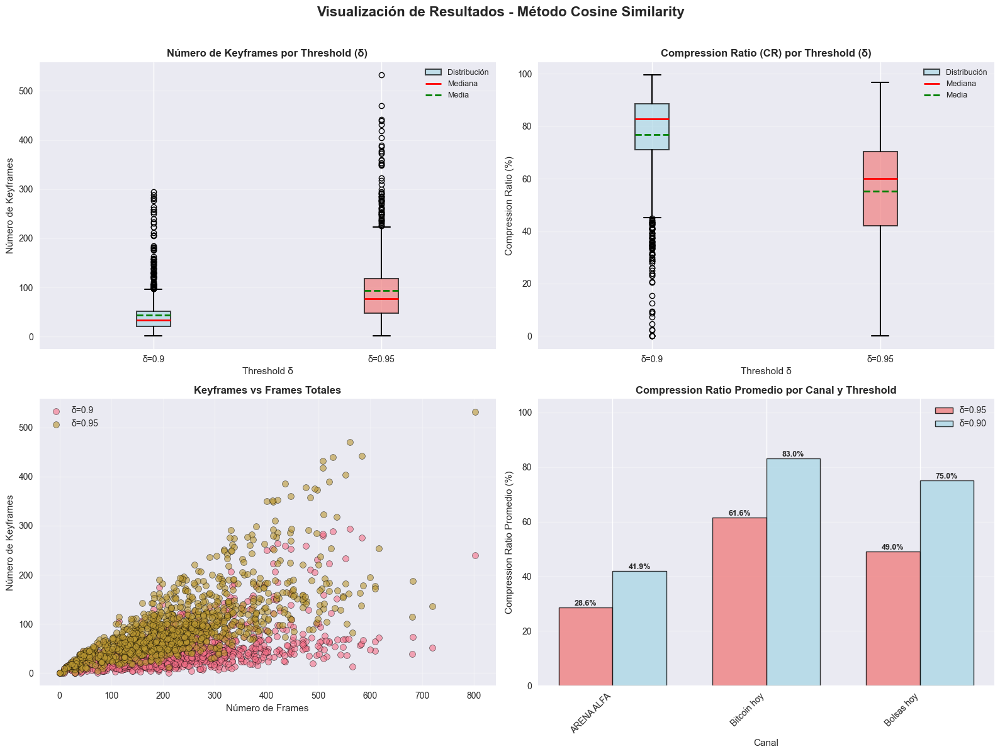

✅ Visualizaciones generadas


In [45]:
# Visualización de resultados según el artículo
if len(df_comparison) > 0:
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Visualización de Resultados - Método Cosine Similarity', fontsize=16, fontweight='bold', y=0.995)
    
    # 1. Número de keyframes por threshold (Boxplot mejorado)
    ax1 = axes[0, 0]
    threshold_values = sorted(df_comparison['threshold'].unique())
    data_for_boxplot_kf = [df_comparison[df_comparison['threshold'] == t]['n_keyframes'].values 
                           for t in threshold_values]
    bp_kf = ax1.boxplot(data_for_boxplot_kf, labels=[f'δ={t}' for t in threshold_values], 
                        patch_artist=True, showmeans=True, meanline=True,
                        boxprops=dict(linewidth=1.5), whiskerprops=dict(linewidth=1.5),
                        capprops=dict(linewidth=1.5), medianprops=dict(linewidth=2, color='red'),
                        meanprops=dict(linewidth=2, linestyle='--', color='green'))
    # Colorear los boxplots
    colors = ['lightblue', 'lightcoral']
    for patch, color in zip(bp_kf['boxes'], colors[:len(bp_kf['boxes'])]):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
        patch.set_edgecolor('black')
        patch.set_linewidth(1.5)
    ax1.set_title('Número de Keyframes por Threshold (δ)', fontsize=12, fontweight='bold')
    ax1.set_xlabel('Threshold δ', fontsize=11)
    ax1.set_ylabel('Número de Keyframes', fontsize=11)
    ax1.grid(True, alpha=0.3, axis='y')
    ax1.legend([bp_kf['boxes'][0], bp_kf['medians'][0], bp_kf['means'][0]], 
              ['Distribución', 'Mediana', 'Media'], loc='upper right', fontsize=9)
    
    # 2. Compression Ratio por threshold (Boxplot mejorado)
    ax2 = axes[0, 1]
    data_for_boxplot_cr = [df_comparison[df_comparison['threshold'] == t]['compression_ratio'].values 
                          for t in threshold_values]
    bp_cr = ax2.boxplot(data_for_boxplot_cr, labels=[f'δ={t}' for t in threshold_values], 
                        patch_artist=True, showmeans=True, meanline=True,
                        boxprops=dict(linewidth=1.5), whiskerprops=dict(linewidth=1.5),
                        capprops=dict(linewidth=1.5), medianprops=dict(linewidth=2, color='red'),
                        meanprops=dict(linewidth=2, linestyle='--', color='green'))
    # Colorear los boxplots
    for patch, color in zip(bp_cr['boxes'], colors[:len(bp_cr['boxes'])]):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
        patch.set_edgecolor('black')
        patch.set_linewidth(1.5)
    ax2.set_title('Compression Ratio (CR) por Threshold (δ)', fontsize=12, fontweight='bold')
    ax2.set_xlabel('Threshold δ', fontsize=11)
    ax2.set_ylabel('Compression Ratio (%)', fontsize=11)
    ax2.grid(True, alpha=0.3, axis='y')
    ax2.legend([bp_cr['boxes'][0], bp_cr['medians'][0], bp_cr['means'][0]], 
              ['Distribución', 'Mediana', 'Media'], loc='upper right', fontsize=9)
    
    # 3. Keyframes vs Frames totales
    ax3 = axes[1, 0]
    for threshold in THRESHOLD_VALUES:
        threshold_data = df_comparison[df_comparison['threshold'] == threshold]
        if len(threshold_data) > 0:
            ax3.scatter(threshold_data['n_frames'], threshold_data['n_keyframes'], 
                       alpha=0.6, label=f'δ={threshold}', s=50, edgecolors='black', linewidth=0.5)
    ax3.set_xlabel('Número de Frames', fontsize=11)
    ax3.set_ylabel('Número de Keyframes', fontsize=11)
    ax3.set_title('Keyframes vs Frames Totales', fontsize=12, fontweight='bold')
    ax3.legend()
    ax3.grid(True, alpha=0.3)
    
    # 4. Compression Ratio por CANAL (mejorado)
    ax4 = axes[1, 1]
    channels = sorted(df_comparison['channel_name'].unique())
    threshold_data_095 = df_comparison[df_comparison['threshold'] == 0.95]
    threshold_data_090 = df_comparison[df_comparison['threshold'] == 0.90]
    
    if len(threshold_data_095) > 0 and len(threshold_data_090) > 0:
        # Calcular promedios por canal y threshold
        x = np.arange(len(channels))
        width = 0.35
        
        cr_095_by_channel = [threshold_data_095[threshold_data_095['channel_name'] == ch]['compression_ratio'].mean() 
                            for ch in channels]
        cr_090_by_channel = [threshold_data_090[threshold_data_090['channel_name'] == ch]['compression_ratio'].mean() 
                            for ch in channels]
        
        bars1 = ax4.bar(x - width/2, cr_095_by_channel, width, 
                       label='δ=0.95', alpha=0.8, color='lightcoral', edgecolor='black', linewidth=1)
        bars2 = ax4.bar(x + width/2, cr_090_by_channel, width, 
                       label='δ=0.90', alpha=0.8, color='lightblue', edgecolor='black', linewidth=1)
        
        # Agregar valores en las barras
        for bars in [bars1, bars2]:
            for bar in bars:
                height = bar.get_height()
                ax4.text(bar.get_x() + bar.get_width()/2., height,
                        f'{height:.1f}%',
                        ha='center', va='bottom', fontsize=9, fontweight='bold')
        
        ax4.set_xlabel('Canal', fontsize=11)
        ax4.set_ylabel('Compression Ratio Promedio (%)', fontsize=11)
        ax4.set_title('Compression Ratio Promedio por Canal y Threshold', fontsize=12, fontweight='bold')
        ax4.set_xticks(x)
        ax4.set_xticklabels(channels, rotation=45, ha='right')
        ax4.legend()
        ax4.grid(True, alpha=0.3, axis='y')
        ax4.set_ylim([0, 105])  # Asegurar que se vean todos los valores
    
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()
    
    print("✅ Visualizaciones generadas")
else:
    print("⚠️  No hay resultados para visualizar")


## Paso 6: Visualización de Frames Antes y Después

Visualizamos los frames originales y los keyframes seleccionados para cada video y threshold.



In [38]:
# Preparar resultados detallados para visualización
results_detailed = []

print("📊 Preparando resultados detallados para visualización...")
print("=" * 80)

for video_data in tqdm(selected_videos, desc="Preparando datos"):
    video_id = video_data['video_id']
    channel_name = video_data['channel_name']
    
    if video_id not in all_features:
        continue
    
    features = all_features[video_id]
    frame_paths = all_frame_paths[video_id]
    
    # Aplicar método con diferentes thresholds
    for threshold in THRESHOLD_VALUES:
        try:
            keyframes, stats = extract_keyframes_cosine_similarity(
                features, frame_paths, threshold=threshold
            )
            
            # Crear lista de booleanos indicando si cada frame es keyframe
            is_keyframe = [fp in keyframes for fp in frame_paths]
            
            results_detailed.append({
                'video_id': video_id,
                'channel_name': channel_name,
                'frame_paths': frame_paths,
                'keyframes': keyframes,
                'is_keyframe': is_keyframe,
                'n_frames': len(frame_paths),
                'n_keyframes': stats['n_keyframes'],
                'threshold': threshold,
                'compression_ratio': stats['compression_ratio']
            })
        except Exception as e:
            print(f"   ❌ Error procesando video {video_id} con threshold {threshold}: {e}")

print(f"\n✅ Resultados detallados preparados: {len(results_detailed)} combinaciones video-threshold")


📊 Preparando resultados detallados para visualización...


Preparando datos: 100%|██████████| 1133/1133 [01:11<00:00, 15.92it/s]


✅ Resultados detallados preparados: 2266 combinaciones video-threshold


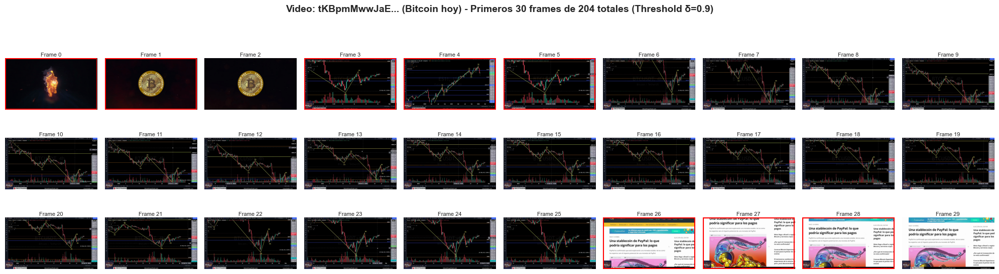

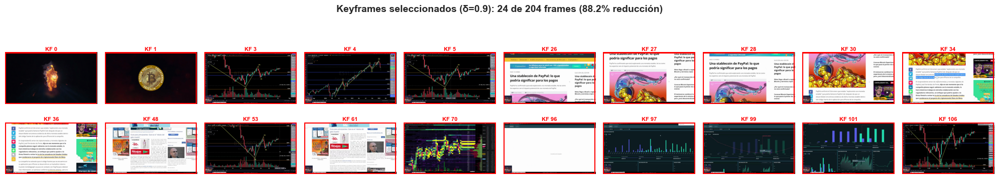


✅ Video tKBpmMwwJaE... procesado (δ=0.9): 24 keyframes de 204 frames


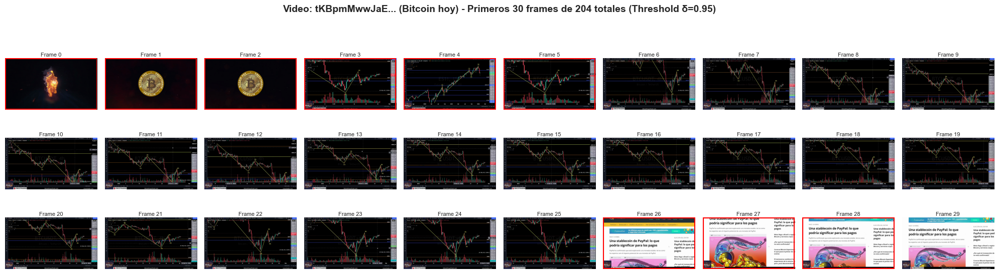

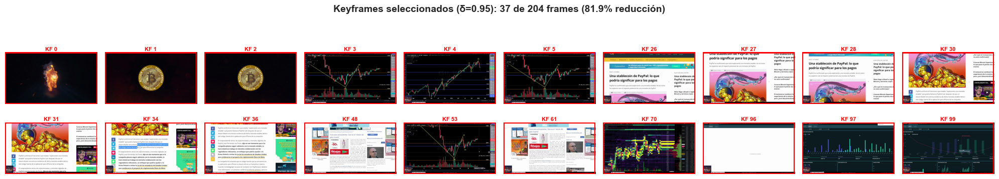


✅ Video tKBpmMwwJaE... procesado (δ=0.95): 37 keyframes de 204 frames


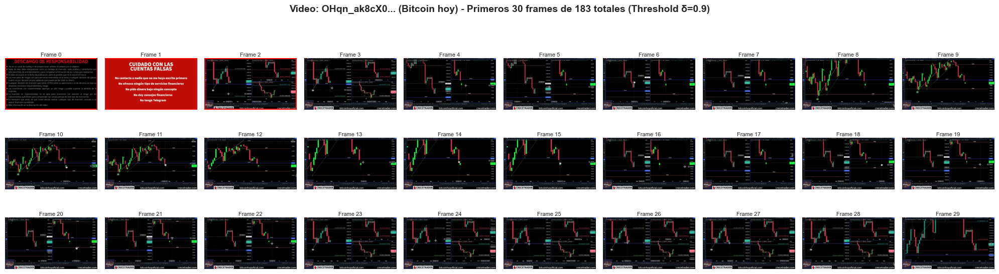

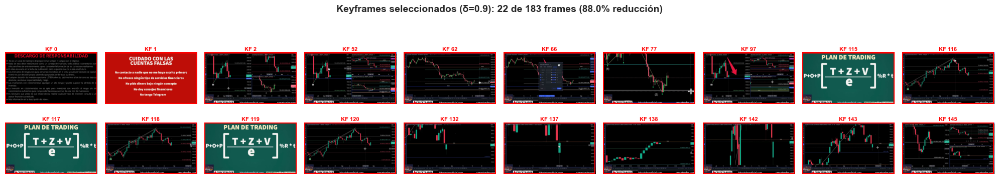


✅ Video OHqn_ak8cX0... procesado (δ=0.9): 22 keyframes de 183 frames


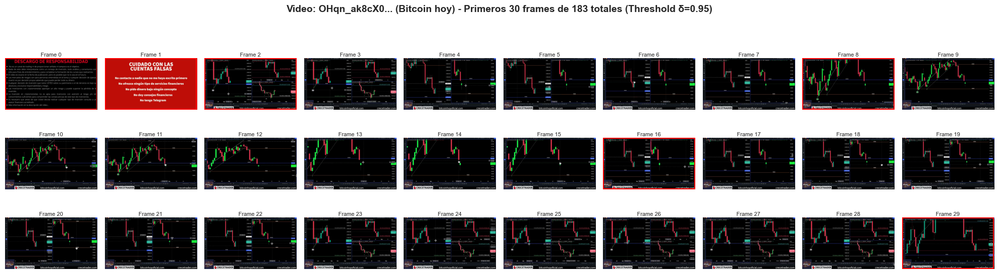

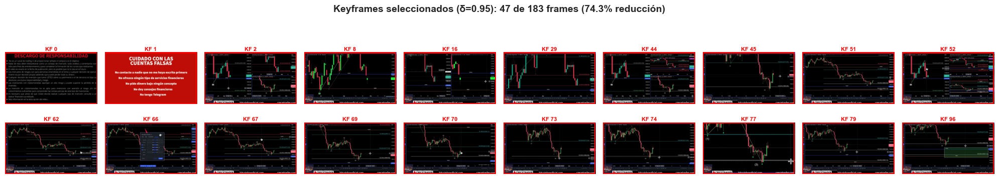


✅ Video OHqn_ak8cX0... procesado (δ=0.95): 47 keyframes de 183 frames


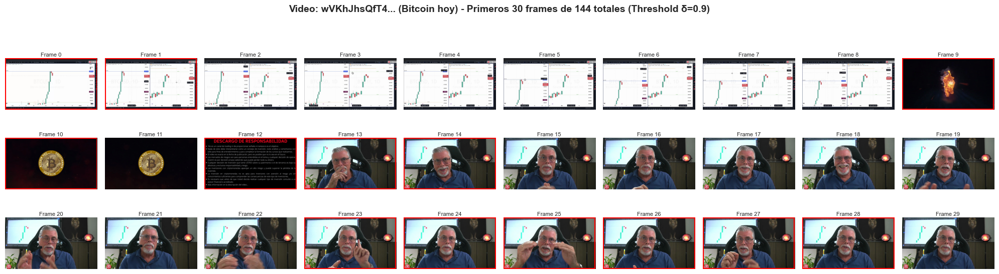

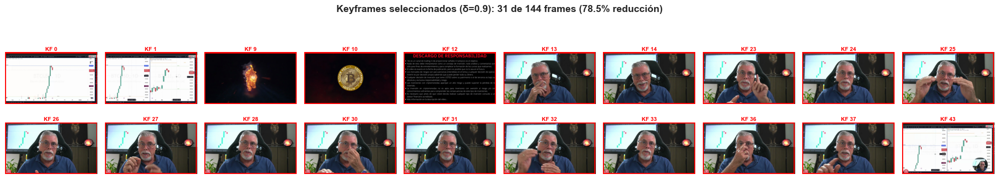


✅ Video wVKhJhsQfT4... procesado (δ=0.9): 31 keyframes de 144 frames


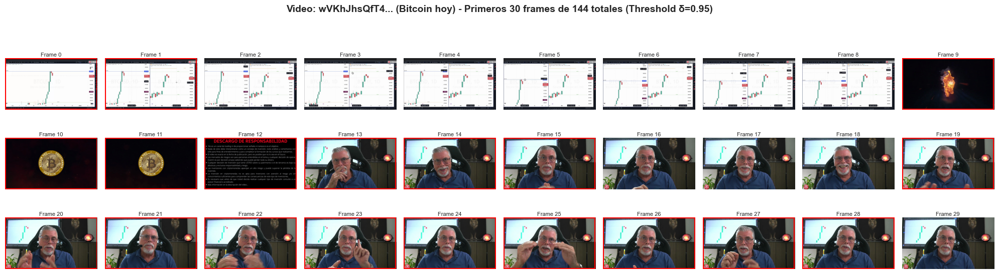

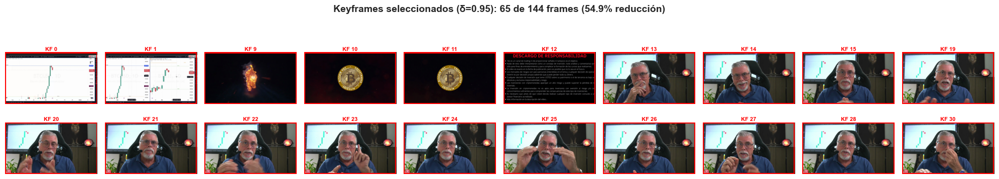


✅ Video wVKhJhsQfT4... procesado (δ=0.95): 65 keyframes de 144 frames


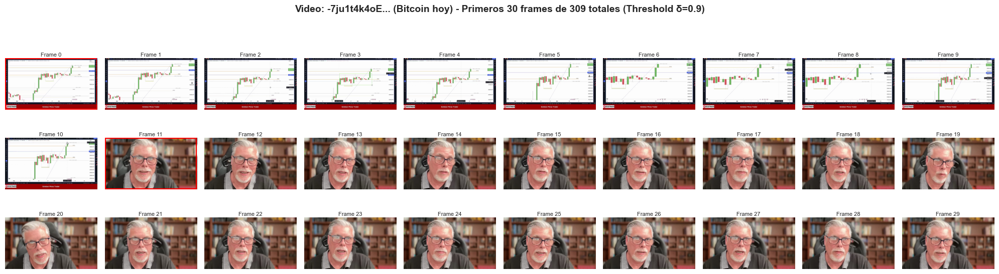

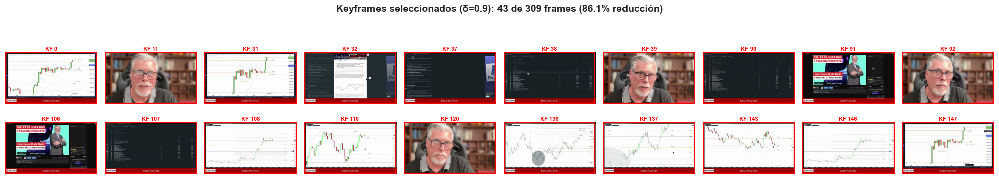


✅ Video -7ju1t4k4oE... procesado (δ=0.9): 43 keyframes de 309 frames


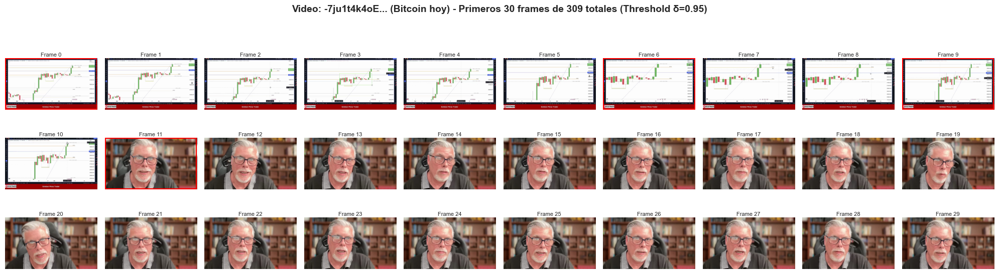

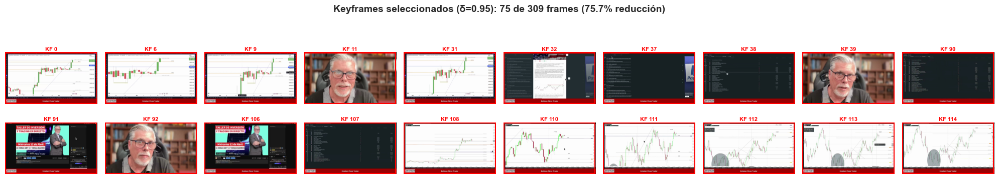


✅ Video -7ju1t4k4oE... procesado (δ=0.95): 75 keyframes de 309 frames


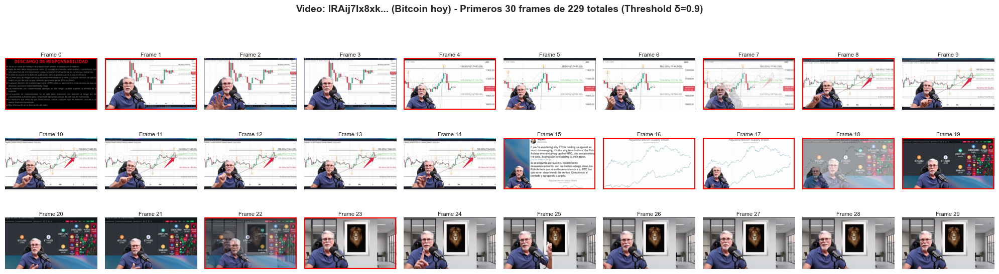

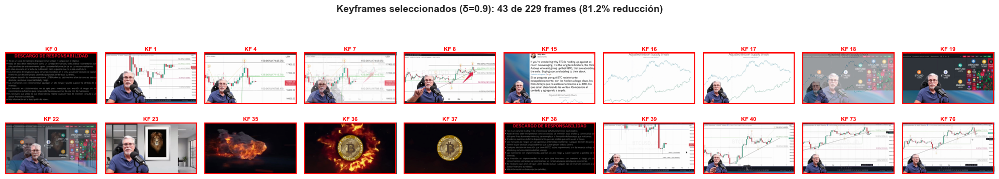


✅ Video IRAij7lx8xk... procesado (δ=0.9): 43 keyframes de 229 frames


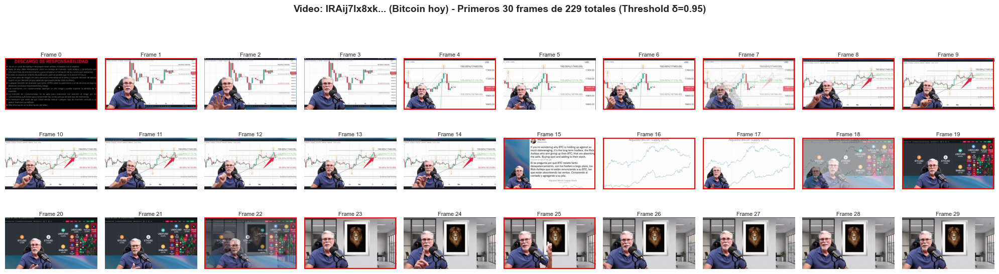

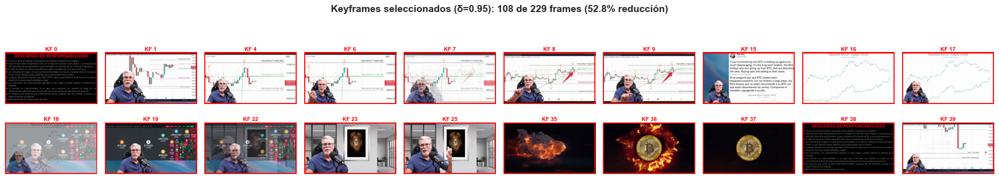


✅ Video IRAij7lx8xk... procesado (δ=0.95): 108 keyframes de 229 frames


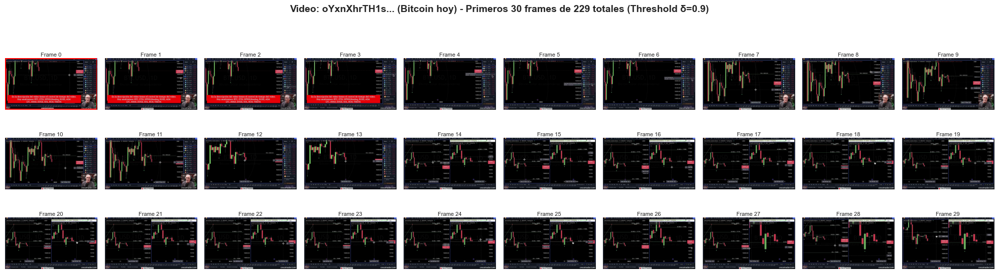

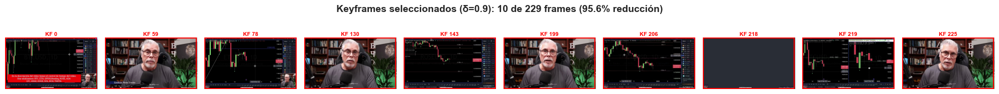


✅ Video oYxnXhrTH1s... procesado (δ=0.9): 10 keyframes de 229 frames


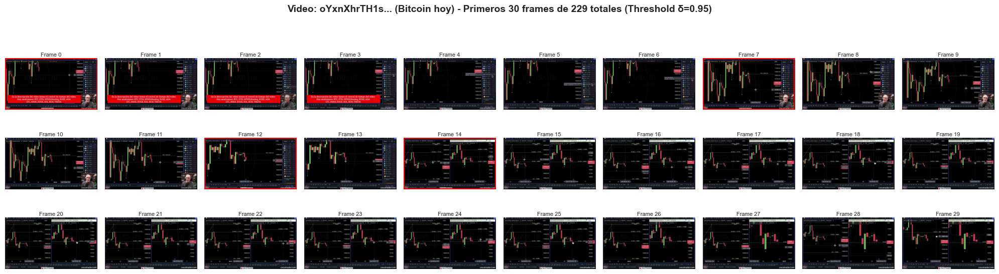

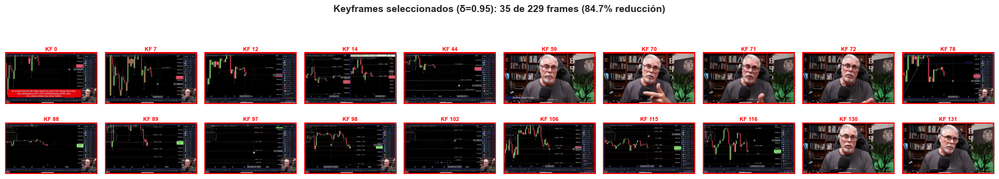


✅ Video oYxnXhrTH1s... procesado (δ=0.95): 35 keyframes de 229 frames


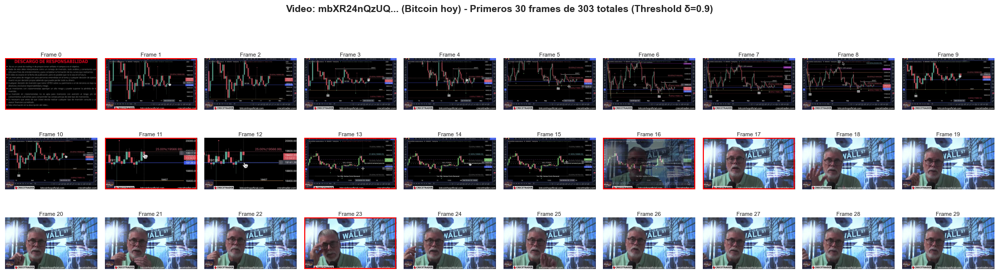

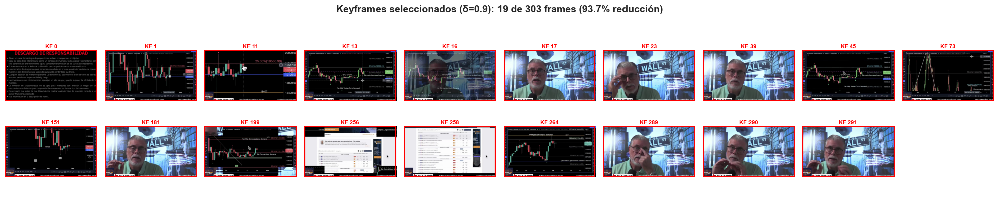


✅ Video mbXR24nQzUQ... procesado (δ=0.9): 19 keyframes de 303 frames


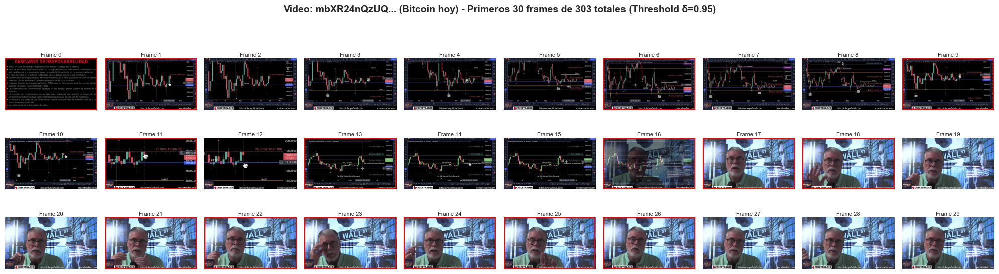

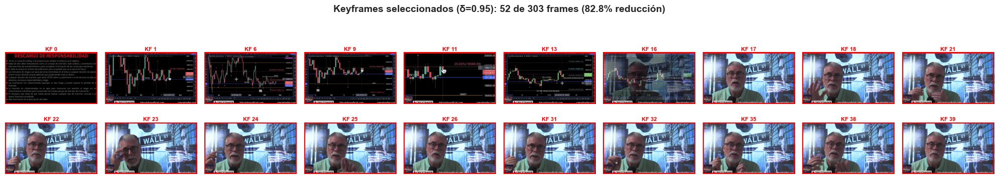


✅ Video mbXR24nQzUQ... procesado (δ=0.95): 52 keyframes de 303 frames


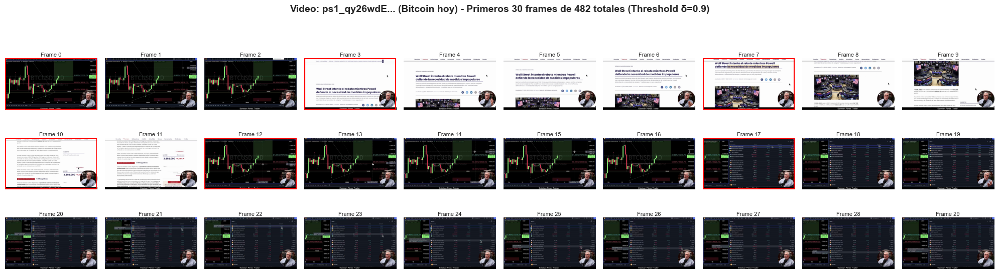

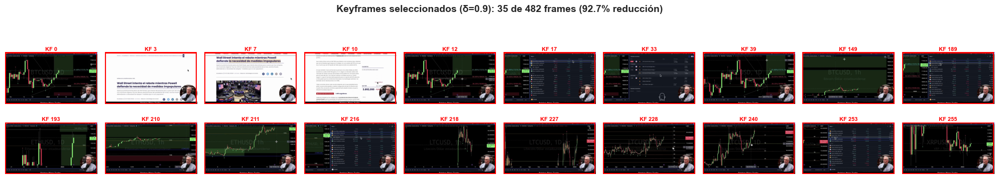


✅ Video ps1_qy26wdE... procesado (δ=0.9): 35 keyframes de 482 frames


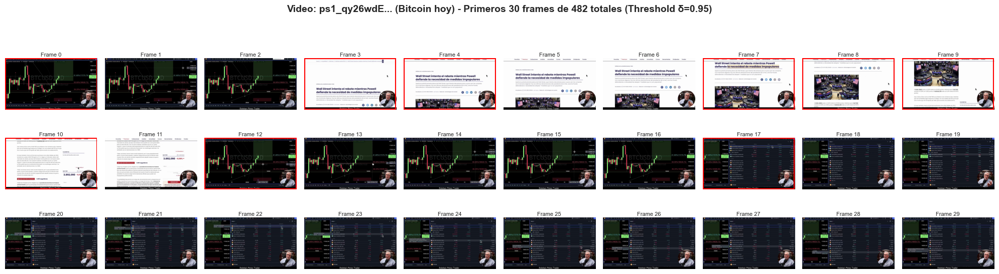

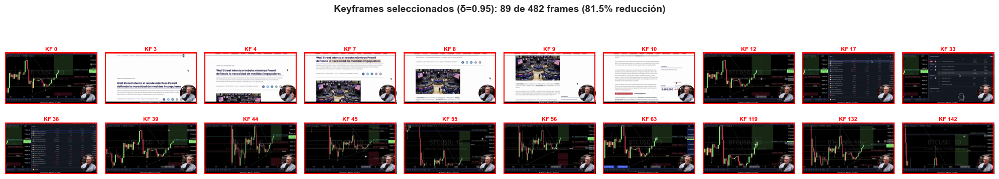


✅ Video ps1_qy26wdE... procesado (δ=0.95): 89 keyframes de 482 frames


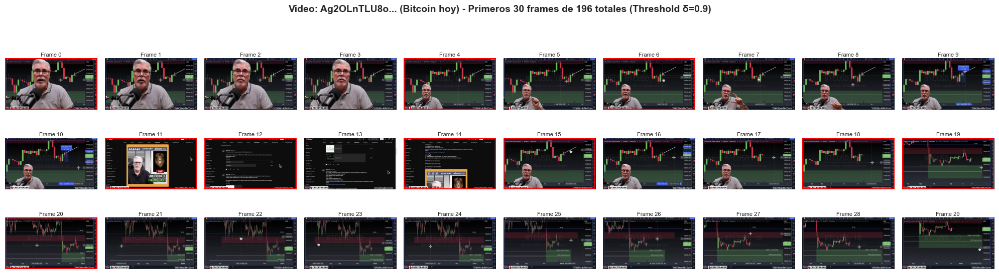

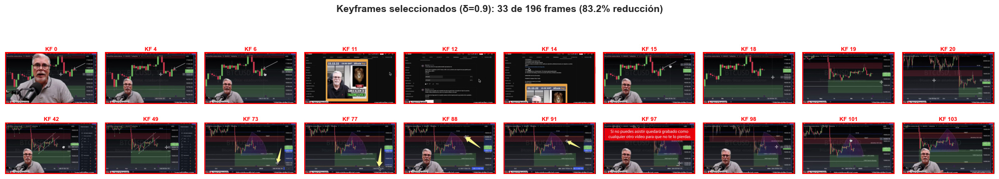


✅ Video Ag2OLnTLU8o... procesado (δ=0.9): 33 keyframes de 196 frames


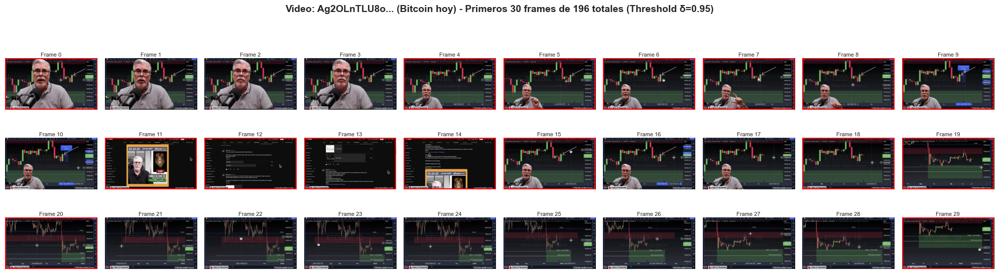

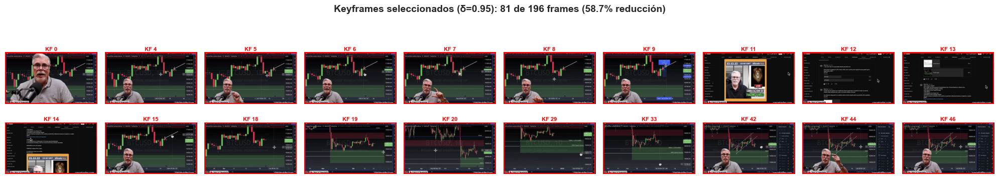


✅ Video Ag2OLnTLU8o... procesado (δ=0.95): 81 keyframes de 196 frames


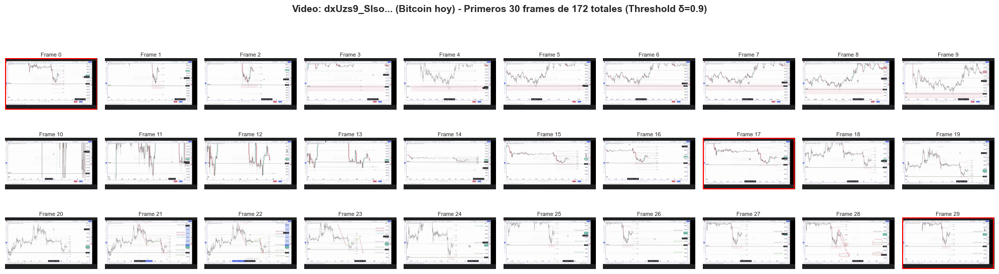

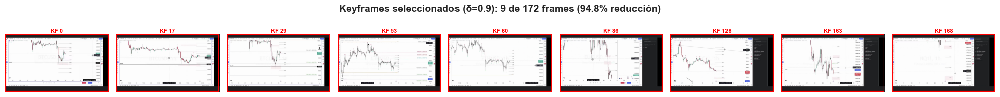


✅ Video dxUzs9_SIso... procesado (δ=0.9): 9 keyframes de 172 frames


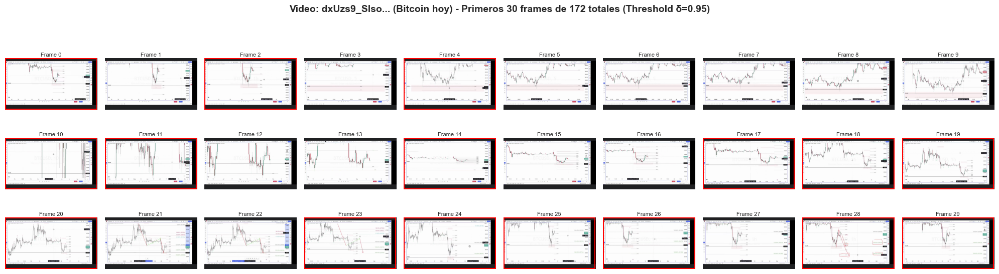

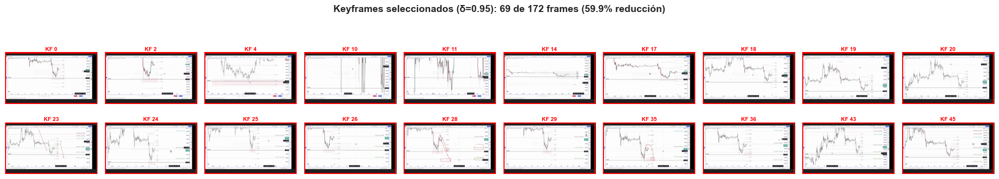


✅ Video dxUzs9_SIso... procesado (δ=0.95): 69 keyframes de 172 frames


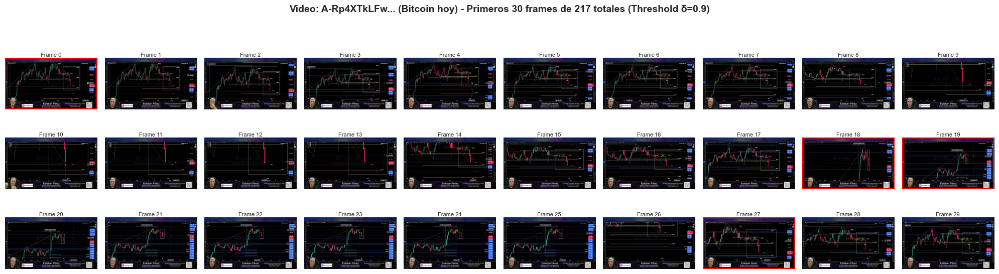

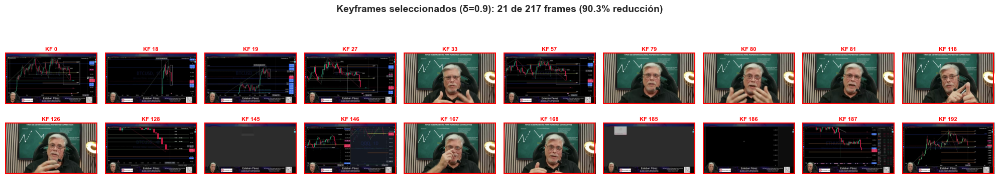


✅ Video A-Rp4XTkLFw... procesado (δ=0.9): 21 keyframes de 217 frames


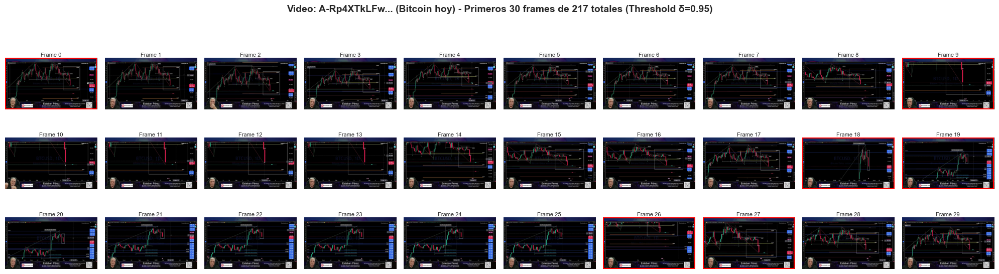

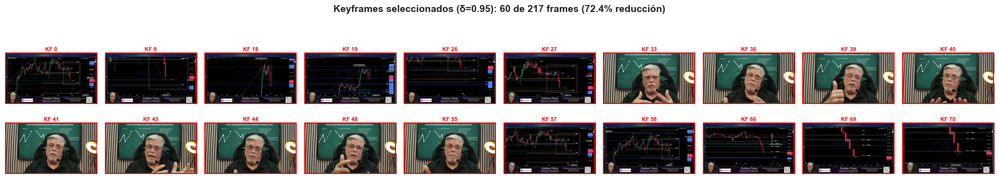


✅ Video A-Rp4XTkLFw... procesado (δ=0.95): 60 keyframes de 217 frames


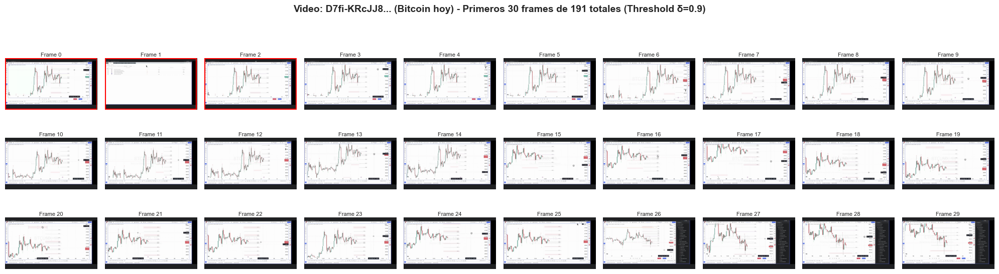

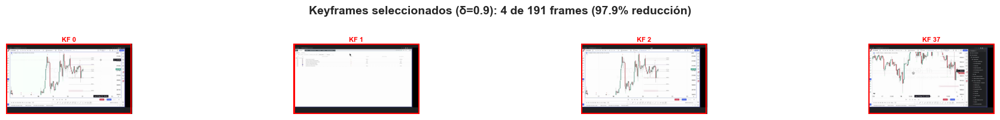


✅ Video D7fi-KRcJJ8... procesado (δ=0.9): 4 keyframes de 191 frames


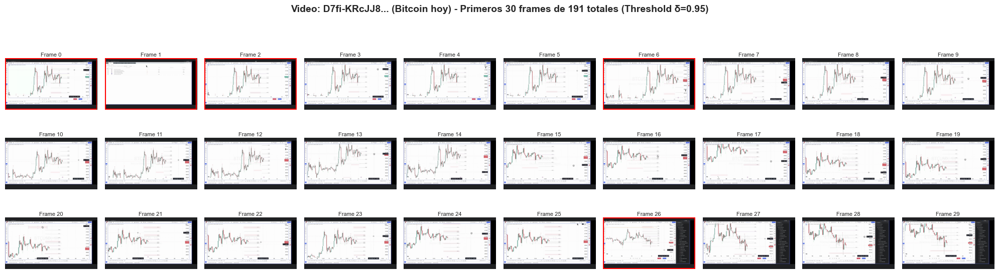

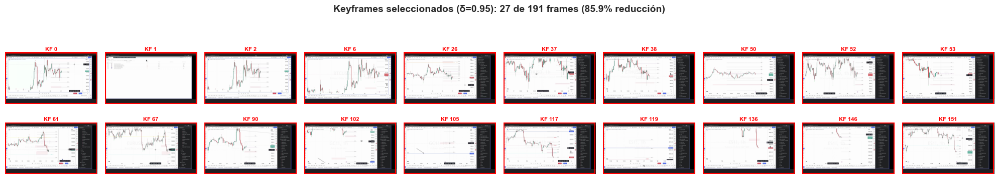


✅ Video D7fi-KRcJJ8... procesado (δ=0.95): 27 keyframes de 191 frames


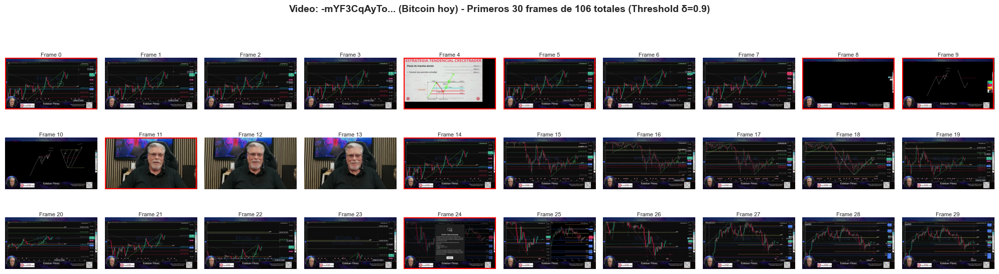

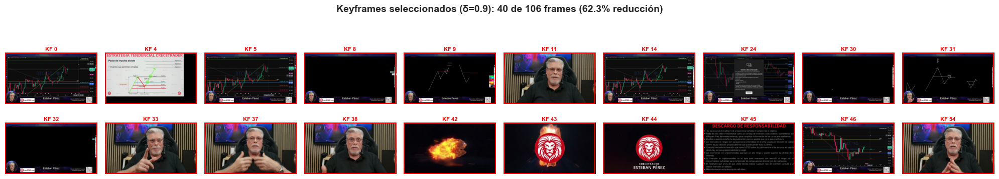


✅ Video -mYF3CqAyTo... procesado (δ=0.9): 40 keyframes de 106 frames


In [41]:
# Visualización de los primeros N frames de cada canal
# Mostrar imágenes reales: primeros N frames arriba, keyframes abajo
N_FRAMES_TO_SHOW = 30  # Número de frames a visualizar (reducido para mejor visualización)

if len(results_detailed) > 0:
    from PIL import Image
    import os
    
    # Agrupar por canal
    from collections import defaultdict
    videos_by_channel = defaultdict(list)
    for result in results_detailed[:25]:
        channel = result['channel_name']
        videos_by_channel[channel].append(result)
    
    # Crear visualización para cada canal
    for channel_name, channel_videos in videos_by_channel.items():
        # Para cada video del canal, mostrar imágenes
        for video_result in channel_videos:
            video_id = video_result['video_id']
            frame_paths = video_result['frame_paths']
            keyframes = video_result['keyframes']
            is_keyframe = video_result['is_keyframe']
            n_frames = video_result['n_frames']
            n_keyframes = video_result['n_keyframes']
            threshold = video_result['threshold']
            
            # Tomar los primeros N frames
            n_show = min(N_FRAMES_TO_SHOW, n_frames)
            first_n_frames = frame_paths[:n_show]
            
            # Mostrar imágenes de los primeros N frames
            if len(first_n_frames) > 0:
                # Crear grid para las imágenes
                n_cols = min(10, len(first_n_frames))
                n_rows = (len(first_n_frames) + n_cols - 1) // n_cols
                
                # Crear figura para los primeros N frames
                fig_frames, axes_frames = plt.subplots(n_rows, n_cols, figsize=(20, 2 * n_rows))
                fig_frames.suptitle(f'Video: {video_id[:12]}... ({channel_name}) - Primeros {n_show} frames de {n_frames} totales (Threshold δ={threshold})', 
                                   fontsize=14, fontweight='bold', y=0.98)
                
                # Aplanar axes para acceso más fácil
                if n_rows == 1 and n_cols == 1:
                    axes_flat = [axes_frames]
                elif n_rows == 1:
                    axes_flat = axes_frames.flatten() if hasattr(axes_frames, 'flatten') else [axes_frames]
                elif n_cols == 1:
                    axes_flat = axes_frames.flatten() if hasattr(axes_frames, 'flatten') else [axes_frames]
                else:
                    axes_flat = axes_frames.flatten()
                
                for idx, frame_path in enumerate(first_n_frames):
                    ax = axes_flat[idx]
                    ax.axis('off')
                    
                    # Cargar y mostrar imagen
                    if os.path.exists(frame_path):
                        try:
                            img = Image.open(frame_path)
                            ax.imshow(img)
                            # Marcar si es keyframe
                            if frame_path in keyframes:
                                # Agregar borde rojo
                                from matplotlib.patches import Rectangle
                                rect = Rectangle((0, 0), img.width, img.height, 
                                                 fill=False, edgecolor='red', linewidth=3, transform=ax.transData)
                                ax.add_patch(rect)
                            ax.set_title(f'Frame {idx}', fontsize=8, pad=2)
                        except Exception as e:
                            ax.text(0.5, 0.5, f'Error\n{str(e)[:20]}', 
                                   ha='center', va='center', fontsize=6, transform=ax.transAxes)
                    else:
                        ax.text(0.5, 0.5, 'Not found', ha='center', va='center', fontsize=6, transform=ax.transAxes)
                
                # Ocultar subplots vacíos
                for idx in range(len(first_n_frames), len(axes_flat)):
                    axes_flat[idx].axis('off')
                
                plt.tight_layout(rect=[0, 0, 1, 0.96])
                plt.show()
            
            # Mostrar imágenes de los keyframes
            if len(keyframes) > 0:
                # Limitar número de keyframes a mostrar (máximo 20)
                keyframes_to_show = keyframes[:20]
                
                # Crear grid para las imágenes de keyframes
                n_cols_kf = min(10, len(keyframes_to_show))
                n_rows_kf = (len(keyframes_to_show) + n_cols_kf - 1) // n_cols_kf
                
                # Crear figura para los keyframes
                fig_keyframes, axes_keyframes = plt.subplots(n_rows_kf, n_cols_kf, figsize=(20, 2 * n_rows_kf))
                fig_keyframes.suptitle(f'Keyframes seleccionados (δ={threshold}): {n_keyframes} de {n_frames} frames ({100*(1-n_keyframes/n_frames):.1f}% reducción)', 
                                      fontsize=14, fontweight='bold', y=0.98)
                
                # Aplanar axes para acceso más fácil
                if n_rows_kf == 1 and n_cols_kf == 1:
                    axes_kf_flat = [axes_keyframes]
                elif n_rows_kf == 1:
                    axes_kf_flat = axes_keyframes.flatten() if hasattr(axes_keyframes, 'flatten') else [axes_keyframes]
                elif n_cols_kf == 1:
                    axes_kf_flat = axes_keyframes.flatten() if hasattr(axes_keyframes, 'flatten') else [axes_keyframes]
                else:
                    axes_kf_flat = axes_keyframes.flatten()
                
                for idx, keyframe_path in enumerate(keyframes_to_show):
                    ax = axes_kf_flat[idx]
                    ax.axis('off')
                    
                    # Cargar y mostrar imagen
                    if os.path.exists(keyframe_path):
                        try:
                            img = Image.open(keyframe_path)
                            ax.imshow(img)
                            # Marcar con borde rojo
                            from matplotlib.patches import Rectangle
                            rect = Rectangle((0, 0), img.width, img.height, 
                                             fill=False, edgecolor='red', linewidth=3, transform=ax.transData)
                            ax.add_patch(rect)
                            # Encontrar índice del frame
                            frame_idx = frame_paths.index(keyframe_path) if keyframe_path in frame_paths else idx
                            ax.set_title(f'KF {frame_idx}', fontsize=8, color='red', fontweight='bold', pad=2)
                        except Exception as e:
                            ax.text(0.5, 0.5, f'Error\n{str(e)[:20]}', 
                                   ha='center', va='center', fontsize=6, transform=ax.transAxes)
                    else:
                        ax.text(0.5, 0.5, 'Not found', ha='center', va='center', fontsize=6, transform=ax.transAxes)
                
                # Ocultar subplots vacíos
                for idx in range(len(keyframes_to_show), len(axes_kf_flat)):
                    axes_kf_flat[idx].axis('off')
                
                plt.tight_layout(rect=[0, 0, 1, 0.96])
                plt.show()
            
            print(f"\n✅ Video {video_id[:12]}... procesado (δ={threshold}): {n_keyframes} keyframes de {n_frames} frames")
            print("=" * 80)
else:
    print("⚠️  No hay resultados detallados para visualizar")
    print("   Ejecuta primero la celda que prepara los resultados detallados")



## Resumen y Conclusiones

### Método Implementado (según el artículo):
**Key-frame-Based Video Summarization Using Similarity Measure (Cosine Similarity)**

### Características del Método:
1. **NO usa clustering**: Usa cosine similarity directamente entre frames consecutivos
2. **Selección basada en threshold**: Frames con similitud < threshold δ se seleccionan
3. **Primer frame siempre seleccionado**: El primer frame siempre es un keyframe
4. **Thresholds evaluados**: δ=0.90 y δ=0.95 (según el artículo)

### Métricas de Evaluación (según el artículo):
- **Compression Ratio (CR)**: CR(V) = (1 - (Nk/N)) * 100
  - N: número total de frames
  - Nk: número de keyframes seleccionados
- **F1-score**: Métrica mencionada en el artículo (requiere ground truth)
- **Número de keyframes**: Cantidad de frames seleccionados

### Referencia del Artículo:
"Key-frame-Based Video Summarization Using Similarity Measure"  
*Manjusha Yeola and Sunita Barve*

**Resultados del artículo:**
- Mejor Compression Ratio promedio: 97.75% (con δ=0.90 usando GoogleNet)
- ResNet-50: Mejor F1-score promedio (0.21 con δ=0.95)
- GoogleNet: Mejor Compression Ratio pero menor calidad de resumen


## Resumen Final y Estadísticas de Resultados

Resumen completo de los resultados obtenidos con el método de Cosine Similarity según las métricas del artículo.


In [43]:
# Resumen Final y Estadísticas de Resultados
# Métricas según el artículo: Compression Ratio (CR)

print("=" * 80)
print("📊 RESUMEN FINAL Y ESTADÍSTICAS DE RESULTADOS")
print("=" * 80)
print("\nMétodo: Key-frame-Based Video Summarization Using Similarity Measure (Cosine Similarity)")
print("Métrica Principal: Compression Ratio (CR)")
print("=" * 80)

if 'df_comparison' in locals() and len(df_comparison) > 0:
    # Estadísticas generales
    print("\n📈 ESTADÍSTICAS GENERALES:")
    print("-" * 80)
    print(f"   Total de videos analizados: {df_comparison['video_id'].nunique()}")
    print(f"   Total de resultados (videos × thresholds): {len(df_comparison)}")
    print(f"   Canales analizados: {df_comparison['channel_name'].nunique()}")
    print(f"   Canales: {', '.join(df_comparison['channel_name'].unique())}")
    
    # Estadísticas por threshold
    print("\n📊 ESTADÍSTICAS POR THRESHOLD (δ):")
    print("-" * 80)
    for threshold in sorted(df_comparison['threshold'].unique()):
        threshold_data = df_comparison[df_comparison['threshold'] == threshold]
        print(f"\n   Threshold δ={threshold}:")
        print(f"      Videos: {threshold_data['video_id'].nunique()}")
        print(f"      Keyframes promedio: {threshold_data['n_keyframes'].mean():.2f} ± {threshold_data['n_keyframes'].std():.2f}")
        print(f"      Compression Ratio promedio: {threshold_data['compression_ratio'].mean():.2f}% ± {threshold_data['compression_ratio'].std():.2f}%")
        print(f"      Compression Ratio mínimo: {threshold_data['compression_ratio'].min():.2f}%")
        print(f"      Compression Ratio máximo: {threshold_data['compression_ratio'].max():.2f}%")
        print(f"      Frames promedio por video: {threshold_data['n_frames'].mean():.2f} ± {threshold_data['n_frames'].std():.2f}")
    
    # Estadísticas por canal
    print("\n📺 ESTADÍSTICAS POR CANAL:")
    print("-" * 80)
    for channel in sorted(df_comparison['channel_name'].unique()):
        channel_data = df_comparison[df_comparison['channel_name'] == channel]
        print(f"\n   Canal: {channel}")
        print(f"      Videos: {channel_data['video_id'].nunique()}")
        for threshold in sorted(channel_data['threshold'].unique()):
            threshold_channel_data = channel_data[channel_data['threshold'] == threshold]
            print(f"      Threshold δ={threshold}:")
            print(f"         Keyframes promedio: {threshold_channel_data['n_keyframes'].mean():.2f} ± {threshold_channel_data['n_keyframes'].std():.2f}")
            print(f"         Compression Ratio promedio: {threshold_channel_data['compression_ratio'].mean():.2f}% ± {threshold_channel_data['compression_ratio'].std():.2f}%")
    
    # Comparación entre thresholds
    print("\n🔄 COMPARACIÓN ENTRE THRESHOLDS:")
    print("-" * 80)
    threshold_090 = df_comparison[df_comparison['threshold'] == 0.90]
    threshold_095 = df_comparison[df_comparison['threshold'] == 0.95]
    
    if len(threshold_090) > 0 and len(threshold_095) > 0:
        print(f"   δ=0.90 vs δ=0.95:")
        print(f"      Diferencia en CR promedio: {threshold_090['compression_ratio'].mean() - threshold_095['compression_ratio'].mean():.2f}%")
        print(f"      Diferencia en keyframes promedio: {threshold_090['n_keyframes'].mean() - threshold_095['n_keyframes'].mean():.2f} frames")
        print(f"      δ=0.90 selecciona {((threshold_090['n_keyframes'].mean() / threshold_095['n_keyframes'].mean()) - 1) * 100:.1f}% menos keyframes que δ=0.95")
    
    # Mejores resultados
    print("\n🏆 MEJORES RESULTADOS:")
    print("-" * 80)
    best_cr_090 = threshold_090.loc[threshold_090['compression_ratio'].idxmax()] if len(threshold_090) > 0 else None
    best_cr_095 = threshold_095.loc[threshold_095['compression_ratio'].idxmax()] if len(threshold_095) > 0 else None
    
    if best_cr_090 is not None:
        print(f"   Mejor Compression Ratio (δ=0.90):")
        print(f"      Video: {best_cr_090['video_id']} ({best_cr_090['channel_name']})")
        print(f"      CR: {best_cr_090['compression_ratio']:.2f}%")
        print(f"      Keyframes: {best_cr_090['n_keyframes']:.0f} de {best_cr_090['n_frames']:.0f} frames")
    
    if best_cr_095 is not None:
        print(f"\n   Mejor Compression Ratio (δ=0.95):")
        print(f"      Video: {best_cr_095['video_id']} ({best_cr_095['channel_name']})")
        print(f"      CR: {best_cr_095['compression_ratio']:.2f}%")
        print(f"      Keyframes: {best_cr_095['n_keyframes']:.0f} de {best_cr_095['n_frames']:.0f} frames")
    
    print("\n" + "=" * 80)
    print("✅ Resumen completado")
    print("=" * 80)
else:
    print("\n⚠️  No hay resultados disponibles. Ejecuta primero las celdas de procesamiento.")


📊 RESUMEN FINAL Y ESTADÍSTICAS DE RESULTADOS

Método: Key-frame-Based Video Summarization Using Similarity Measure (Cosine Similarity)
Métrica Principal: Compression Ratio (CR)

📈 ESTADÍSTICAS GENERALES:
--------------------------------------------------------------------------------
   Total de videos analizados: 1133
   Total de resultados (videos × thresholds): 2266
   Canales analizados: 3
   Canales: Bitcoin hoy, ARENA ALFA, Bolsas hoy

📊 ESTADÍSTICAS POR THRESHOLD (δ):
--------------------------------------------------------------------------------

   Threshold δ=0.9:
      Videos: 1133
      Keyframes promedio: 43.99 ± 40.46
      Compression Ratio promedio: 76.73% ± 18.00%
      Compression Ratio mínimo: 0.00%
      Compression Ratio máximo: 99.53%
      Frames promedio por video: 223.65 ± 128.52

   Threshold δ=0.95:
      Videos: 1133
      Keyframes promedio: 93.82 ± 69.03
      Compression Ratio promedio: 55.17% ± 19.68%
      Compression Ratio mínimo: 0.00%
      Compress

## Gráficos de Distribución de Resultados

Visualizaciones de las distribuciones de las métricas principales: Compression Ratio, número de keyframes y comparación por threshold.


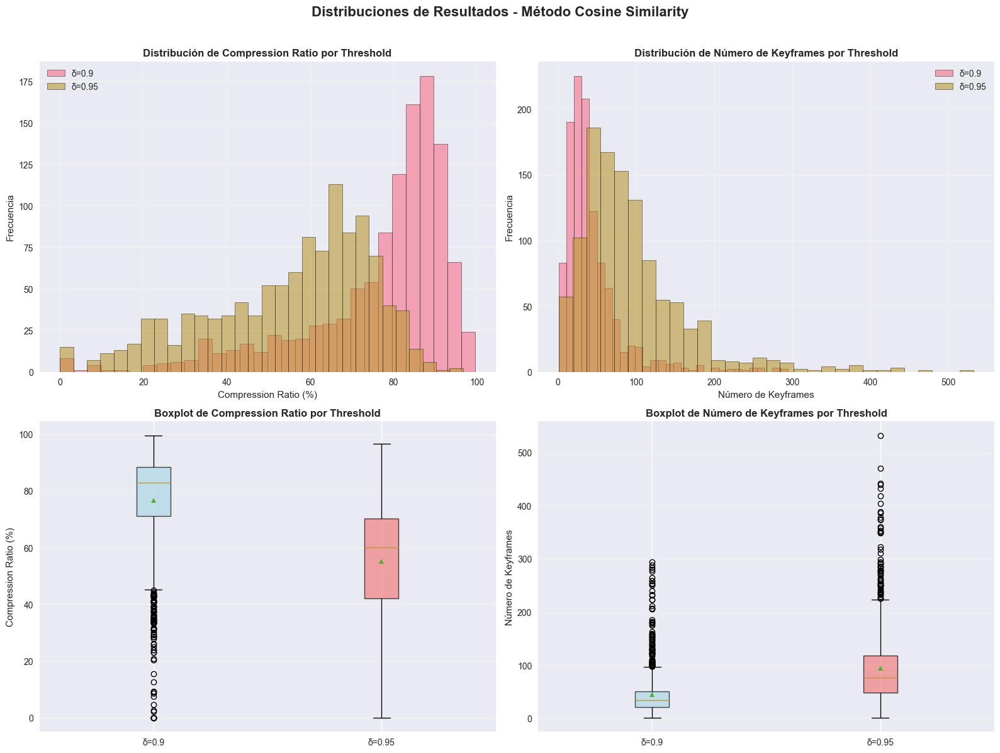

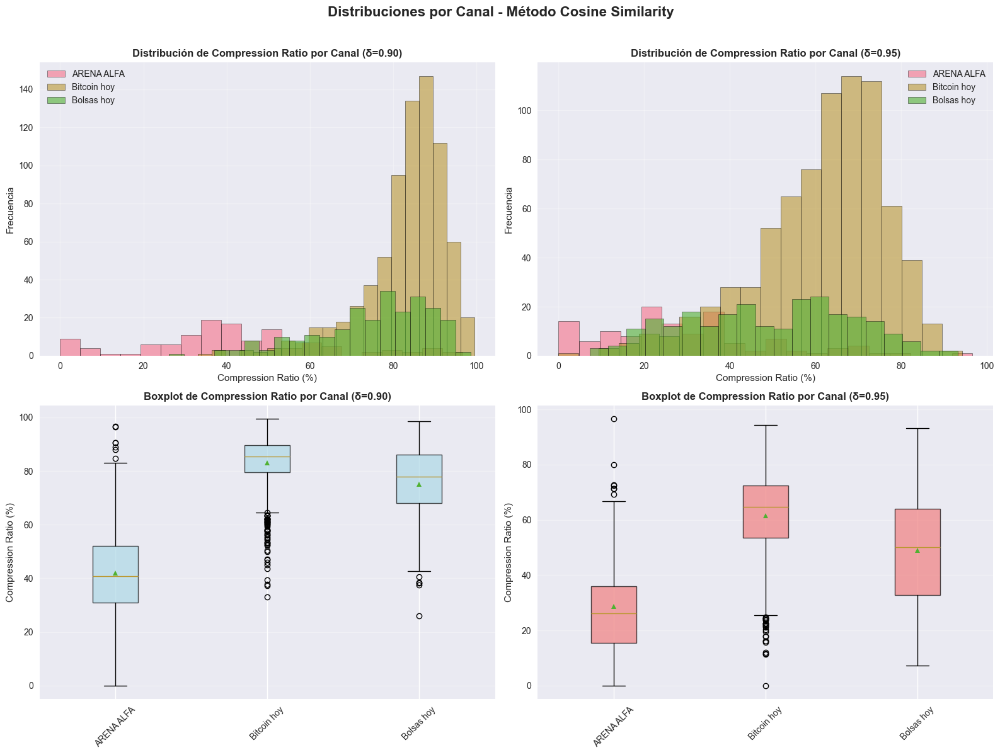

✅ Gráficos de distribución generados


In [44]:
# Gráficos de Distribución de Resultados
# Distribuciones: Compression Ratio, Número de Keyframes, Comparación por Threshold

if 'df_comparison' in locals() and len(df_comparison) > 0:
    # Crear figura con subplots
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Distribuciones de Resultados - Método Cosine Similarity', fontsize=16, fontweight='bold', y=0.995)
    
    # 1. Distribución de Compression Ratio por Threshold
    ax1 = axes[0, 0]
    for threshold in sorted(df_comparison['threshold'].unique()):
        threshold_data = df_comparison[df_comparison['threshold'] == threshold]
        ax1.hist(threshold_data['compression_ratio'], bins=30, alpha=0.6, 
                label=f'δ={threshold}', edgecolor='black', linewidth=0.5)
    ax1.set_xlabel('Compression Ratio (%)', fontsize=11)
    ax1.set_ylabel('Frecuencia', fontsize=11)
    ax1.set_title('Distribución de Compression Ratio por Threshold', fontsize=12, fontweight='bold')
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    
    # 2. Distribución de Número de Keyframes por Threshold
    ax2 = axes[0, 1]
    for threshold in sorted(df_comparison['threshold'].unique()):
        threshold_data = df_comparison[df_comparison['threshold'] == threshold]
        ax2.hist(threshold_data['n_keyframes'], bins=30, alpha=0.6, 
                label=f'δ={threshold}', edgecolor='black', linewidth=0.5)
    ax2.set_xlabel('Número de Keyframes', fontsize=11)
    ax2.set_ylabel('Frecuencia', fontsize=11)
    ax2.set_title('Distribución de Número de Keyframes por Threshold', fontsize=12, fontweight='bold')
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    # 3. Boxplot de Compression Ratio por Threshold
    ax3 = axes[1, 0]
    threshold_values = sorted(df_comparison['threshold'].unique())
    data_for_boxplot = [df_comparison[df_comparison['threshold'] == t]['compression_ratio'].values 
                        for t in threshold_values]
    bp = ax3.boxplot(data_for_boxplot, labels=[f'δ={t}' for t in threshold_values], 
                     patch_artist=True, showmeans=True)
    # Colorear los boxplots
    colors = ['lightblue', 'lightcoral']
    for patch, color in zip(bp['boxes'], colors[:len(bp['boxes'])]):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    ax3.set_ylabel('Compression Ratio (%)', fontsize=11)
    ax3.set_title('Boxplot de Compression Ratio por Threshold', fontsize=12, fontweight='bold')
    ax3.grid(True, alpha=0.3, axis='y')
    
    # 4. Boxplot de Número de Keyframes por Threshold
    ax4 = axes[1, 1]
    data_for_boxplot_kf = [df_comparison[df_comparison['threshold'] == t]['n_keyframes'].values 
                           for t in threshold_values]
    bp_kf = ax4.boxplot(data_for_boxplot_kf, labels=[f'δ={t}' for t in threshold_values], 
                        patch_artist=True, showmeans=True)
    # Colorear los boxplots
    for patch, color in zip(bp_kf['boxes'], colors[:len(bp_kf['boxes'])]):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    ax4.set_ylabel('Número de Keyframes', fontsize=11)
    ax4.set_title('Boxplot de Número de Keyframes por Threshold', fontsize=12, fontweight='bold')
    ax4.grid(True, alpha=0.3, axis='y')
    
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()
    
    # Gráficos adicionales: Distribución por Canal
    fig2, axes2 = plt.subplots(2, 2, figsize=(16, 12))
    fig2.suptitle('Distribuciones por Canal - Método Cosine Similarity', fontsize=16, fontweight='bold', y=0.995)
    
    channels = sorted(df_comparison['channel_name'].unique())
    
    # 5. Distribución de Compression Ratio por Canal (δ=0.90)
    ax5 = axes2[0, 0]
    threshold_090 = df_comparison[df_comparison['threshold'] == 0.90]
    for channel in channels:
        channel_data = threshold_090[threshold_090['channel_name'] == channel]
        if len(channel_data) > 0:
            ax5.hist(channel_data['compression_ratio'], bins=20, alpha=0.6, 
                    label=channel, edgecolor='black', linewidth=0.5)
    ax5.set_xlabel('Compression Ratio (%)', fontsize=11)
    ax5.set_ylabel('Frecuencia', fontsize=11)
    ax5.set_title('Distribución de Compression Ratio por Canal (δ=0.90)', fontsize=12, fontweight='bold')
    ax5.legend()
    ax5.grid(True, alpha=0.3)
    
    # 6. Distribución de Compression Ratio por Canal (δ=0.95)
    ax6 = axes2[0, 1]
    threshold_095 = df_comparison[df_comparison['threshold'] == 0.95]
    for channel in channels:
        channel_data = threshold_095[threshold_095['channel_name'] == channel]
        if len(channel_data) > 0:
            ax6.hist(channel_data['compression_ratio'], bins=20, alpha=0.6, 
                    label=channel, edgecolor='black', linewidth=0.5)
    ax6.set_xlabel('Compression Ratio (%)', fontsize=11)
    ax6.set_ylabel('Frecuencia', fontsize=11)
    ax6.set_title('Distribución de Compression Ratio por Canal (δ=0.95)', fontsize=12, fontweight='bold')
    ax6.legend()
    ax6.grid(True, alpha=0.3)
    
    # 7. Boxplot de Compression Ratio por Canal (δ=0.90)
    ax7 = axes2[1, 0]
    data_by_channel_090 = [threshold_090[threshold_090['channel_name'] == ch]['compression_ratio'].values 
                           for ch in channels]
    bp_090 = ax7.boxplot(data_by_channel_090, labels=channels, patch_artist=True, showmeans=True)
    for patch in bp_090['boxes']:
        patch.set_facecolor('lightblue')
        patch.set_alpha(0.7)
    ax7.set_ylabel('Compression Ratio (%)', fontsize=11)
    ax7.set_title('Boxplot de Compression Ratio por Canal (δ=0.90)', fontsize=12, fontweight='bold')
    ax7.tick_params(axis='x', rotation=45)
    ax7.grid(True, alpha=0.3, axis='y')
    
    # 8. Boxplot de Compression Ratio por Canal (δ=0.95)
    ax8 = axes2[1, 1]
    data_by_channel_095 = [threshold_095[threshold_095['channel_name'] == ch]['compression_ratio'].values 
                           for ch in channels]
    bp_095 = ax8.boxplot(data_by_channel_095, labels=channels, patch_artist=True, showmeans=True)
    for patch in bp_095['boxes']:
        patch.set_facecolor('lightcoral')
        patch.set_alpha(0.7)
    ax8.set_ylabel('Compression Ratio (%)', fontsize=11)
    ax8.set_title('Boxplot de Compression Ratio por Canal (δ=0.95)', fontsize=12, fontweight='bold')
    ax8.tick_params(axis='x', rotation=45)
    ax8.grid(True, alpha=0.3, axis='y')
    
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()
    
    print("✅ Gráficos de distribución generados")
else:
    print("⚠️  No hay resultados disponibles. Ejecuta primero las celdas de procesamiento.")
